<a href="https://colab.research.google.com/github/engrcharmainepulido/PSMDSBE102/blob/main/Rice_Production_LSTM_(2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Pre-requisites**

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
filepath = '/content/drive/My Drive/SakaWise Colab/rice_production_data.csv'

In [8]:
!pip install tensorflow
!pip install statsmodels
!pip install keras-tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.9/644.9 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 64.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 88.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 91.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 91.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 18.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 82.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 3.3 MB/s eta 0:00:00


In [9]:
from dateutil.parser import parse
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
plt.rcParams.update({'figure.figsize': (10, 7), 'figure.dpi': 120})

In [10]:
df_production = pd.read_csv(filepath)
df_production

,Month-Year,Location,total_area_harvested_ha,total_ave_yield_mt_ha,total_production_mt,Year
0,Dec-2024,Aliaga,53.00,5.0038,265.200,2024
1,Dec-2024,Bongabon,918.97,4.2137,3872.250,2024
2,Dec-2024,Cabanatuan,3308.07,4.4342,14668.480,2024
3,Dec-2024,Cabiao,0.00,0.0000,0.000,2024
4,Dec-2024,Carranglan,478.89,0.0000,0.000,2024
...,...,...,...,...,...,...
3451,Jan-2016,Cabiao,0.00,0.0000,0.000,2016
3452,Jan-2016,Gapan,0.00,0.0000,0.000,2016
3453,Jan-2016,Peñaranda,13.00,4.2046,54.660,2016
3454,Jan-2016,Jaen,0.00,0.0000,0.000,2016


In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from statsmodels.tsa.seasonal import seasonal_decompose
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler

# Convert "Month-Year" to datetime format
df_production['Date'] = pd.to_datetime(df_production['Month-Year'], format='%b-%Y')

# Extract Month and Year
df_production['Month'] = df_production['Date'].dt.month
df_production['Year'] = df_production['Date'].dt.year

# Sort data by Date and Location
df_production = df_production.sort_values(by=['Location', 'Date'])

# Remove duplicate records per Location and Date
df_production = df_production.drop_duplicates(subset=['Location', 'Date'])

# Convert "Month-Year" to datetime format
df_production['Date'] = pd.to_datetime(df_production['Month-Year'], format='%b-%Y')

# Extract Month and Year
df_production['Month'] = df_production['Date'].dt.month
df_production['Year'] = df_production['Date'].dt.year

# Sort data by Date and Location
df_production = df_production.sort_values(by=['Location', 'Date'])

# Remove duplicate records per Location and Date
df_production = df_production.drop_duplicates(subset=['Location', 'Date'])

In [12]:
# Check for NaN values
print(df_production.isna().sum())

# Check for missing values
print(df_production.isnull().sum())

Month-Year                 0
Location                   0
total_area_harvested_ha    0
total_ave_yield_mt_ha      0
total_production_mt        0
Year                       0
Date                       0
Month                      0
dtype: int64
Month-Year                 0
Location                   0
total_area_harvested_ha    0
total_ave_yield_mt_ha      0
total_production_mt        0
Year                       0
Date                       0
Month                      0
dtype: int64


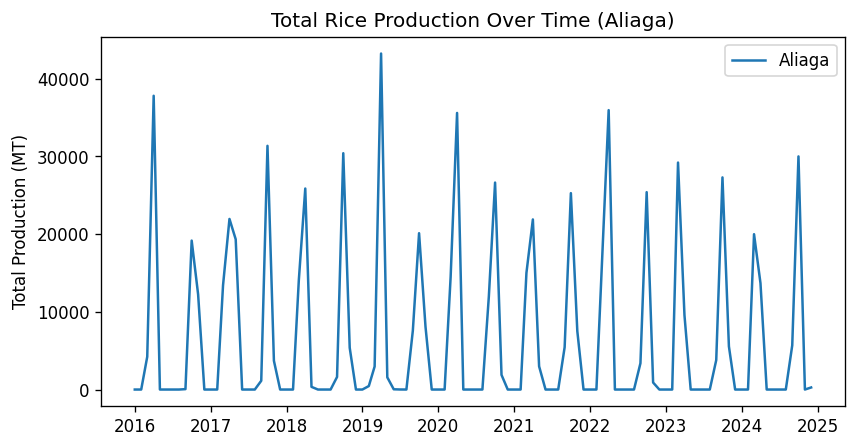

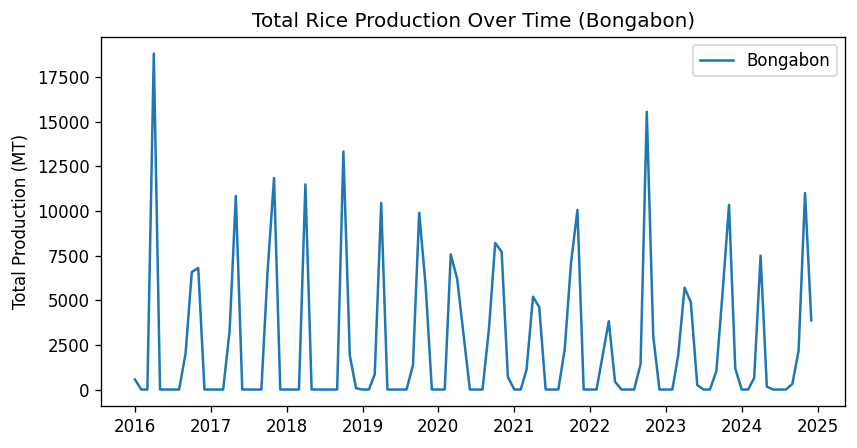

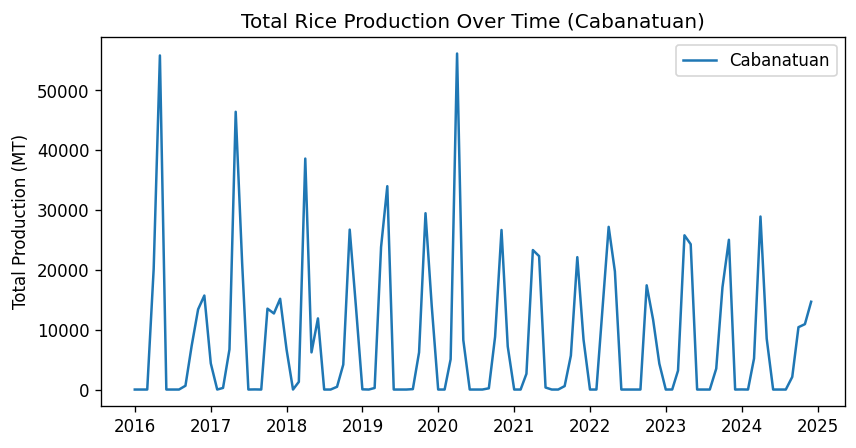

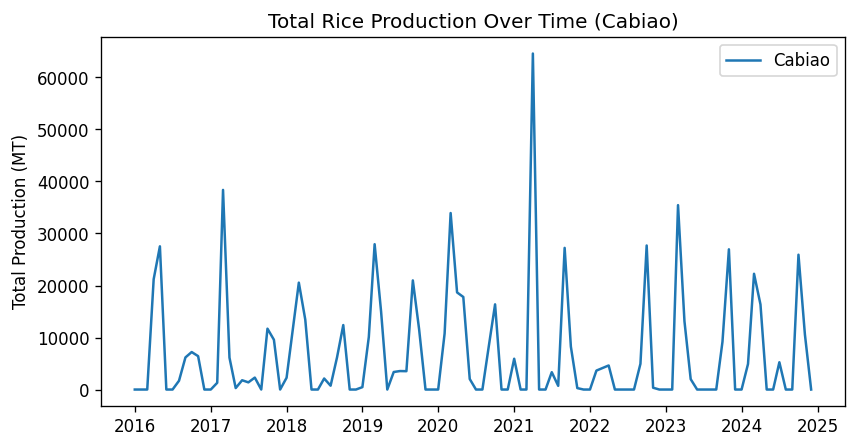

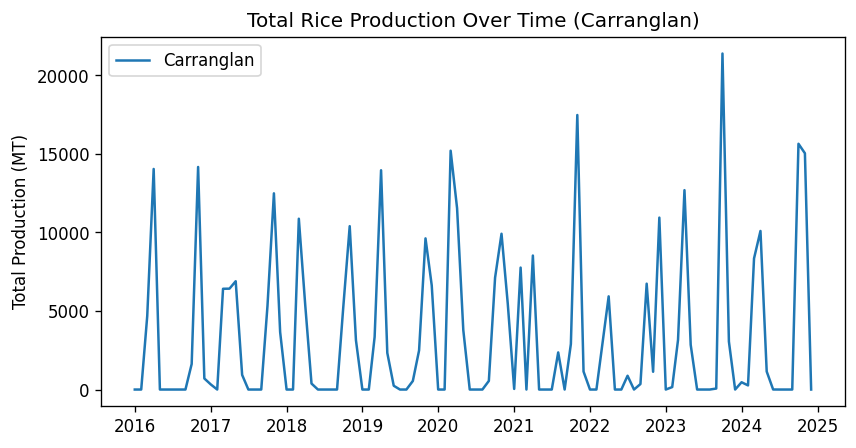

...

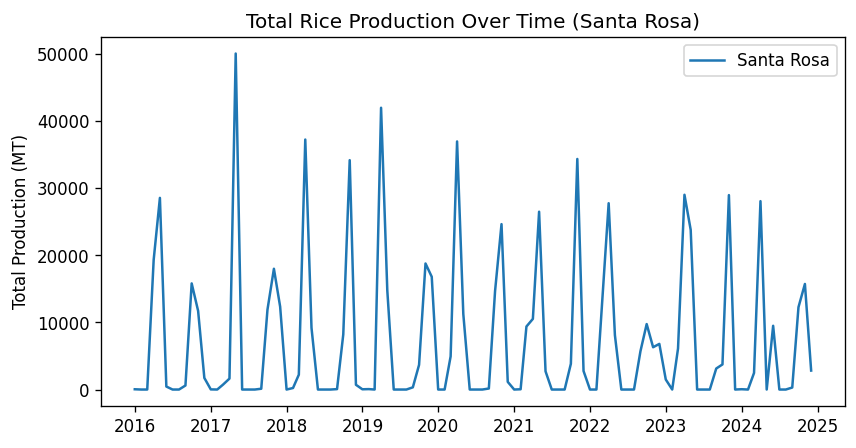

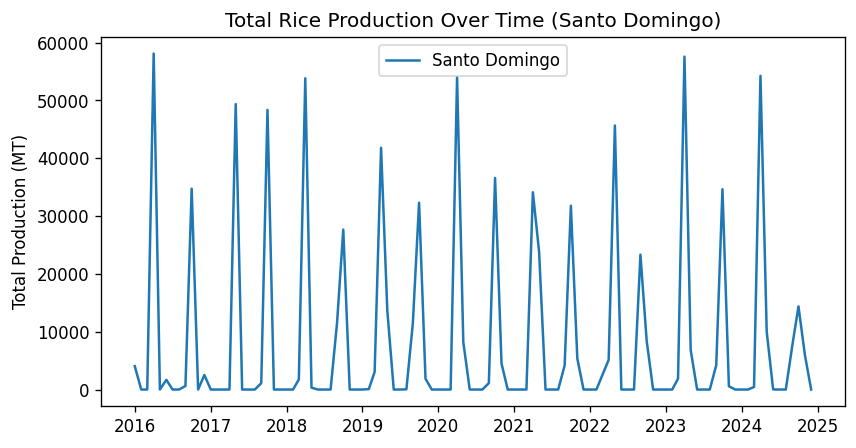

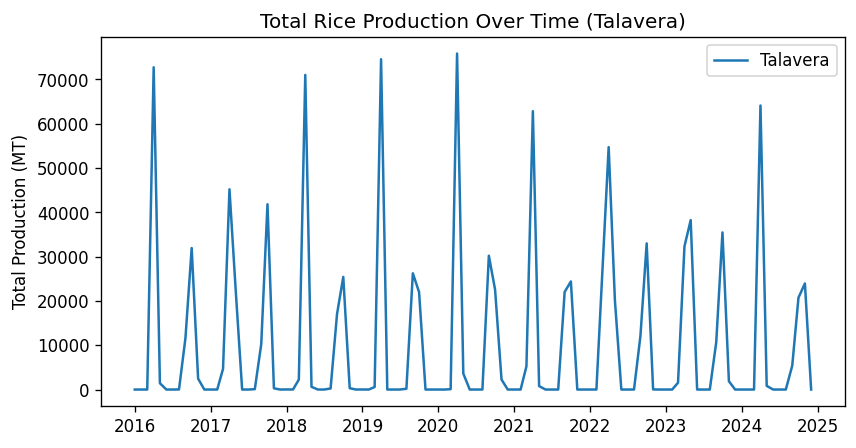

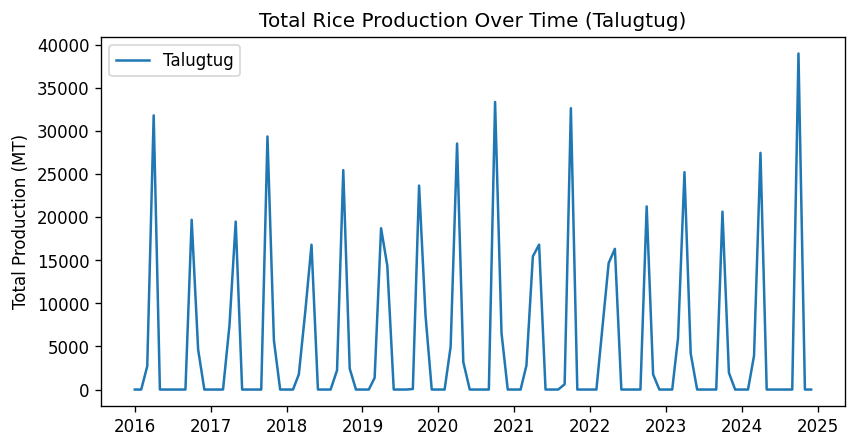

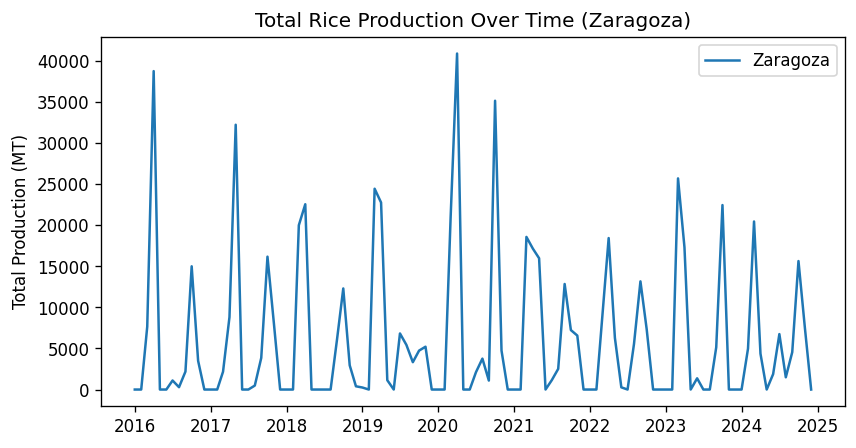

In [13]:
# Visualizing the Time Series
import matplotlib.pyplot as plt

for location in df_production['Location'].unique():
    plt.figure(figsize=(8, 4))  # Create a new figure for each location
    subset = df_production[df_production['Location'] == location]
    plt.plot(subset['Date'], subset['total_production_mt'], label=location)
    plt.legend()
    plt.title(f'Total Rice Production Over Time ({location})')
    # plt.xlabel('Year')
    plt.ylabel('Total Production (MT)')
    plt.show()

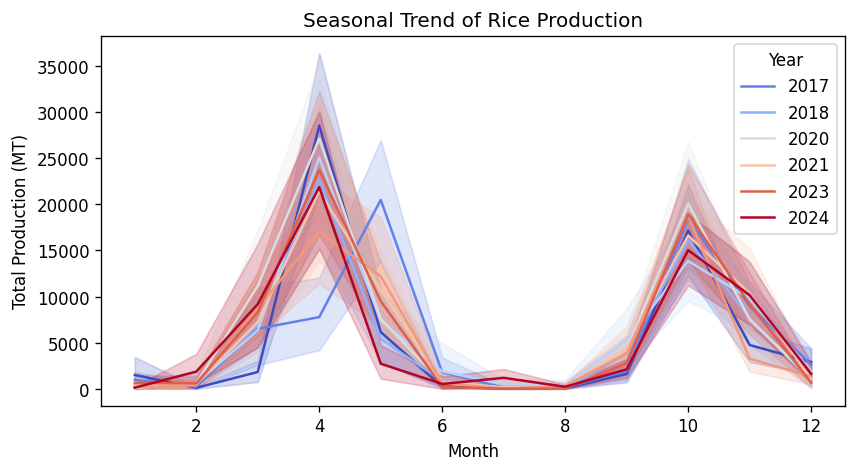

In [14]:
# Seasonal Plot
plt.figure(figsize=(8, 4))
sns.lineplot(data=df_production, x='Month', y='total_production_mt', hue='Year', palette='coolwarm')
plt.title('Seasonal Trend of Rice Production')
plt.xlabel('Month')
plt.ylabel('Total Production (MT)')
plt.show()

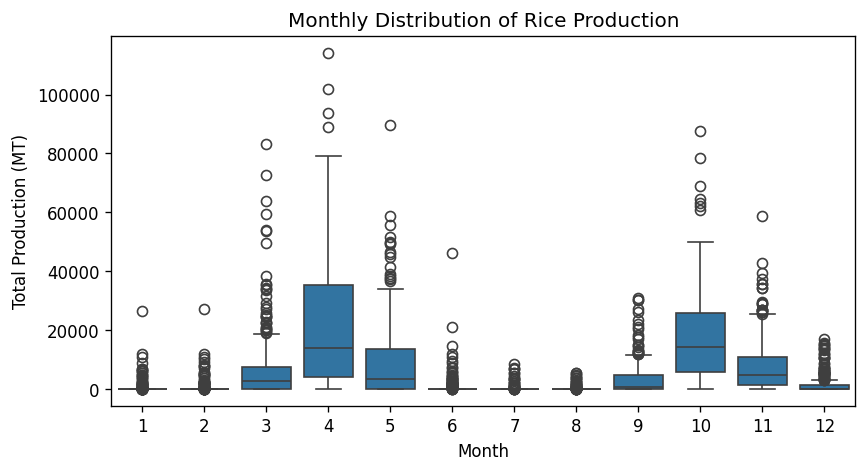

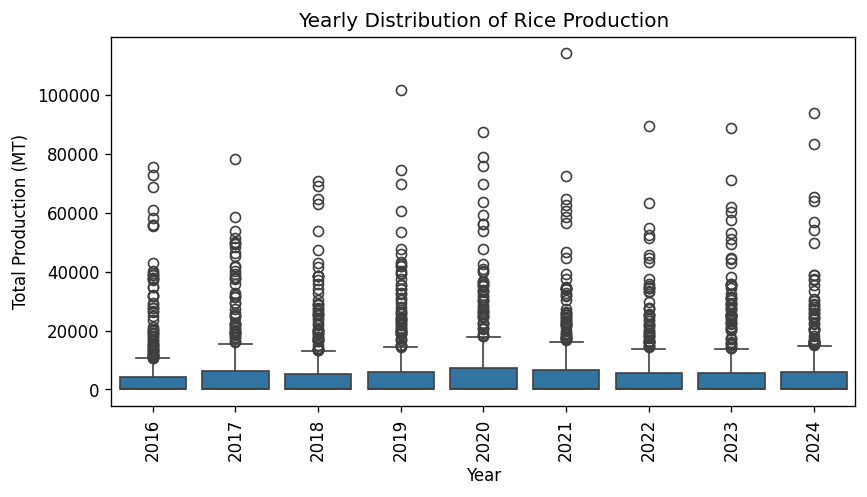

In [15]:
# Boxplot Analysis
plt.figure(figsize=(8, 4))
sns.boxplot(x='Month', y='total_production_mt', data=df_production)
plt.title('Monthly Distribution of Rice Production')
plt.xlabel('Month')
plt.ylabel('Total Production (MT)')
plt.show()

plt.figure(figsize=(8, 4))
sns.boxplot(x='Year', y='total_production_mt', data=df_production)
plt.title('Yearly Distribution of Rice Production')
plt.xticks(rotation=90)
plt.xlabel('Year')
plt.ylabel('Total Production (MT)')
plt.show()

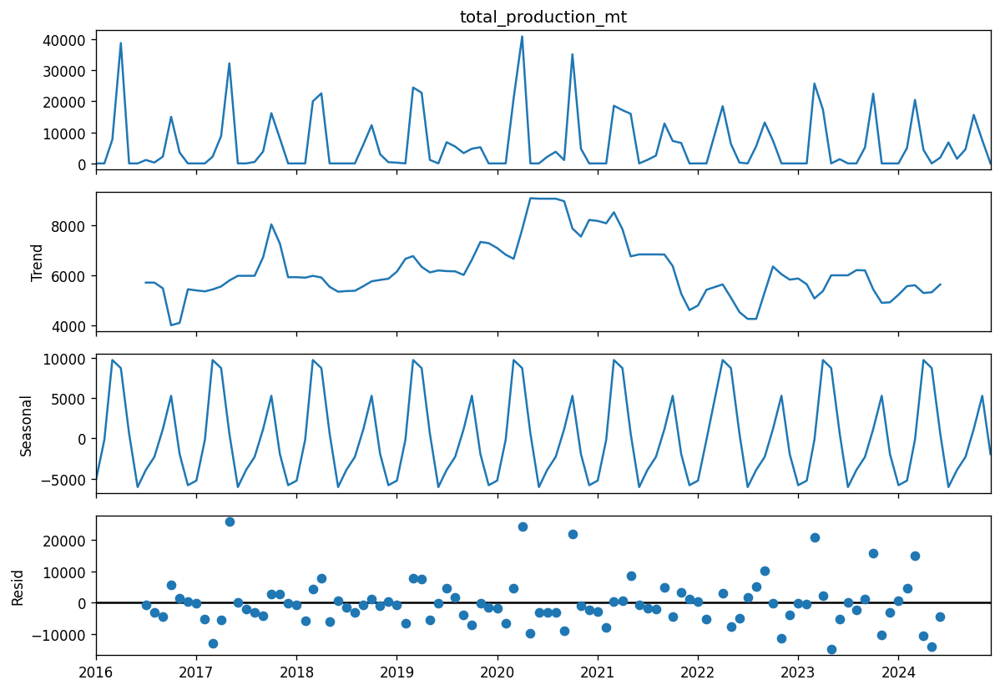

In [16]:
# Time Series Decomposition
df_sample = subset.set_index('Date')['total_production_mt']
decomposition = seasonal_decompose(df_sample, model='additive', period=12)
decomposition.plot()
plt.show()

In [17]:
# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 12
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape for LSTM
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

In [13]:
X_train.shape, X_test.shape

((2432, 12, 1), (608, 12, 1))

In [14]:
# Reshape X_train and X_test to ensure compatibility with LSTM
X_train = np.reshape(X_train, (X_train.shape[0], sequence_length, 1))
X_test = np.reshape(X_test, (X_test.shape[0], sequence_length, 1))

print("X_train shape:", X_train.shape)  # Should be (samples, 24, 1)
print("X_test shape:", X_test.shape)    # Should be (samples, 24, 1)

X_train shape: (2432, 12, 1)
X_test shape: (608, 12, 1)


# **LSTM Deep Learning Model**

### **model1_lstm**

In [ ]:
# model1_lstm
import os
import json
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Suppress Warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 12
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape for LSTM
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Define LSTM Model
model1_lstm = Sequential([
    LSTM(50, return_sequences=True, input_shape=(sequence_length, 1)),
    Dropout(0.2),
    LSTM(50, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

# Compile the model
model1_lstm.compile(optimizer='adam', loss='mse')

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-5)

# Train the model
history = model1_lstm.fit(
    X_train, y_train, epochs=50, batch_size=16,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

# Model Evaluation
y_pred = model1_lstm.predict(X_test)
y_pred_rescaled = np.zeros_like(y_pred)

for i, location in enumerate(location_test):
    y_pred_rescaled[i] = scalers[location].inverse_transform(y_pred[i].reshape(-1, 1))

y_test_rescaled = np.zeros_like(y_test)
for i, location in enumerate(location_test):
    y_test_rescaled[i] = scalers[location].inverse_transform(y_test[i].reshape(-1, 1))

mae = mean_absolute_error(y_test_rescaled, y_pred_rescaled)
mse = mean_squared_error(y_test_rescaled, y_pred_rescaled)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_rescaled, y_pred_rescaled)

print(f"Model Evaluation Metrics:")
print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R2 Score: {r2:.2f}")

/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 9s 13ms/step - loss: 0.0562 - val_loss: 0.0416 - learning_rate: 0.0010
Epoch 2/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - loss: 0.0445 - val_loss: 0.0399 - learning_rate: 0.0010
Epoch 3/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0427 - val_loss: 0.0396 - learning_rate: 0.0010
Epoch 4/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - loss: 0.0412 - val_loss: 0.0387 - learning_rate: 0.0010
Epoch 5/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - loss: 0.0414 - val_loss: 0.0401 - learning_rate: 0.0010
Epoch 6/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0405 - val_loss: 0.0365 - learning_rate: 0.0010
Epoch 7/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0387 - val_loss: 0.0332 - learning_rate: 0.0010
Epoch 8/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 0.0364 - val_loss: 0.0339 - learning_rate: 0.0010
Epoch 9/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0365 - val_loss: 0.0351 - learning_rate: 0.0010
Epoch 1

In [35]:
# Print this in a table name model name: model1_lstm. Make it 1 row for everything

from IPython.display import HTML, display

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

df = pd.DataFrame(data1)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"


In [ ]:
# Forecast Next 6 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(6):
        predicted_value = model1_lstm.predict(input_sequence)
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: -98.74 MT
Month 2: 2898.96 MT
Month 3: 16690.46 MT
Month 4: 13499.21 MT
Month 5: 1224.67 MT
Month 6: -207.95 MT

Predicted Rice Production for Bongabon:
Month 1: 221.11 MT
Month 2: 381.73 MT
Month 3: 1945.39 MT
Month 4: 5988.57 MT
Month 5: 5402.39 MT
Month 6: 797.46 MT

Predicted Rice Production for Cabanatuan:
Month 1: 445.55 MT
Month 2: 565.46 MT
Month 3: 6522.15 MT
Month 4: 17735.77 MT
Month 5: 13240.75 MT
Month 6: 3122.48 MT

Predicted Rice Production for Cabiao:
Month 1: 415.39 MT
Month 2: 5237.73 MT
Month 3: 17038.69 MT
Month 4: 17440.35 MT
Month 5: 5950.54 MT
Month 6: 783.88 MT

Predicted Rice Production for Carranglan:
Month 1: 491.64 MT
Month 2: 1292.90 MT
Month 3: 6149.65 MT
Month 4: 6452.25 MT
Month 5: 1773.71 MT
Month 6: 48.61 MT

Predicted Rice Production for Cuyapo:
Month 1: 467.61 MT
Month 2: 1086.42 MT
Month 3: 9473.36 MT
Month 4: 17719.00 MT
Month 5: 10263.68 MT
Month 6: 451.49 MT

Predicted Rice Production for Gabaldon:


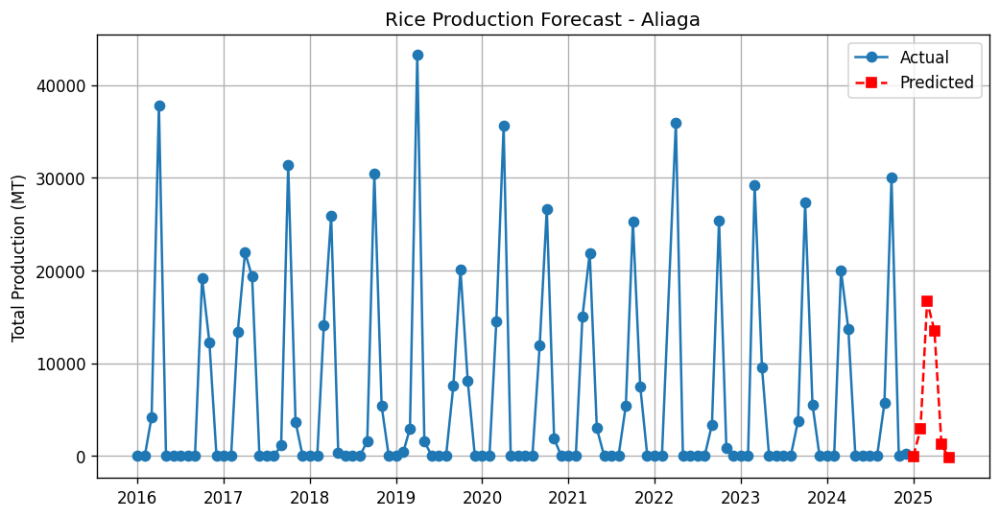

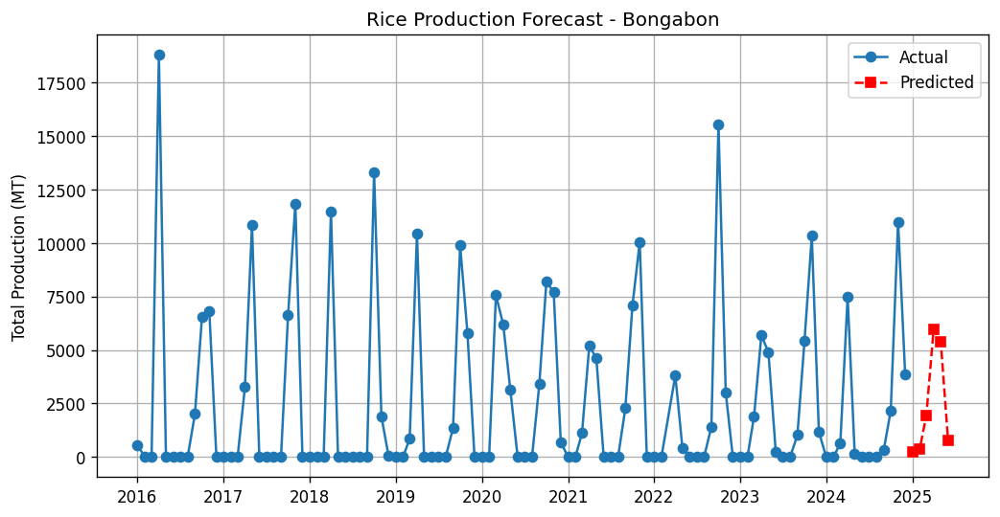

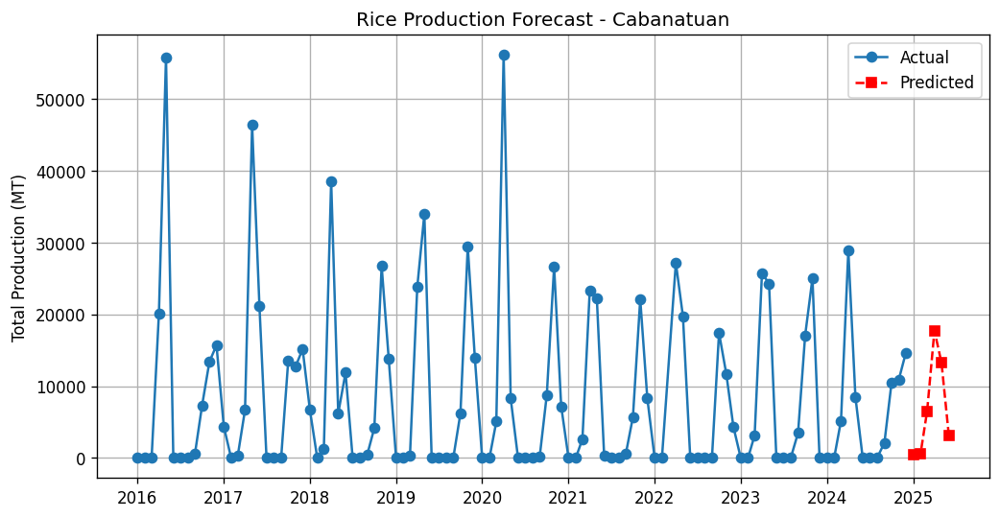

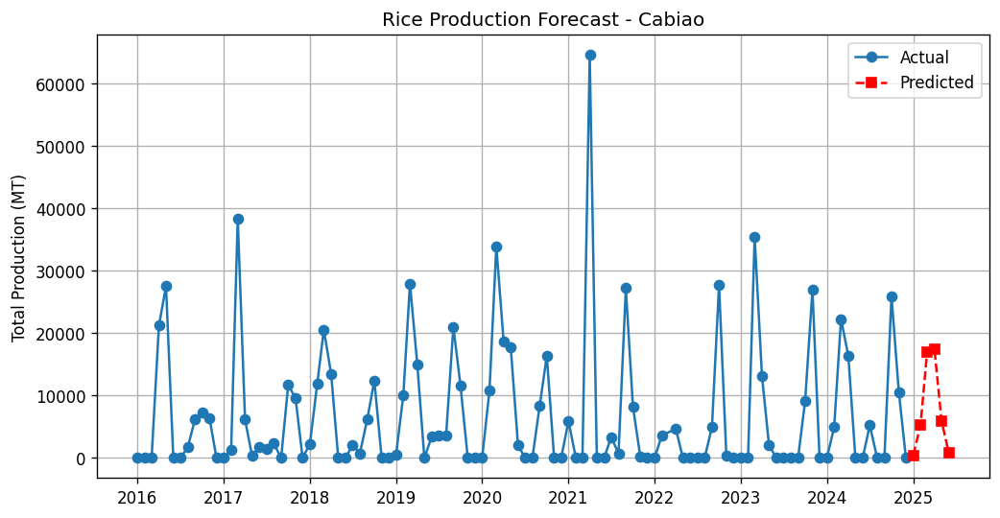

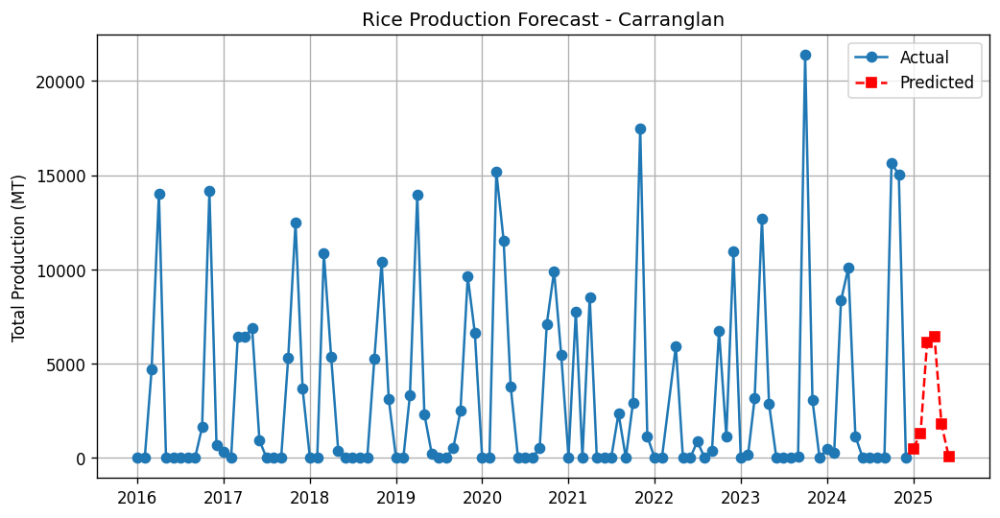

...

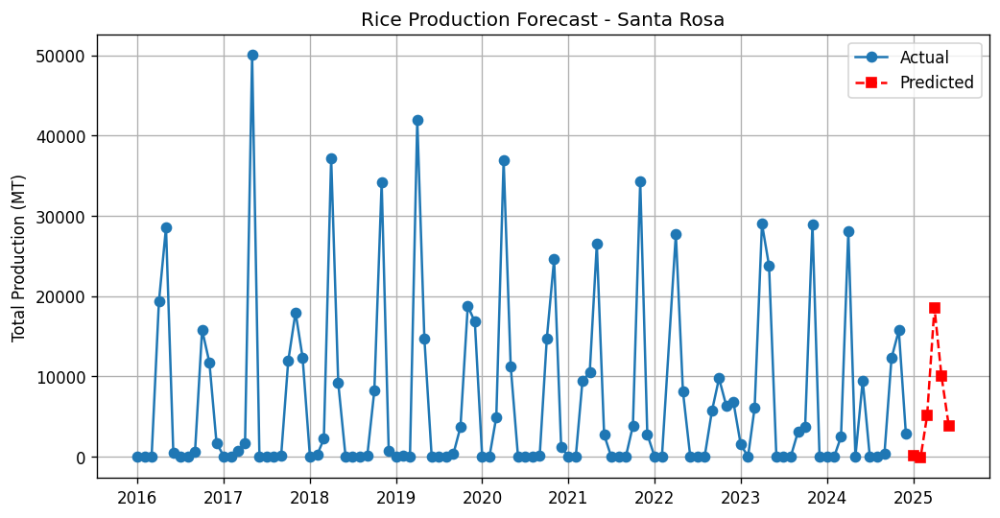

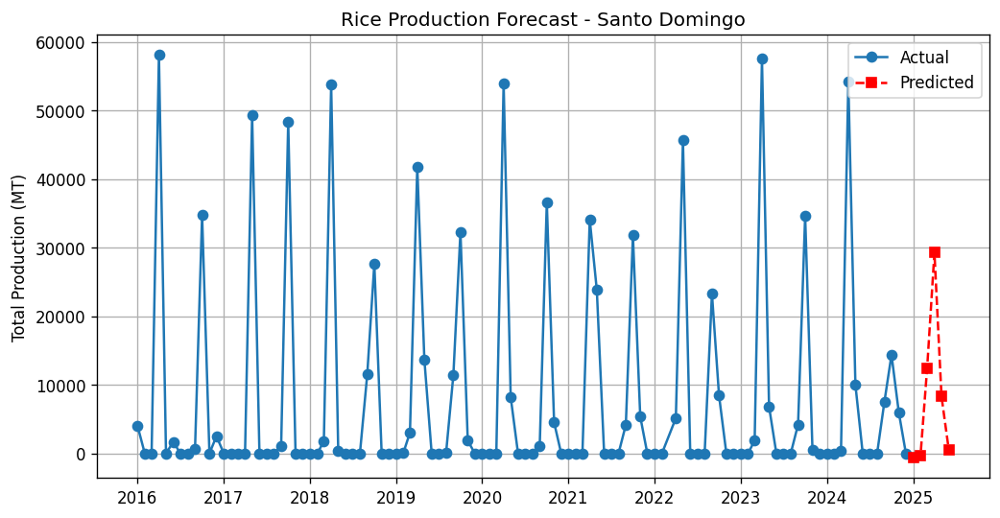

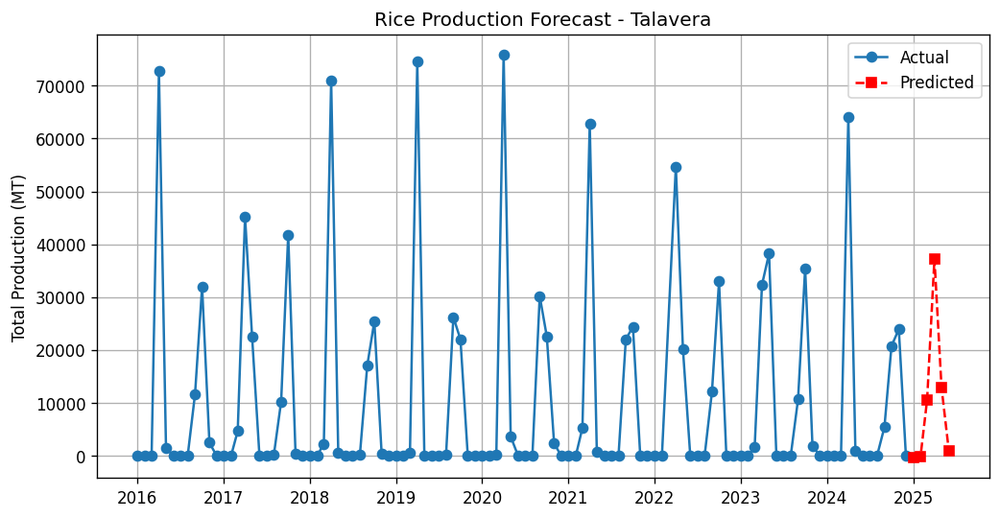

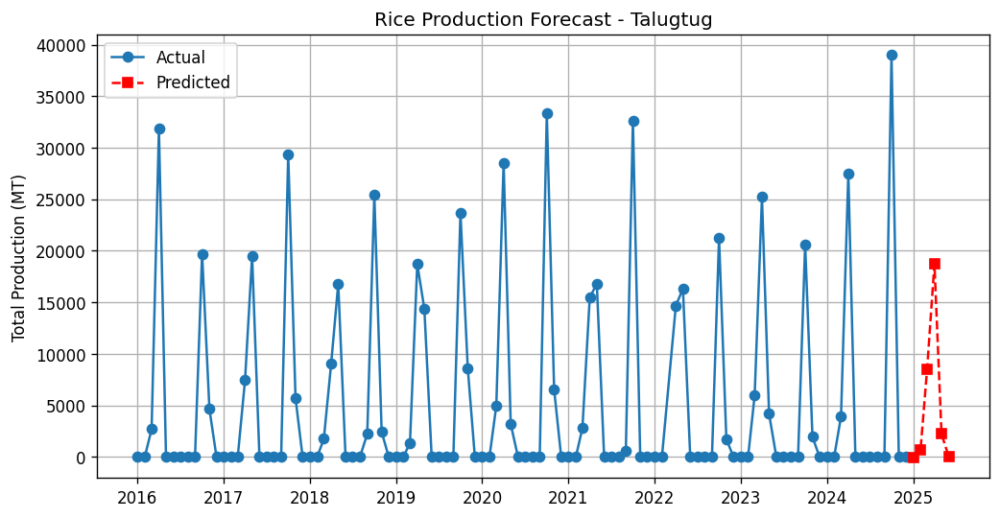

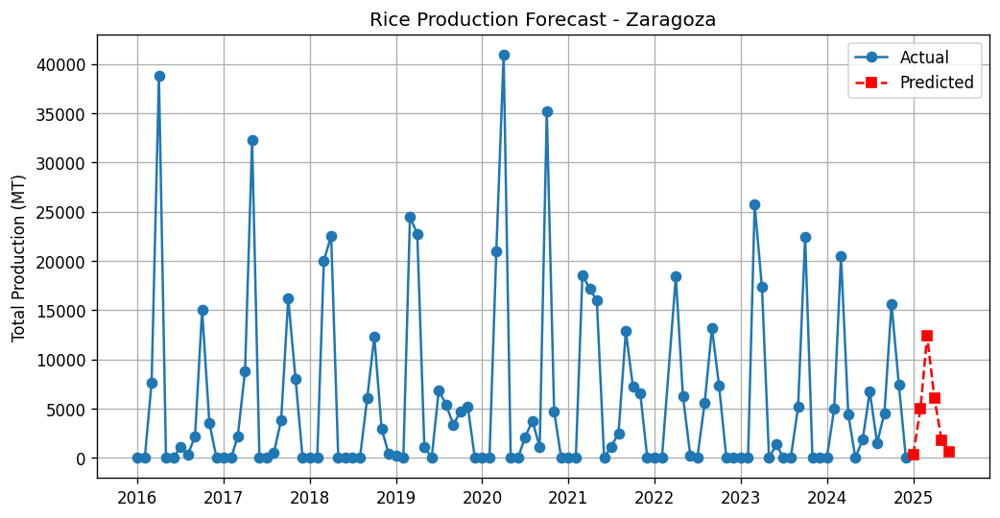

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=7, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model2_lstm**

In [ ]:
# model2_lstm
import os
import json
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Suppress Warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 12
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape for LSTM
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Define LSTM Model
model2_lstm = Sequential([
    LSTM(50, return_sequences=True, input_shape=(sequence_length, 1)),
    Dropout(0.2),
    LSTM(50, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

# Compile the model
model2_lstm.compile(optimizer='adam', loss='mse')

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-5)

# Train the model
history = model2_lstm.fit(
    X_train, y_train, epochs=50, batch_size=16,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

# Model Evaluation
y_pred = model2_lstm.predict(X_test)
y_pred_rescaled = np.zeros_like(y_pred)

for i, location in enumerate(location_test):
    y_pred_rescaled[i] = scalers[location].inverse_transform(y_pred[i].reshape(-1, 1))

y_test_rescaled = np.zeros_like(y_test)
for i, location in enumerate(location_test):
    y_test_rescaled[i] = scalers[location].inverse_transform(y_test[i].reshape(-1, 1))

mae = mean_absolute_error(y_test_rescaled, y_pred_rescaled)
mse = mean_squared_error(y_test_rescaled, y_pred_rescaled)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_rescaled, y_pred_rescaled)

print(f"Model Evaluation Metrics:")
print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R2 Score: {r2:.2f}")

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


152/152 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 0.0539 - val_loss: 0.0415 - learning_rate: 0.0010
Epoch 2/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0453 - val_loss: 0.0390 - learning_rate: 0.0010
Epoch 3/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0425 - val_loss: 0.0375 - learning_rate: 0.0010
Epoch 4/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0431 - val_loss: 0.0416 - learning_rate: 0.0010
Epoch 5/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0424 - val_loss: 0.0417 - learning_rate: 0.0010
Epoch 6/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0408 - val_loss: 0.0373 - learning_rate: 0.0010
Epoch 7/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0399 - val_loss: 0.0348 - learning_rate: 0.0010
Epoch 8/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0357 - val_loss: 0.0366 - learning_rate: 0.0010
Epoch 9/50
152/152 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0426 - val_loss: 0.0336 - learning_rate: 0.0010
Epoch 10/50
152/152 ━

In [33]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)

df = pd.concat([df1, df2], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"
model2_lstm,4315.61,54436321.48,7378.10,0.65,"12 sequential length, predict next 12 months"


In [ ]:
# Forecast Next 6 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = model2_lstm.predict(input_sequence)
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: 416.55 MT
Month 2: 2731.15 MT
Month 3: 16832.78 MT
Month 4: 13088.45 MT
Month 5: 830.64 MT
Month 6: -118.22 MT
Month 7: 98.75 MT
Month 8: 1326.42 MT
Month 9: 12430.85 MT
Month 10: 18593.41 MT
Month 11: 728.57 MT
Month 12: 31.71 MT

Predicted Rice Production for Bongabon:
Month 1: 310.43 MT
Month 2: 471.27 MT
Month 3: 1929.74 MT
Month 4: 5817.93 MT
Month 5: 4708.67 MT
Month 6: 740.13 MT
Month 7: -117.11 MT
Month 8: -87.61 MT
Month 9: 514.22 MT
Month 10: 5196.16 MT
Month 11: 8260.99 MT
Month 12: 1653.29 MT

Predicted Rice Production for Cabanatuan:
Month 1: 314.49 MT
Month 2: 755.89 MT
Month 3: 7347.41 MT
Month 4: 17933.10 MT
Month 5: 12202.10 MT
Month 6: 2331.11 MT
Month 7: -61.55 MT
Month 8: -122.27 MT
Month 9: 2628.34 MT
Month 10: 14312.01 MT
Month 11: 17241.58 MT
Month 12: 6928.01 MT

Predicted Rice Production for Cabiao:
Month 1: 794.70 MT
Month 2: 6361.80 MT
Month 3: 17998.08 MT
Month 4: 16793.18 MT
Month 5: 4720.65 MT
Month 6: 461.56

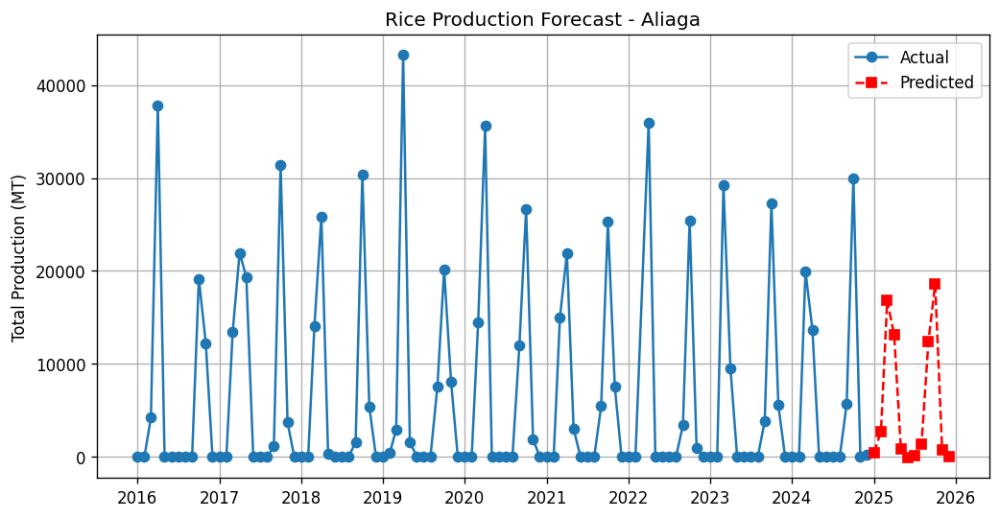

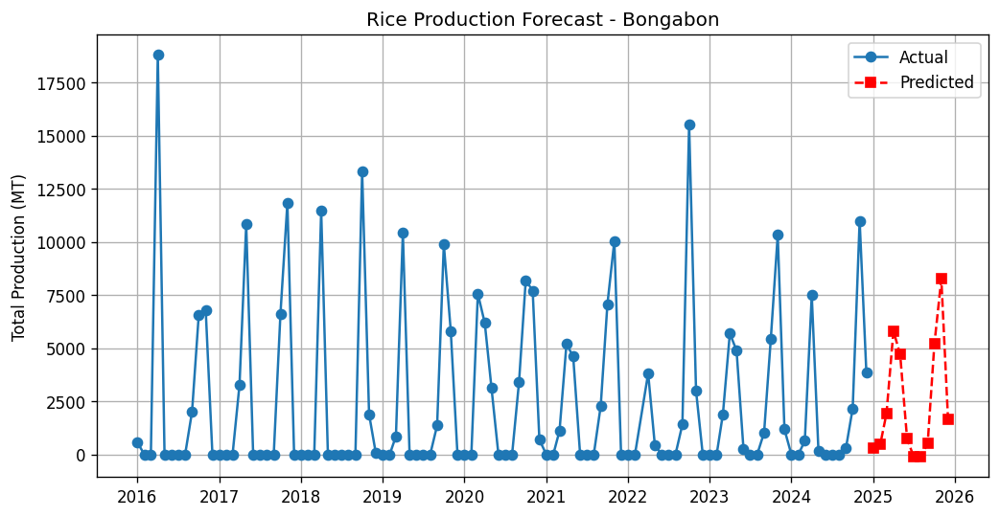

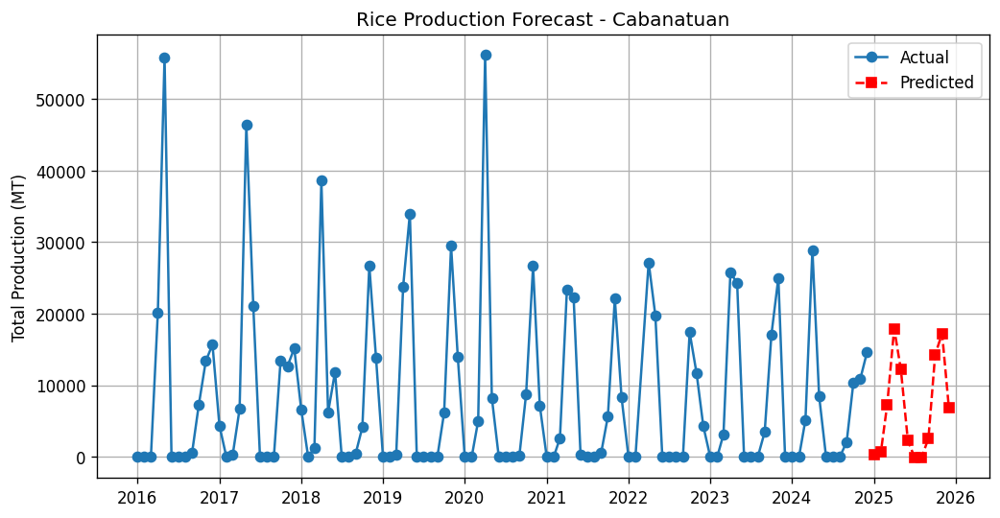

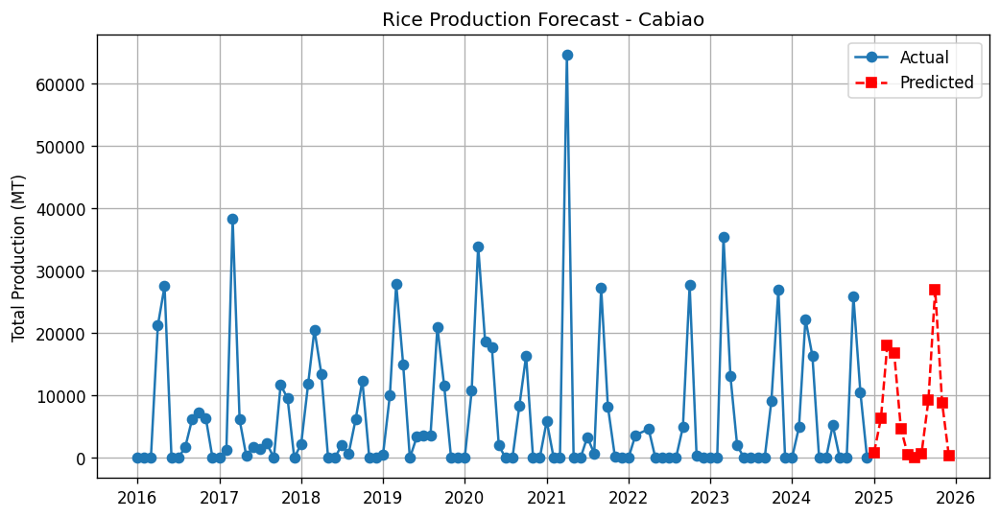

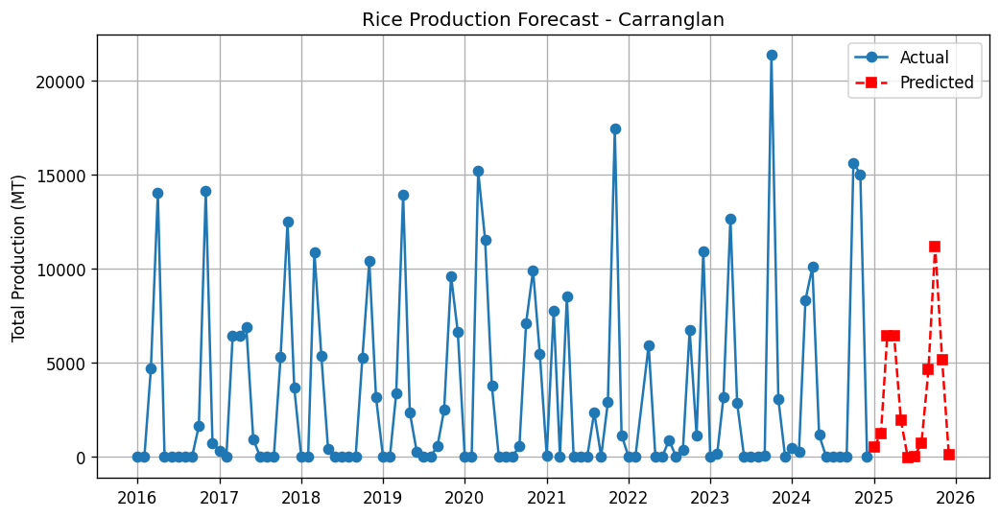

...

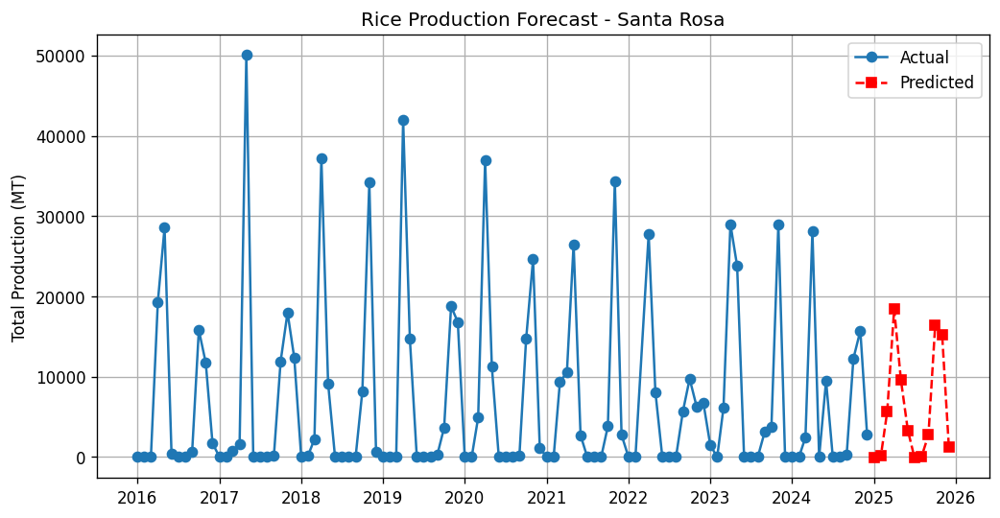

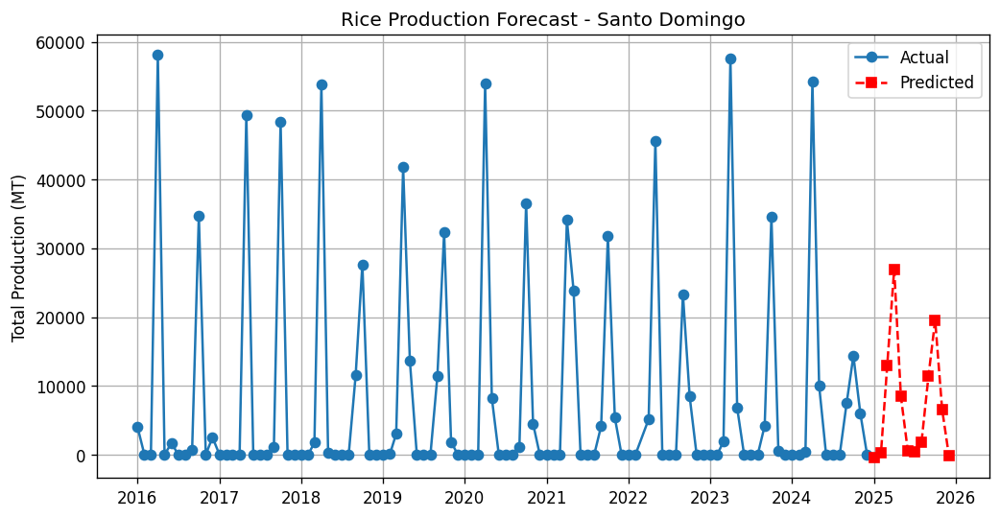

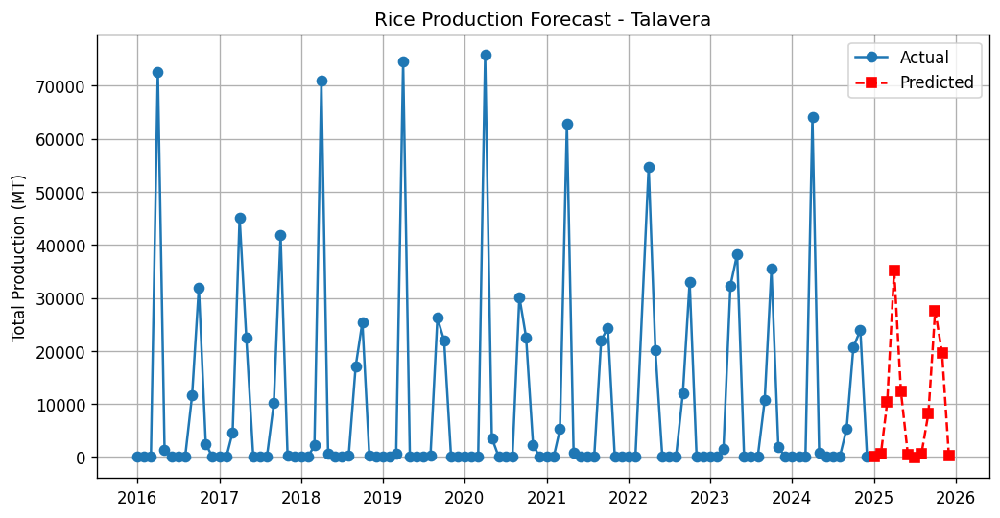

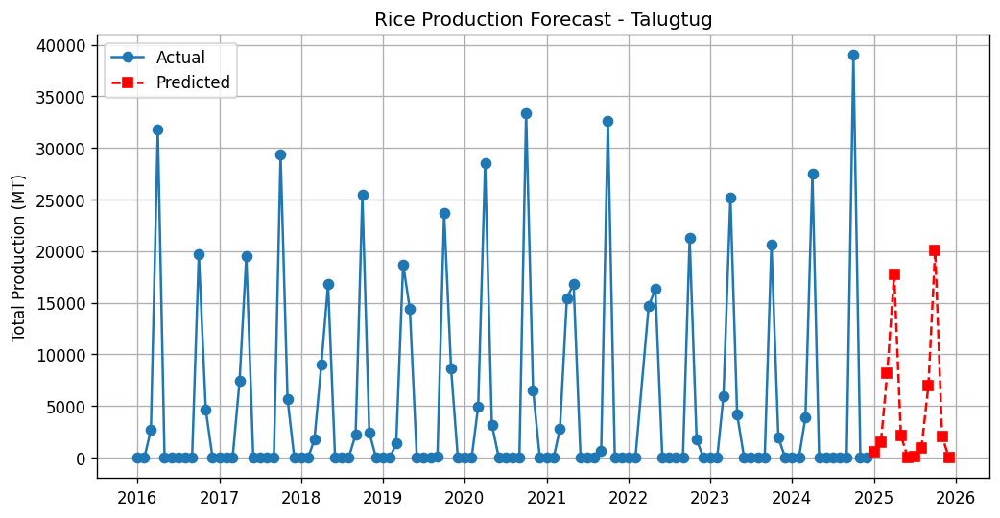

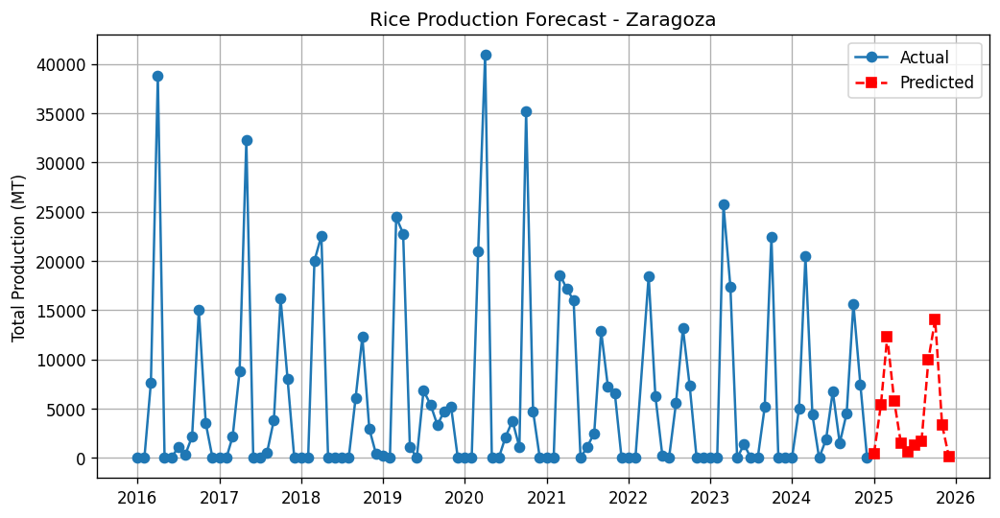

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model3_lstm**

In [ ]:
# model3_lstm
import os
import json
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Suppress Warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 24
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape for LSTM
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Define LSTM Model
model3_lstm = Sequential([
    LSTM(50, return_sequences=True, input_shape=(sequence_length, 1)),
    Dropout(0.2),
    LSTM(50, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

# Compile the model
model3_lstm.compile(optimizer='adam', loss='mse')

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-5)

# Train the model
history = model3_lstm.fit(
    X_train, y_train, epochs=50, batch_size=16,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

# Model Evaluation
y_pred = model3_lstm.predict(X_test)
y_pred_rescaled = np.zeros_like(y_pred)

for i, location in enumerate(location_test):
    y_pred_rescaled[i] = scalers[location].inverse_transform(y_pred[i].reshape(-1, 1))

y_test_rescaled = np.zeros_like(y_test)
for i, location in enumerate(location_test):
    y_test_rescaled[i] = scalers[location].inverse_transform(y_test[i].reshape(-1, 1))

mae = mean_absolute_error(y_test_rescaled, y_pred_rescaled)
mse = mean_squared_error(y_test_rescaled, y_pred_rescaled)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_rescaled, y_pred_rescaled)

print(f"Model Evaluation Metrics:")
print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R2 Score: {r2:.2f}")

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


133/133 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - loss: 0.0595 - val_loss: 0.0462 - learning_rate: 0.0010
Epoch 2/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0497 - val_loss: 0.0436 - learning_rate: 0.0010
Epoch 3/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0456 - val_loss: 0.0396 - learning_rate: 0.0010
Epoch 4/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0446 - val_loss: 0.0397 - learning_rate: 0.0010
Epoch 5/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0477 - val_loss: 0.0372 - learning_rate: 0.0010
Epoch 6/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0424 - val_loss: 0.0390 - learning_rate: 0.0010
Epoch 7/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0437 - val_loss: 0.0366 - learning_rate: 0.0010
Epoch 8/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0426 - val_loss: 0.0401 - learning_rate: 0.0010
Epoch 9/50
133/133 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0422 - val_loss: 0.0363 - learning_rate: 0.0010
Epoch 10/50


In [32]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)

df = pd.concat([df1, df2, df3], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"
model2_lstm,4315.61,54436321.48,7378.10,0.65,"12 sequential length, predict next 12 months"
model3_lstm,4044.47,44104961.27,6641.16,0.71,"24 sequential length, predict next 12 months"


In [ ]:
# Forecast Next 6 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = model3_lstm.predict(input_sequence)
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: 303.97 MT
Month 2: 7064.65 MT
Month 3: 19521.51 MT
Month 4: 7422.04 MT
Month 5: 433.25 MT
Month 6: -40.93 MT
Month 7: -691.78 MT
Month 8: 1824.22 MT
Month 9: 13703.74 MT
Month 10: 20153.48 MT
Month 11: 726.44 MT
Month 12: 134.72 MT

Predicted Rice Production for Bongabon:
Month 1: 605.35 MT
Month 2: 617.02 MT
Month 3: 2715.27 MT
Month 4: 5238.87 MT
Month 5: 2341.55 MT
Month 6: 261.43 MT
Month 7: -84.93 MT
Month 8: -251.10 MT
Month 9: 1281.87 MT
Month 10: 6602.68 MT
Month 11: 8084.88 MT
Month 12: 802.62 MT

Predicted Rice Production for Cabanatuan:
Month 1: 294.84 MT
Month 2: 519.41 MT
Month 3: 8784.42 MT
Month 4: 23046.91 MT
Month 5: 9748.67 MT
Month 6: 773.55 MT
Month 7: 147.52 MT
Month 8: -387.36 MT
Month 9: 3944.90 MT
Month 10: 16652.31 MT
Month 11: 15961.15 MT
Month 12: 1477.53 MT

Predicted Rice Production for Cabiao:
Month 1: 1019.49 MT
Month 2: 6890.39 MT
Month 3: 24691.65 MT
Month 4: 15979.67 MT
Month 5: 2268.33 MT
Month 6: 1111.4

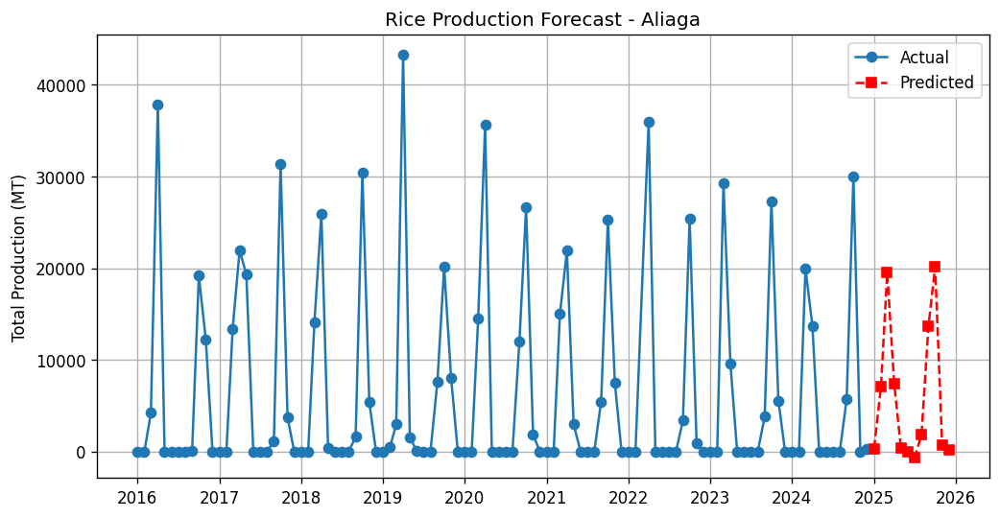

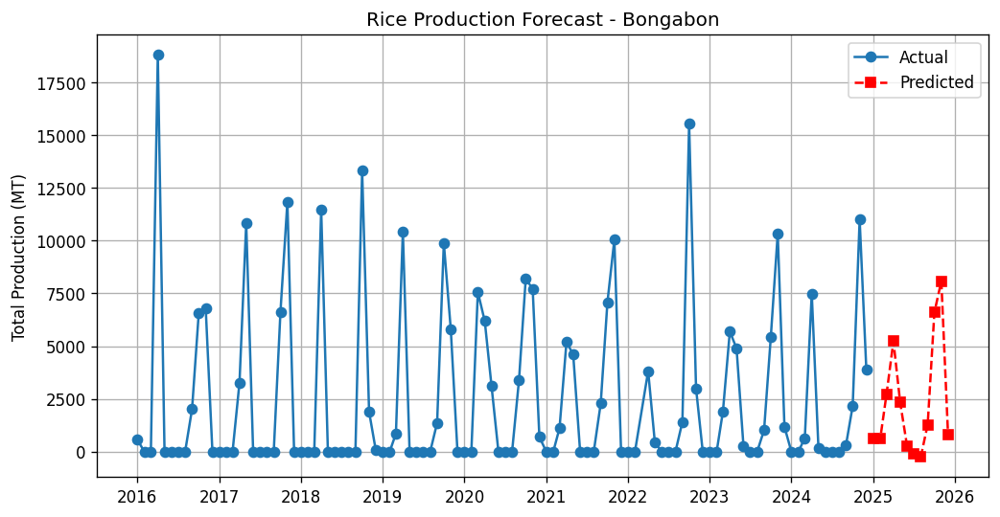

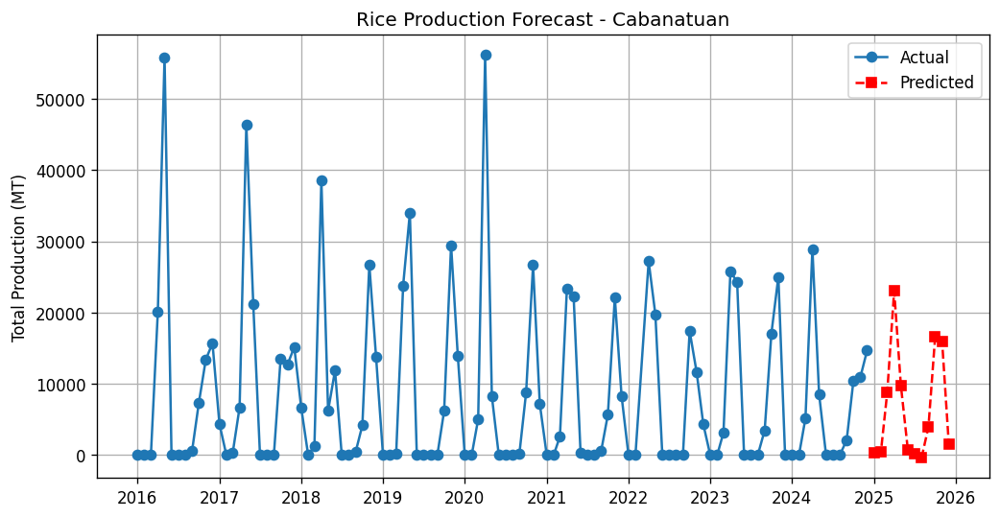

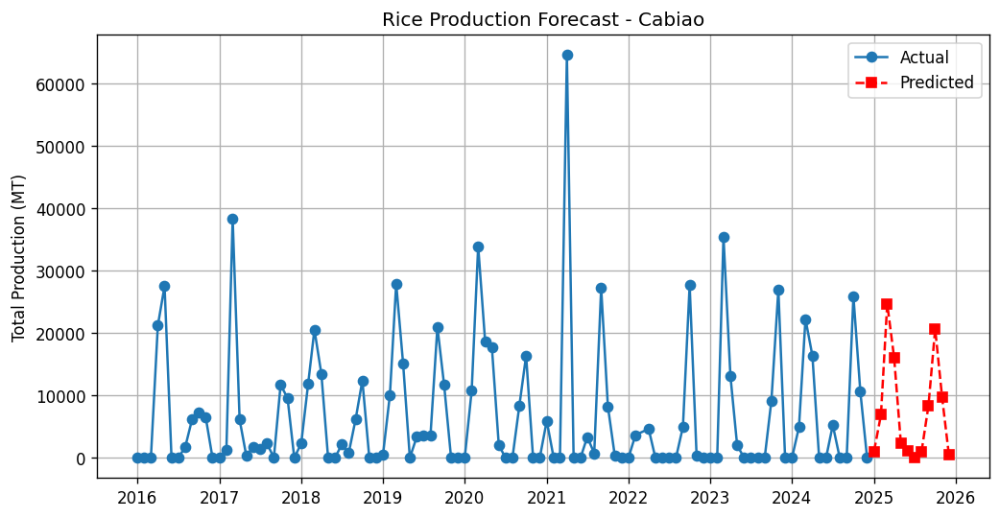

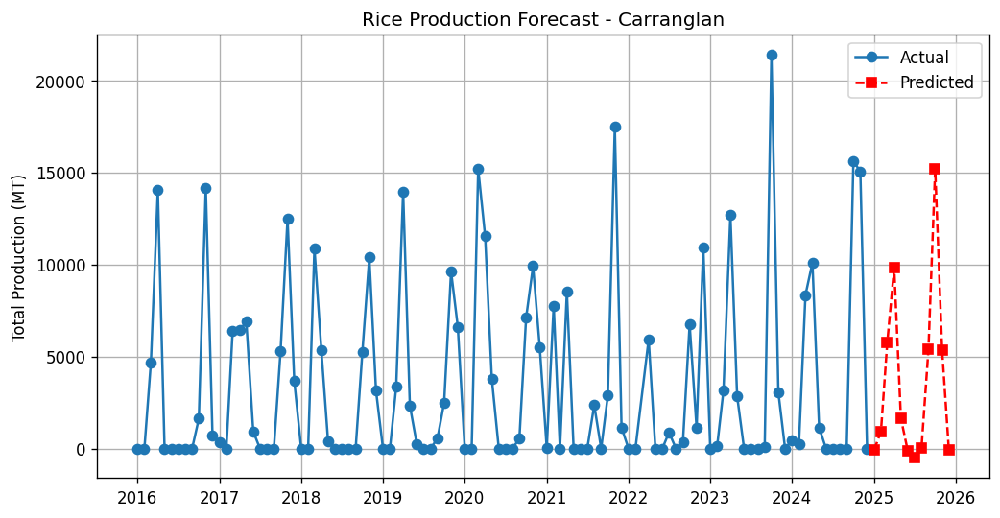

...

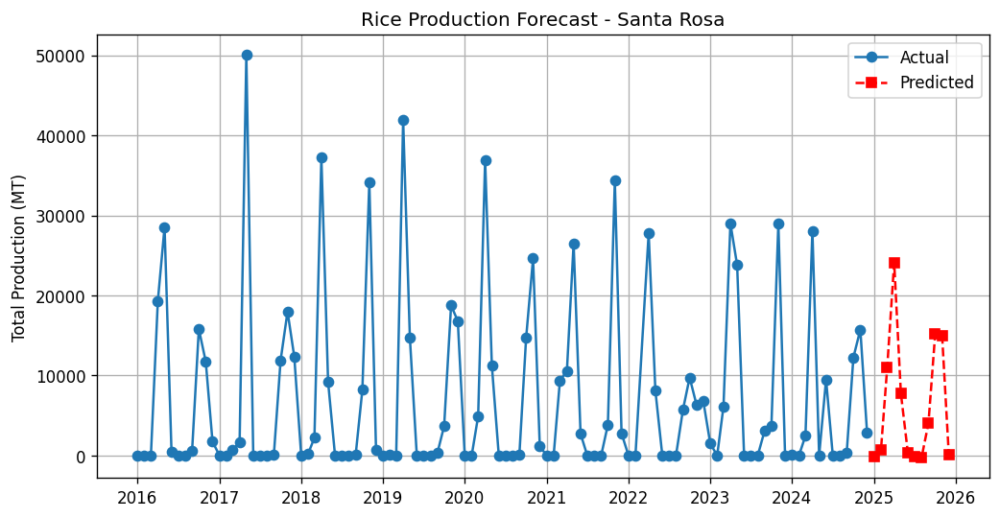

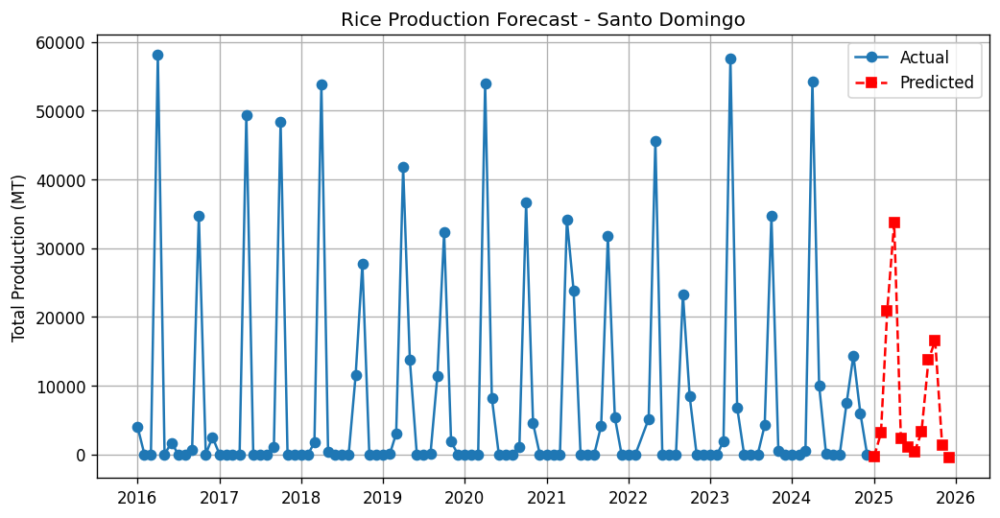

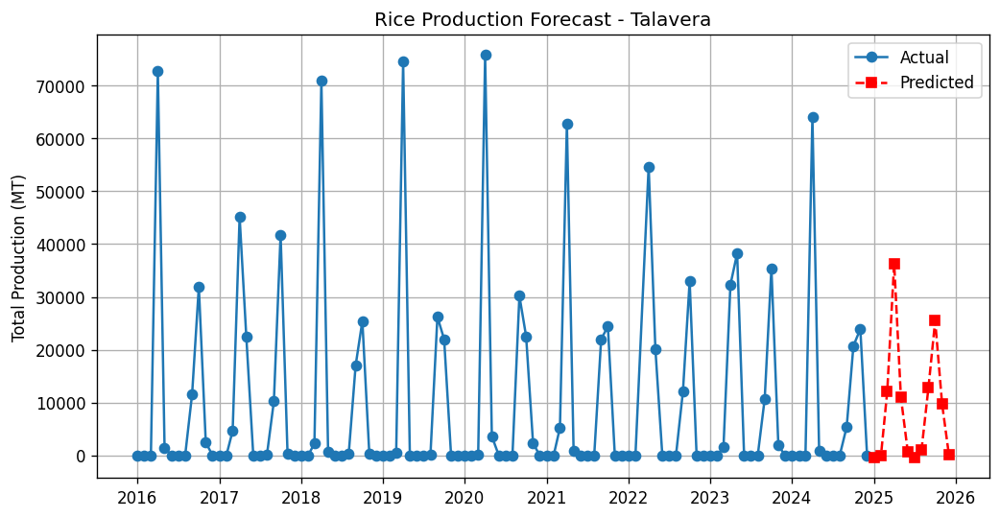

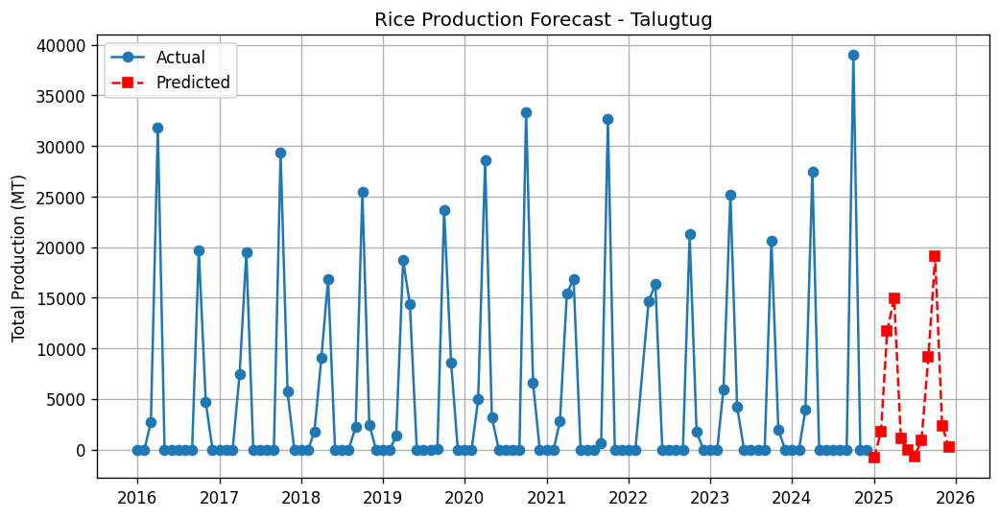

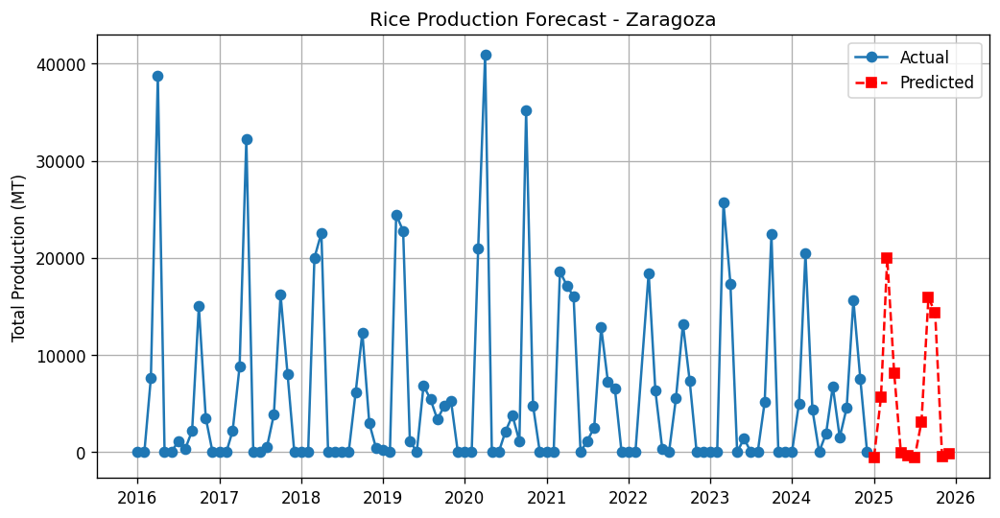

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model4_lstm**

In [ ]:
# model4_lstm
import os
import json
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Suppress Warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 36
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape for LSTM
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

# Define LSTM Model
model4_lstm = Sequential([
    LSTM(50, return_sequences=True, input_shape=(sequence_length, 1)),
    Dropout(0.2),
    LSTM(50, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

# Compile the model
model4_lstm.compile(optimizer='adam', loss='mse')

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.5, min_lr=1e-5)

# Train the model
history = model4_lstm.fit(
    X_train, y_train, epochs=50, batch_size=16,
    validation_data=(X_test, y_test),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

# Model Evaluation
y_pred = model4_lstm.predict(X_test)
y_pred_rescaled = np.zeros_like(y_pred)

for i, location in enumerate(location_test):
    y_pred_rescaled[i] = scalers[location].inverse_transform(y_pred[i].reshape(-1, 1))

y_test_rescaled = np.zeros_like(y_test)
for i, location in enumerate(location_test):
    y_test_rescaled[i] = scalers[location].inverse_transform(y_test[i].reshape(-1, 1))

mae = mean_absolute_error(y_test_rescaled, y_pred_rescaled)
mse = mean_squared_error(y_test_rescaled, y_pred_rescaled)
rmse = np.sqrt(mse)
r2 = r2_score(y_test_rescaled, y_pred_rescaled)

print(f"Model Evaluation Metrics:")
print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R2 Score: {r2:.2f}")

Epoch 1/50


/usr/local/lib/python3.11/dist-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


114/114 ━━━━━━━━━━━━━━━━━━━━ 5s 24ms/step - loss: 0.0599 - val_loss: 0.0501 - learning_rate: 0.0010
Epoch 2/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0562 - val_loss: 0.0436 - learning_rate: 0.0010
Epoch 3/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.0507 - val_loss: 0.0426 - learning_rate: 0.0010
Epoch 4/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0445 - val_loss: 0.0410 - learning_rate: 0.0010
Epoch 5/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0444 - val_loss: 0.0395 - learning_rate: 0.0010
Epoch 6/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0450 - val_loss: 0.0405 - learning_rate: 0.0010
Epoch 7/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0472 - val_loss: 0.0393 - learning_rate: 0.0010
Epoch 8/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0442 - val_loss: 0.0421 - learning_rate: 0.0010
Epoch 9/50
114/114 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - loss: 0.0468 - val_loss: 0.0390 - learning_rate: 0.0010
Epoch 10/50


In [31]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)

df = pd.concat([df1, df2, df3, df4], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"
model2_lstm,4315.61,54436321.48,7378.10,0.65,"12 sequential length, predict next 12 months"
model3_lstm,4044.47,44104961.27,6641.16,0.71,"24 sequential length, predict next 12 months"
model4_lstm,3934.89,41968954.69,6478.35,0.73,"36 sequential length, predict next 12 months"


In [ ]:
# Forecast Next 6 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = model4_lstm.predict(input_sequence)
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: 164.69 MT
Month 2: 3706.88 MT
Month 3: 16649.27 MT
Month 4: 14806.27 MT
Month 5: 25.33 MT
Month 6: 114.39 MT
Month 7: -622.02 MT
Month 8: 1467.39 MT
Month 9: 13268.37 MT
Month 10: 19097.92 MT
Month 11: 1994.28 MT
Month 12: 23.03 MT

Predicted Rice Production for Bongabon:
Month 1: 567.84 MT
Month 2: 762.30 MT
Month 3: 2285.22 MT
Month 4: 4576.36 MT
Month 5: 2517.20 MT
Month 6: 291.96 MT
Month 7: -145.19 MT
Month 8: -339.03 MT
Month 9: 2461.37 MT
Month 10: 10462.88 MT
Month 11: 5180.97 MT
Month 12: 353.45 MT

Predicted Rice Production for Cabanatuan:
Month 1: 672.99 MT
Month 2: 582.16 MT
Month 3: 6820.14 MT
Month 4: 23360.99 MT
Month 5: 10852.53 MT
Month 6: 736.49 MT
Month 7: 318.08 MT
Month 8: -489.64 MT
Month 9: 2859.25 MT
Month 10: 17946.68 MT
Month 11: 17959.74 MT
Month 12: 2471.88 MT

Predicted Rice Production for Cabiao:
Month 1: 980.33 MT
Month 2: 3679.79 MT
Month 3: 14506.93 MT
Month 4: 18875.45 MT
Month 5: 3261.86 MT
Month 6: 1218

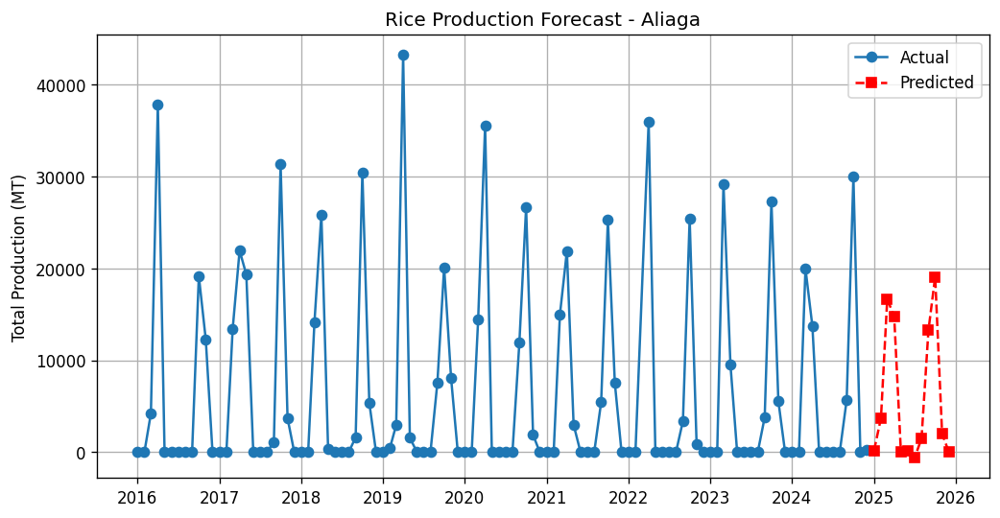

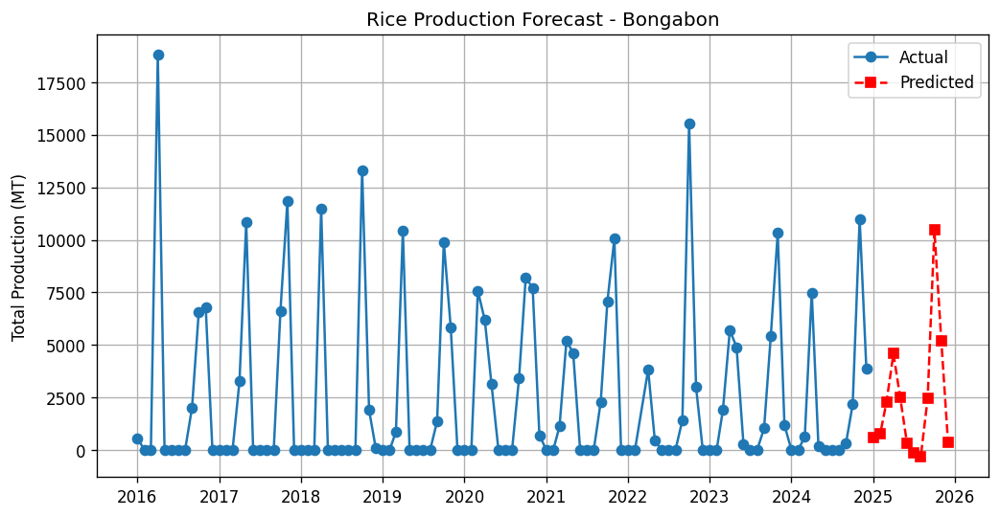

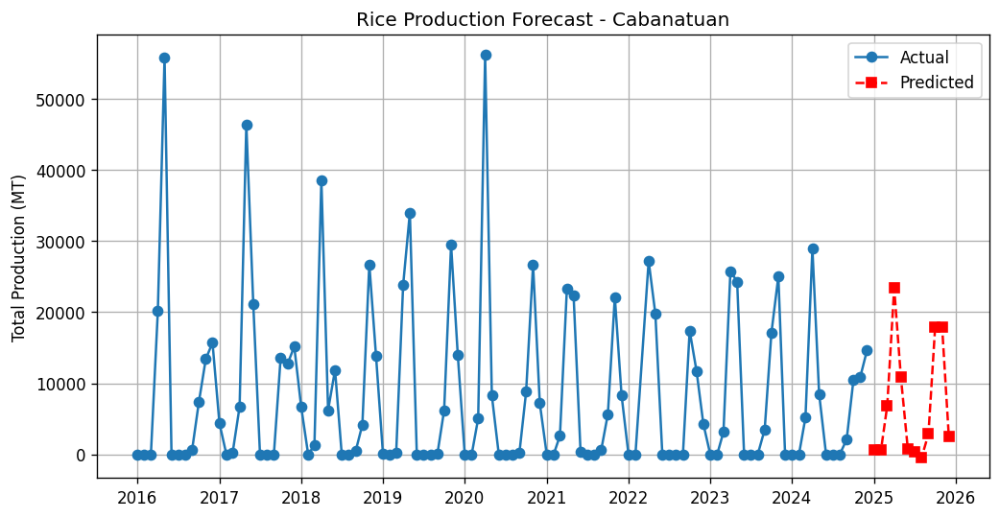

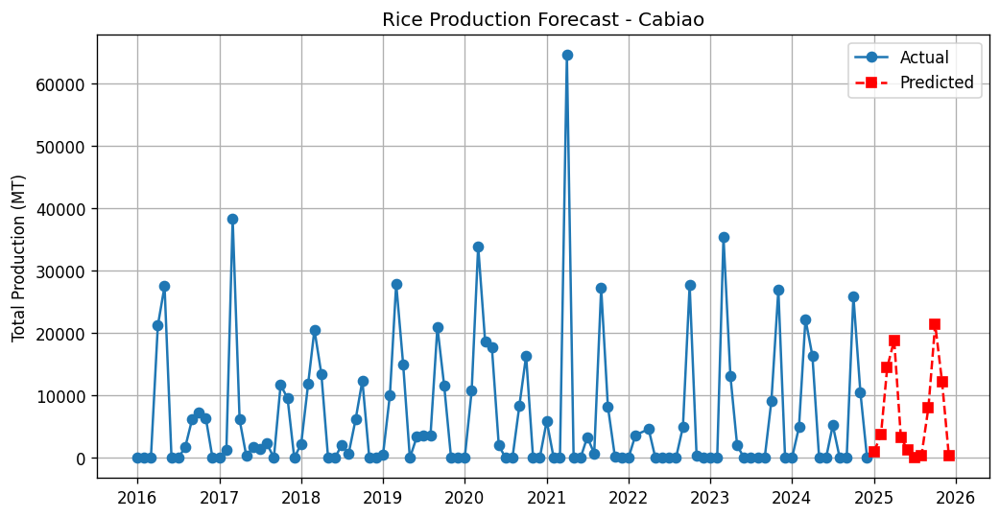

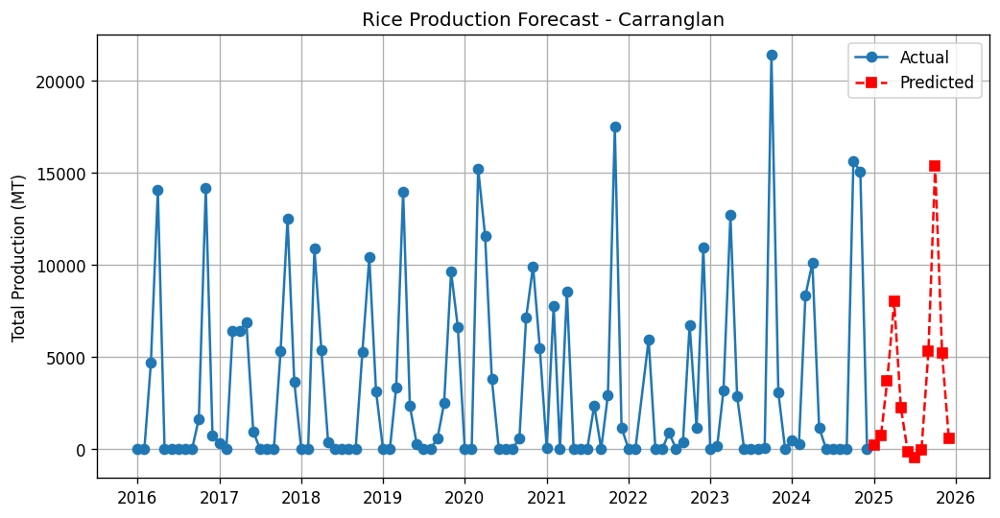

...

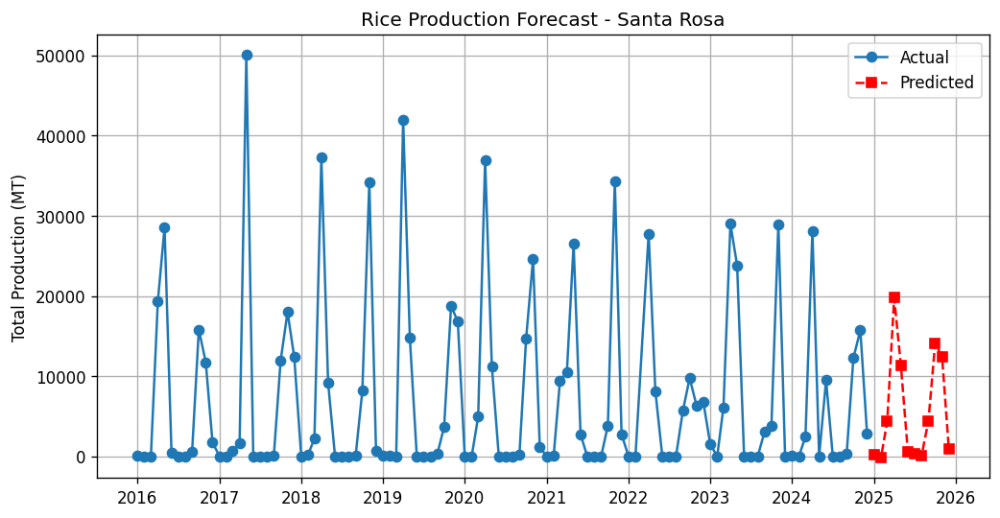

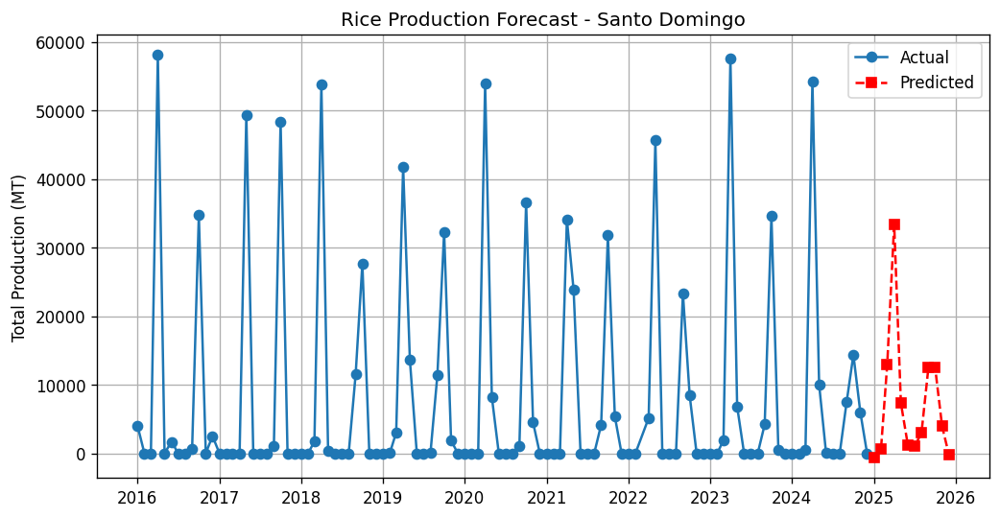

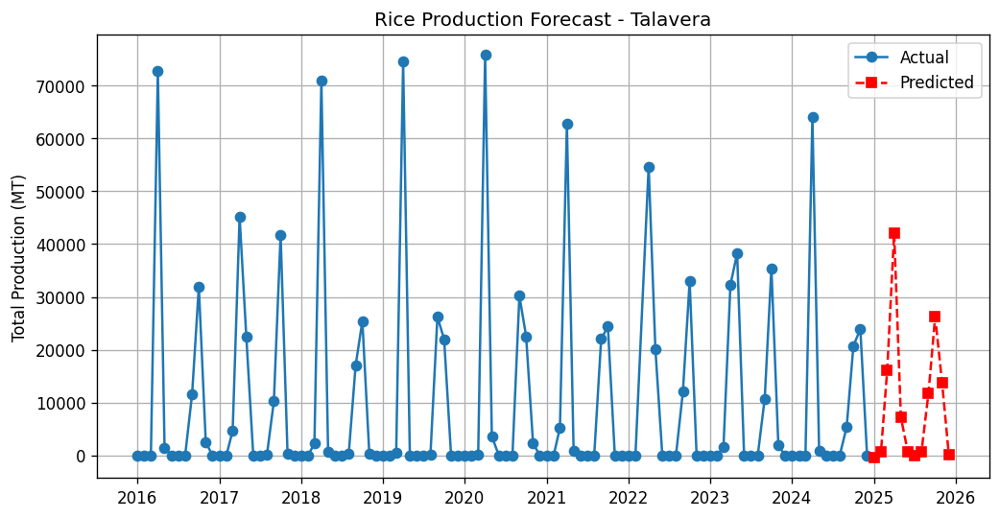

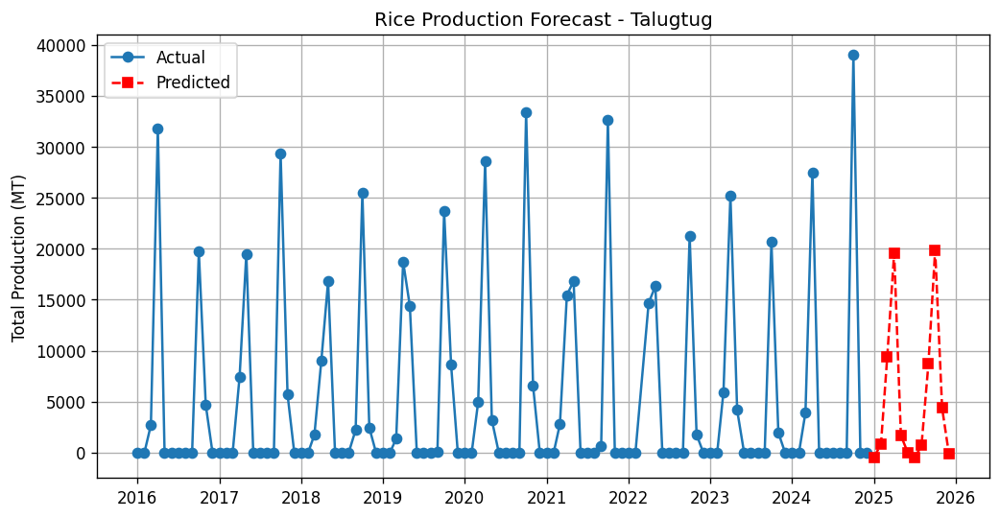

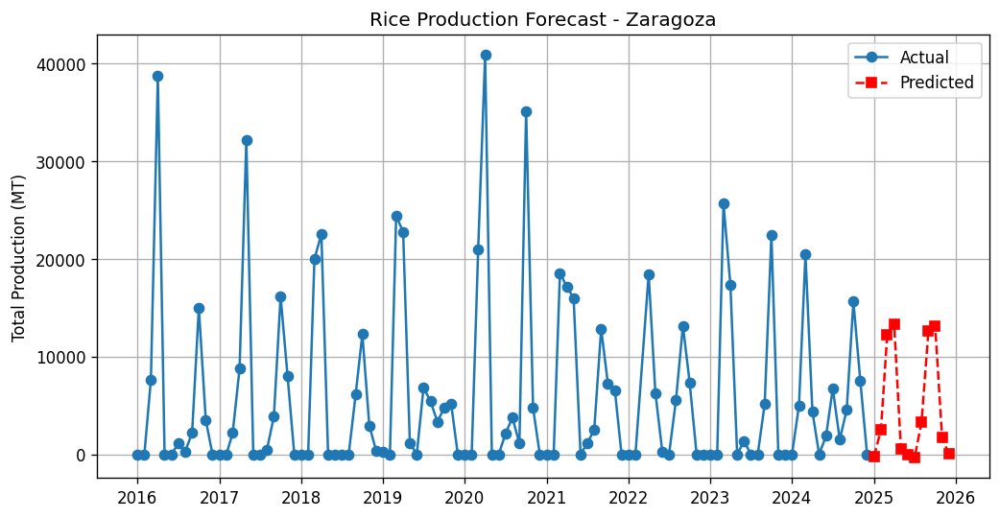

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model5_lstm_gridsearch**

In [ ]:
import shutil
import os

# Remove the previous tuning directory to force a fresh search
if os.path.exists("lstm_tuning"):
    shutil.rmtree("lstm_tuning")

In [ ]:
# model5_lstm_gridsearch
import numpy as np
import tensorflow as tf
import keras_tuner as kt
import json
import os

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Define lookback window size
sequence_length = 24

# Define Function to Create the LSTM Model with Hyperparameter Tuning
def build_model(hp):
    model5_lstm_gridsearch = Sequential()

    # First LSTM Layer
    model5_lstm_gridsearch.add(LSTM(units=hp.Int('units', min_value=32, max_value=256, step=32),
                   return_sequences=True, input_shape=(sequence_length, 1)))
    model5_lstm_gridsearch.add(Dropout(hp.Float('dropout', 0.1, 0.5, step=0.1)))

    # Second LSTM Layer
    model5_lstm_gridsearch.add(LSTM(units=hp.Int('units_2', min_value=32, max_value=128, step=32),
                   return_sequences=False))
    model5_lstm_gridsearch.add(Dropout(hp.Float('dropout_2', 0.1, 0.5, step=0.1)))

    # Fully Connected Layer
    model5_lstm_gridsearch.add(Dense(1))

    # Choose optimizer dynamically
    optimizer_choice = hp.Choice('optimizer', values=['adam', 'adamw'])
    learning_rate = hp.Choice('learning_rate', values=[0.0001, 0.001, 0.01])

    if optimizer_choice == 'adam':
        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    else:
        optimizer = tf.keras.optimizers.AdamW(learning_rate=learning_rate, weight_decay=1e-4)

    model5_lstm_gridsearch.compile(optimizer=optimizer, loss='mae')
    return model5_lstm_gridsearch

# Apply Grid Search Hyperparameter Tuning
tuner = kt.GridSearch(
    build_model,
    objective='val_loss',
    max_trials=15,  # Number of hyperparameter combinations to try
    executions_per_trial=2,
    directory='lstm_tuning',
    project_name='grid_search_lstm'
)

# Run Grid Search Hyperparameter Tuning
tuner.search(X_train, y_train, epochs=200, validation_data=(X_test, y_test), batch_size=32)

# Get the Best Hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print Best Hyperparameter Values
print("\n Best Hyperparameters Found:")
for key in best_hyperparameters.values:
    print(f" {key}: {best_hyperparameters.get(key)}")

# Get the Best Model from Tuning
best_model = tuner.get_best_models(num_models=1)[0]

# Evaluate the Best Model
y_pred = best_model.predict(X_test)

# Compute Evaluation Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print Results
print("\n Model Evaluation Metrics:")
print(f" MAE: {mae:.2f}")
print(f" MSE: {mse:.2f}")
print(f" RMSE: {rmse:.2f}")
print(f" R2 Score: {r2:.2f}")

Trial 15 Complete [00h 08m 18s]
val_loss: 0.07743370905518532

Best val_loss So Far: 0.07595370709896088
Total elapsed time: 02h 00m 19s

 Best Hyperparameters Found:
 units: 32
 dropout: 0.1
 units_2: 32
 dropout_2: 0.1
 optimizer: adamw
 learning_rate: 0.01


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adamw', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step

 Model Evaluation Metrics:
 MAE: 0.08
 MSE: 0.02
 RMSE: 0.15
 R2 Score: 0.62


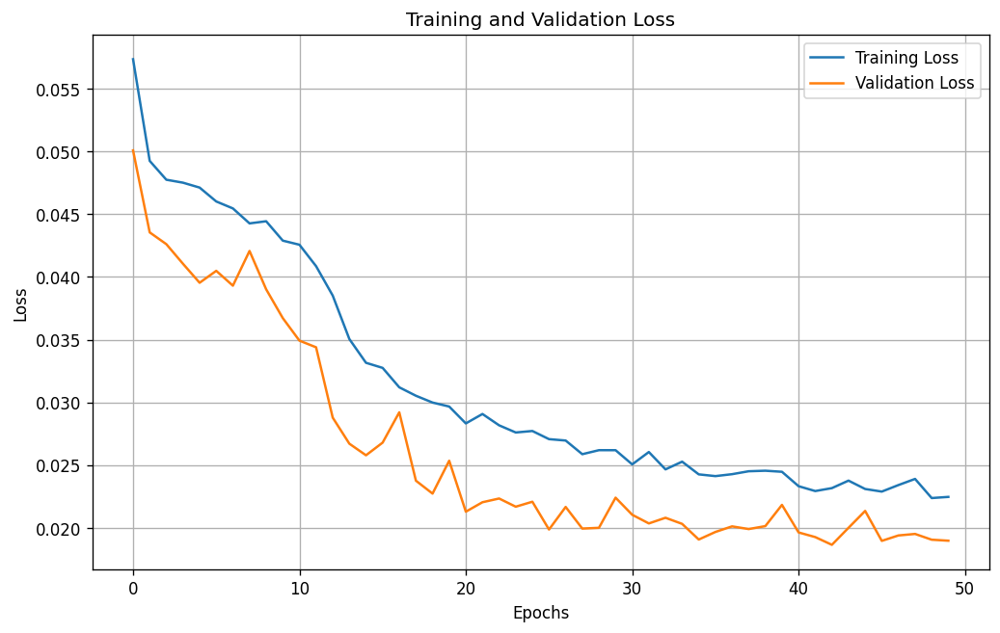

In [ ]:
# Plot the training and validation loss

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

In [30]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

data5 = {'Model Name': ['model5_lstm_gridsearch'],
        'MAE': [0.08],
        'MSE': [0.02],
        'RMSE': [0.15],
        'R2 Score': [0.62],
        'Remarks': ["Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01"]}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)
df5 = pd.DataFrame(data5)

df = pd.concat([df1, df2, df3, df4, df5], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"
model2_lstm,4315.61,54436321.48,7378.10,0.65,"12 sequential length, predict next 12 months"
model3_lstm,4044.47,44104961.27,6641.16,0.71,"24 sequential length, predict next 12 months"
model4_lstm,3934.89,41968954.69,6478.35,0.73,"36 sequential length, predict next 12 months"
model5_lstm_gridsearch,0.08,0.02,0.15,0.62,Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01


In [ ]:
# Forecast Next 12 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = best_model.predict(input_sequence)  # Use best_model instead of model5_lstm_gridsearch
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: -64.69 MT
Month 2: 4672.13 MT
Month 3: 27902.15 MT
Month 4: 2885.36 MT
Month 5: 575.88 MT
Month 6: 363.16 MT
Month 7: 641.42 MT
Month 8: 19670.79 MT
Month 9: 15369.91 MT
Month 10: 86.64 MT
Month 11: 181.91 MT
Month 12: 2289.07 MT

Predicted Rice Production for Bongabon:
Month 1: 137.88 MT
Month 2: 81.56 MT
Month 3: 383.19 MT
Month 4: 7342.59 MT
Month 5: 8036.95 MT
Month 6: 1406.29 MT
Month 7: 39.61 MT
Month 8: 488.01 MT
Month 9: 294.32 MT
Month 10: 2097.24 MT
Month 11: 10800.84 MT
Month 12: 3588.61 MT

Predicted Rice Production for Cabanatuan:
Month 1: 388.11 MT
Month 2: 322.26 MT
Month 3: 1249.66 MT
Month 4: 16250.57 MT
Month 5: 30049.62 MT
Month 6: 5169.55 MT
Month 7: 464.69 MT
Month 8: 854.07 MT
Month 9: 3461.35 MT
Month 10: 14341.59 MT
Month 11: 20106.37 MT
Month 12: 780.55 MT

Predicted Rice Production for Cabiao:
Month 1: 183.52 MT
Month 2: 700.97 MT
Month 3: 16444.33 MT
Month 4: 31693.30 MT
Month 5: 1886.67 MT
Month 6: 262.32 MT
Mo

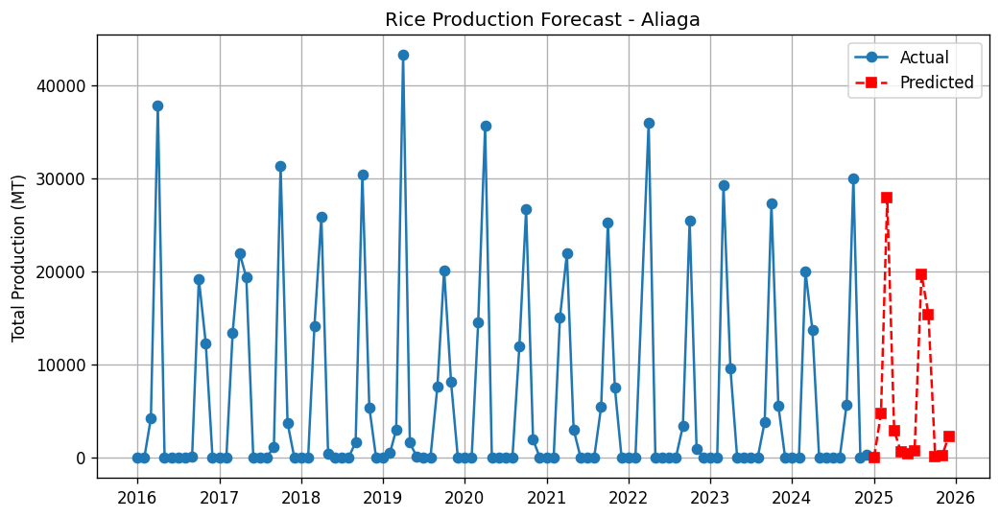

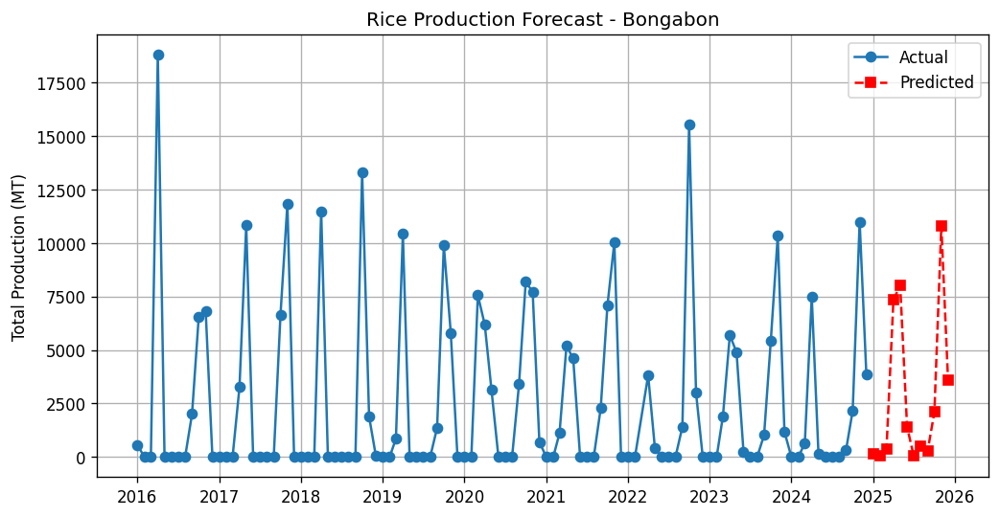

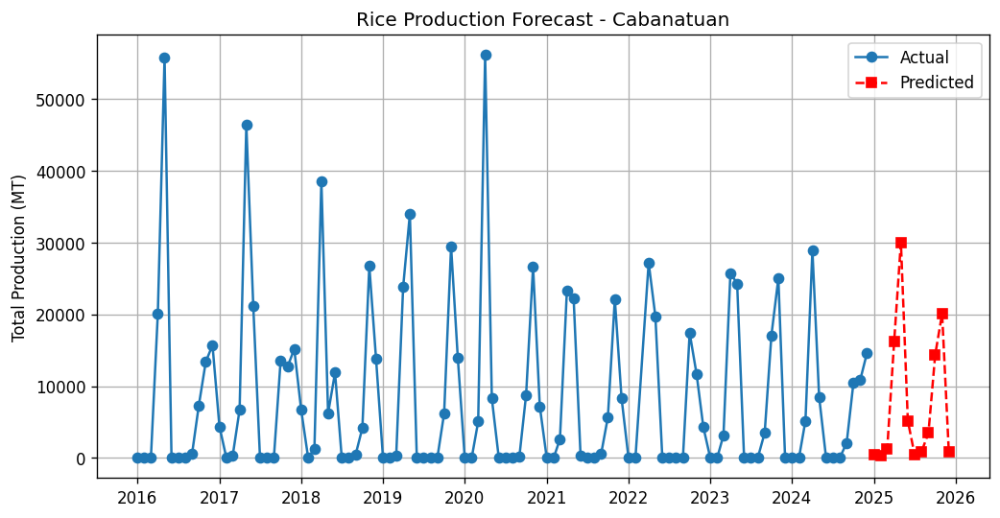

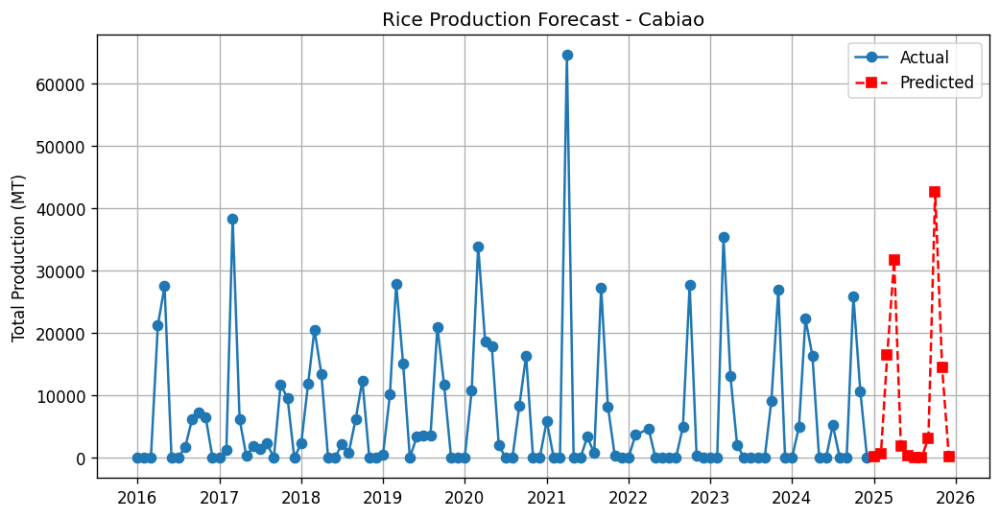

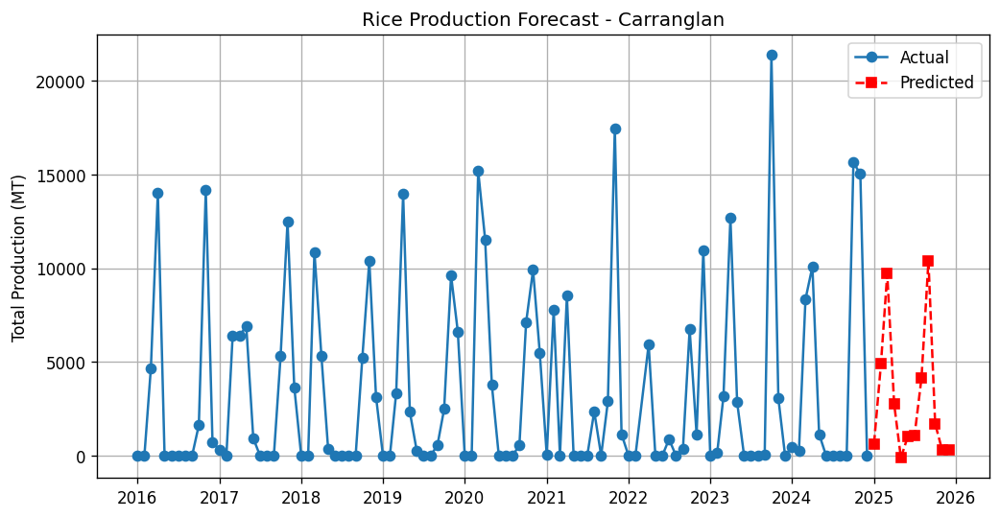

...

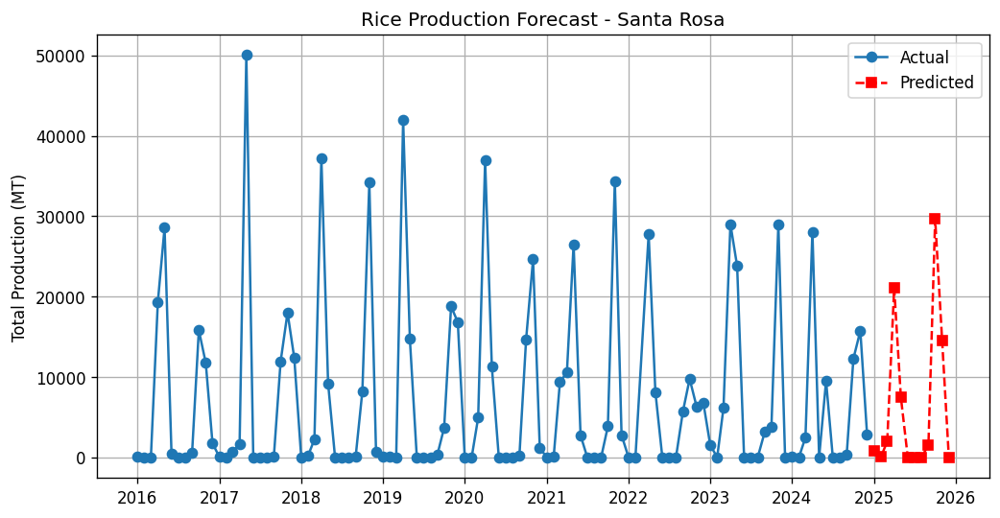

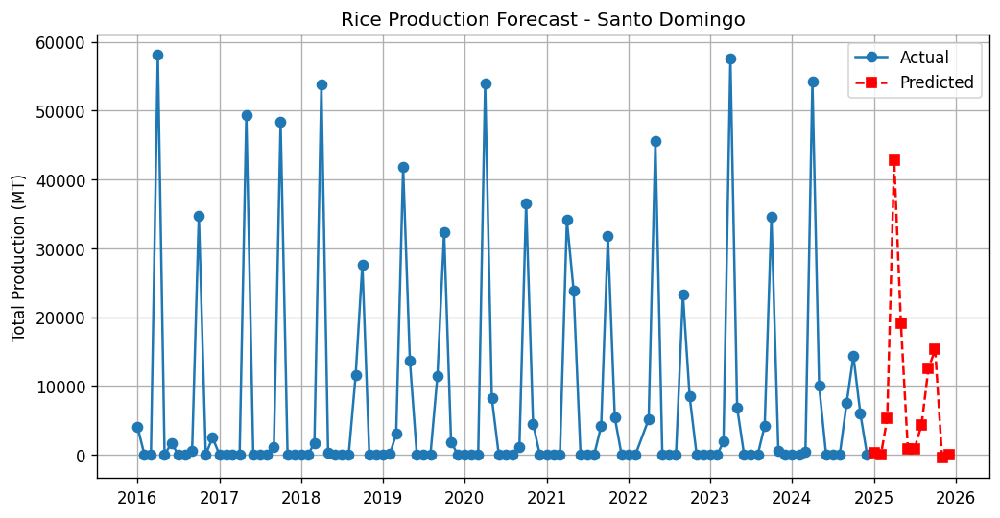

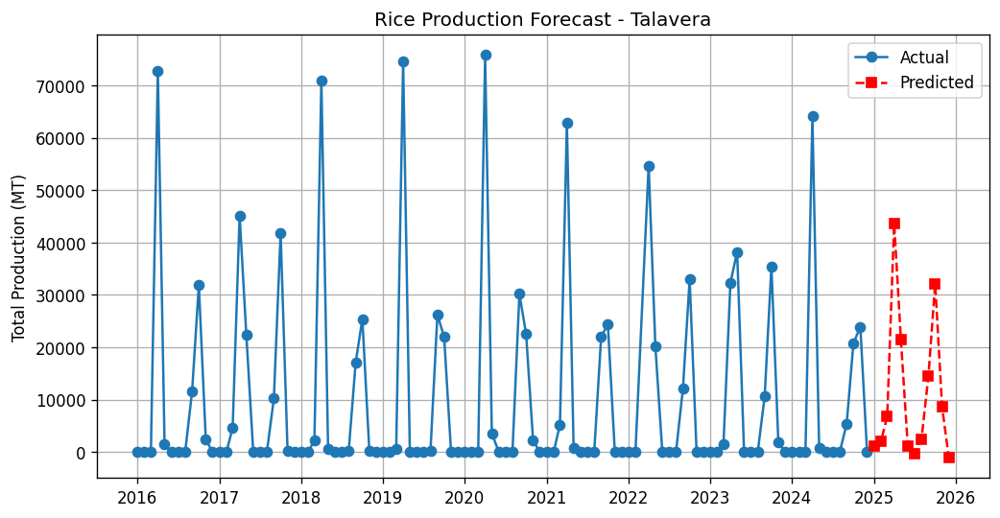

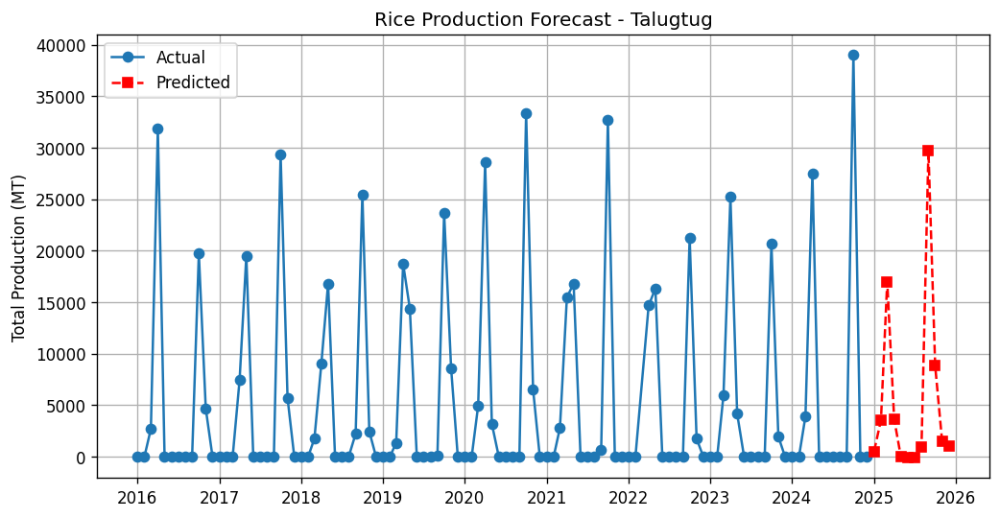

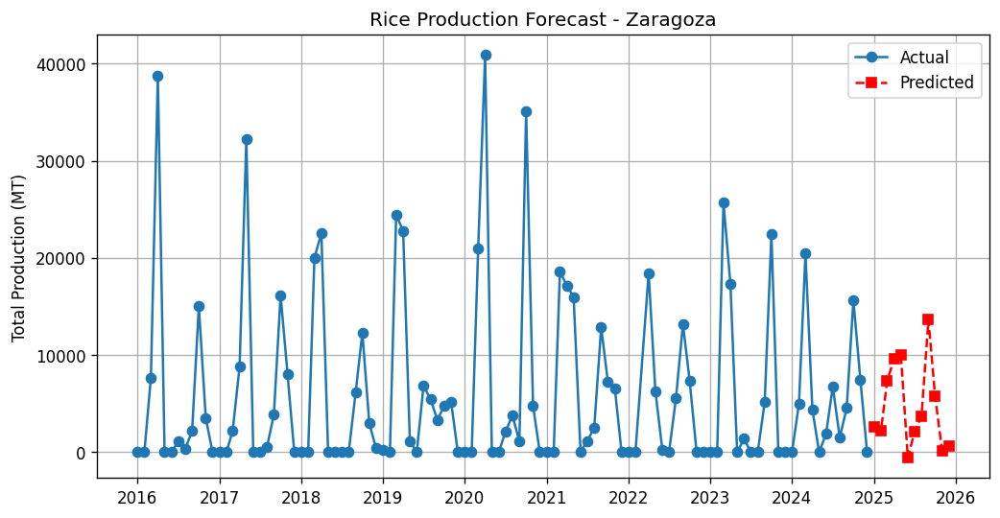

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model6_lstm_gridsearch**

In [ ]:
import shutil

# Remove the previous tuning directory to force a fresh search
if os.path.exists("lstm_tuning"):
    shutil.rmtree("lstm_tuning")

In [ ]:
# model6_lstm_gridsearch
# increase values of the hyperparameter values

import numpy as np
import tensorflow as tf
import keras_tuner as kt
import json
import os

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# Ensure models directory existsCreate
os.makedirs("models", exist_ok=True)

# Define lookback window size
sequence_length = 24

# Define Function to Create the LSTM Model with Hyperparameter Tuning
def build_model(hp):
    model6_lstm_gridsearch = Sequential()

    # First LSTM Layer
    model6_lstm_gridsearch.add(LSTM(units=hp.Int('units', min_value=64, max_value=512, step=64),
                   return_sequences=True, input_shape=(sequence_length, 1)))
    model6_lstm_gridsearch.add(Dropout(hp.Float('dropout', 0.2, 0.6, step=0.1)))

    # Second LSTM Layer
    model6_lstm_gridsearch.add(LSTM(units=hp.Int('units_2', min_value=64, max_value=256, step=64),
                   return_sequences=False))
    model6_lstm_gridsearch.add(Dropout(hp.Float('dropout_2', 0.2, 0.6, step=0.1)))

    # Fully Connected Layer
    model6_lstm_gridsearch.add(Dense(1))

    # Choose optimizer dynamically
    optimizer_choice = hp.Choice('optimizer', values=['adam', 'adamw'])
    learning_rate = hp.Choice('learning_rate', values=[0.0005, 0.005, 0.05])

    if optimizer_choice == 'adam':
        optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    else:
        optimizer = tf.keras.optimizers.AdamW(learning_rate=learning_rate, weight_decay=1e-4)

    model6_lstm_gridsearch.compile(optimizer=optimizer, loss='mae')
    return model6_lstm_gridsearch

# Apply Grid Search Hyperparameter Tuning
tuner = kt.GridSearch(
    build_model,
    objective='val_loss',
    max_trials=15,  # Number of hyperparameter combinations to try
    executions_per_trial=2,
    directory='lstm_tuning',
    project_name='grid_search_lstm'
)

# Run Grid Search Hyperparameter Tuning
tuner.search(X_train, y_train, epochs=200, validation_data=(X_test, y_test), batch_size=64)

# Get the Best Hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print Best Hyperparameter Values
print("\n Best Hyperparameters Found:")
for key in best_hyperparameters.values.keys():
    print(f" {key}: {best_hyperparameters.get(key)}")

# Get the Best Model from Tuning
best_model = tuner.get_best_models(num_models=1)[0]

# Evaluate the Best Model
y_pred = best_model.predict(X_test)

# Compute Evaluation Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print Results
print("\n Model Evaluation Metrics:")
print(f" MAE: {mae:.2f}")
print(f" MSE: {mse:.2f}")
print(f" RMSE: {rmse:.2f}")
print(f" R2 Score: {r2:.2f}")


Trial 15 Complete [00h 07m 23s]
val_loss: 0.12299428880214691

Best val_loss So Far: 0.06774598732590675
Total elapsed time: 01h 49m 00s

 Best Hyperparameters Found:
 units: 64
 dropout: 0.2
 units_2: 64
 dropout_2: 0.4
 optimizer: adam
 learning_rate: 0.005


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step

 Model Evaluation Metrics:
 MAE: 0.07
 MSE: 0.02
 RMSE: 0.13
 R2 Score: 0.70


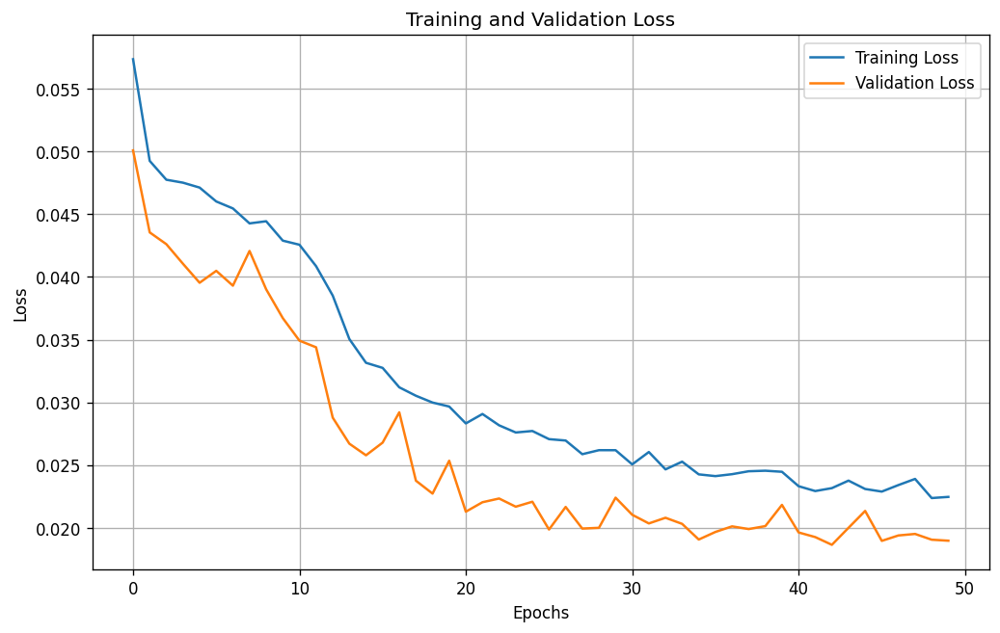

In [ ]:
# Plot the training and validation loss

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()


In [28]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

data5 = {'Model Name': ['model5_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.69],
        'Remarks': ["Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01"]}

data6 = {'Model Name': ['model6_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.70],
        'Remarks': ["Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005"]}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)
df5 = pd.DataFrame(data5)
df6 = pd.DataFrame(data6)

df = pd.concat([df1, df2, df3, df4, df5, df6], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.93,54656318.97,7392.99,0.65,"12 sequential length, predict next 6 months"
model2_lstm,4315.61,54436321.48,7378.10,0.65,"12 sequential length, predict next 12 months"
model3_lstm,4044.47,44104961.27,6641.16,0.71,"24 sequential length, predict next 12 months"
model4_lstm,3934.89,41968954.69,6478.35,0.73,"36 sequential length, predict next 12 months"
model5_lstm_gridsearch,0.07,0.02,0.13,0.69,Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01
model6_lstm_gridsearch,0.07,0.02,0.13,0.70,Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005


In [ ]:
# Forecast Next 12 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = best_model.predict(input_sequence)  # Use best_model instead of model6_lstm_gridsearch
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: -50.28 MT
Month 2: 638.79 MT
Month 3: 14086.27 MT
Month 4: 19561.87 MT
Month 5: 71.33 MT
Month 6: -17.17 MT
Month 7: 5.59 MT
Month 8: 43.61 MT
Month 9: 5696.86 MT
Month 10: 24813.84 MT
Month 11: 2164.89 MT
Month 12: -23.58 MT

Predicted Rice Production for Bongabon:
Month 1: -23.35 MT
Month 2: -11.04 MT
Month 3: 258.52 MT
Month 4: 6679.55 MT
Month 5: 4140.27 MT
Month 6: 33.12 MT
Month 7: 0.20 MT
Month 8: -23.37 MT
Month 9: 277.78 MT
Month 10: 5451.53 MT
Month 11: 8723.79 MT
Month 12: 561.14 MT

Predicted Rice Production for Cabanatuan:
Month 1: -14.37 MT
Month 2: -42.66 MT
Month 3: 1066.74 MT
Month 4: 20930.23 MT
Month 5: 22883.89 MT
Month 6: -37.15 MT
Month 7: -30.80 MT
Month 8: -44.32 MT
Month 9: 1085.83 MT
Month 10: 20711.37 MT
Month 11: 22148.44 MT
Month 12: 49.52 MT

Predicted Rice Production for Cabiao:
Month 1: -18.49 MT
Month 2: -128.38 MT
Month 3: 22122.29 MT
Month 4: 29988.86 MT
Month 5: 152.92 MT
Month 6: -43.34 MT
Month 7: -26

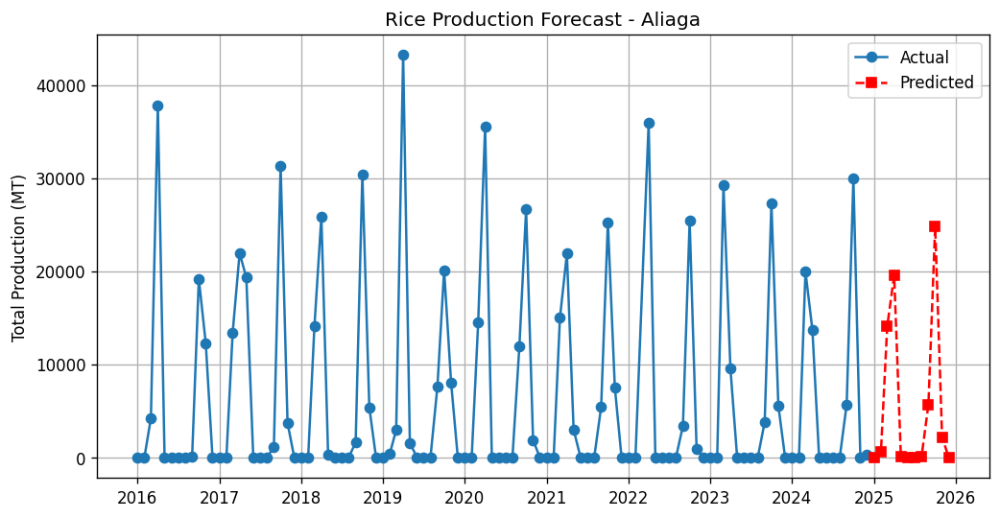

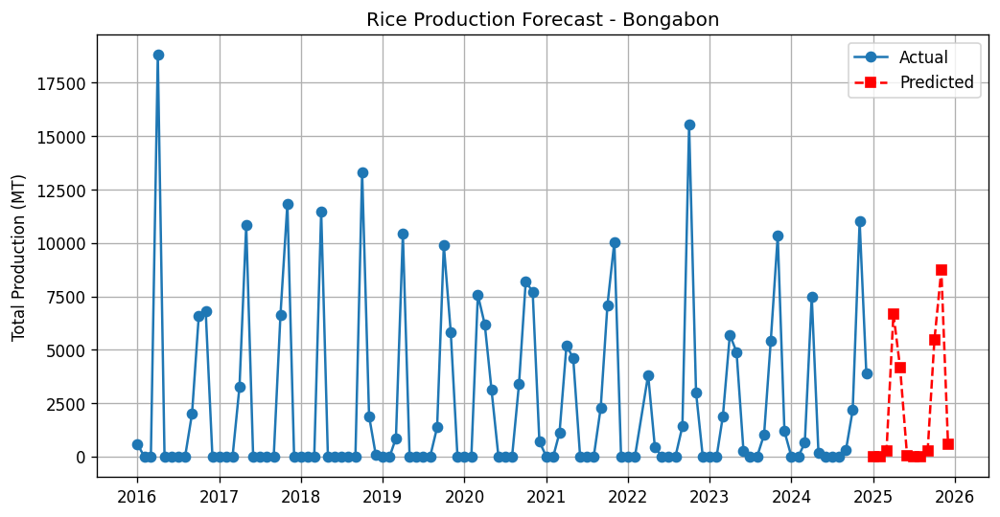

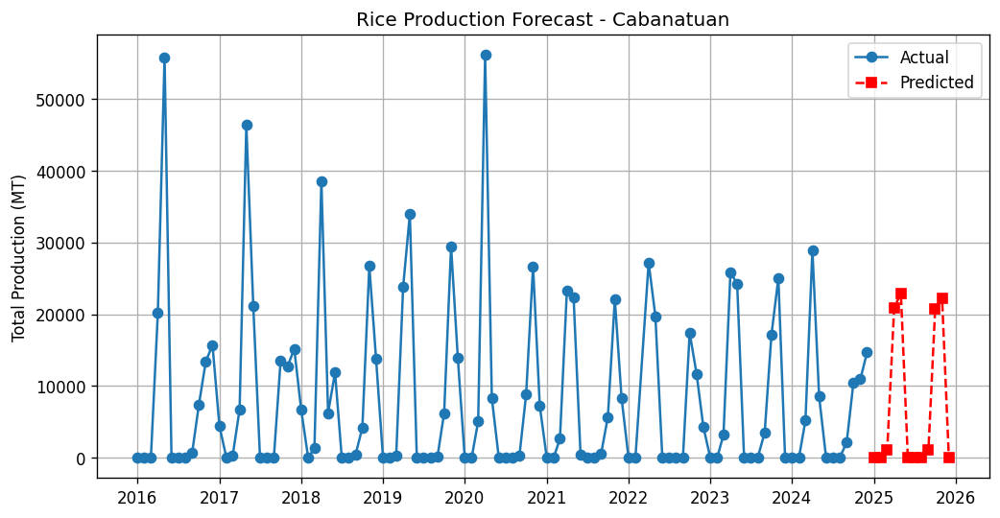

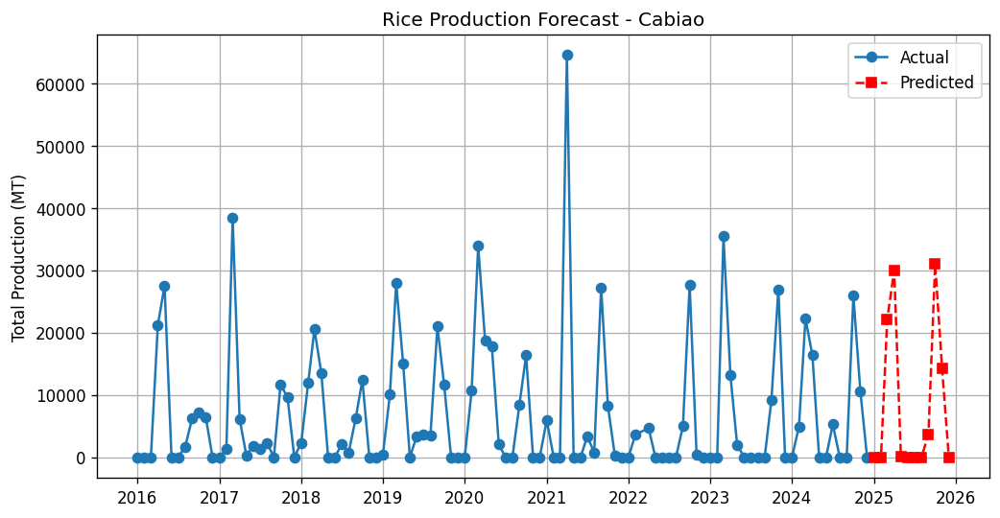

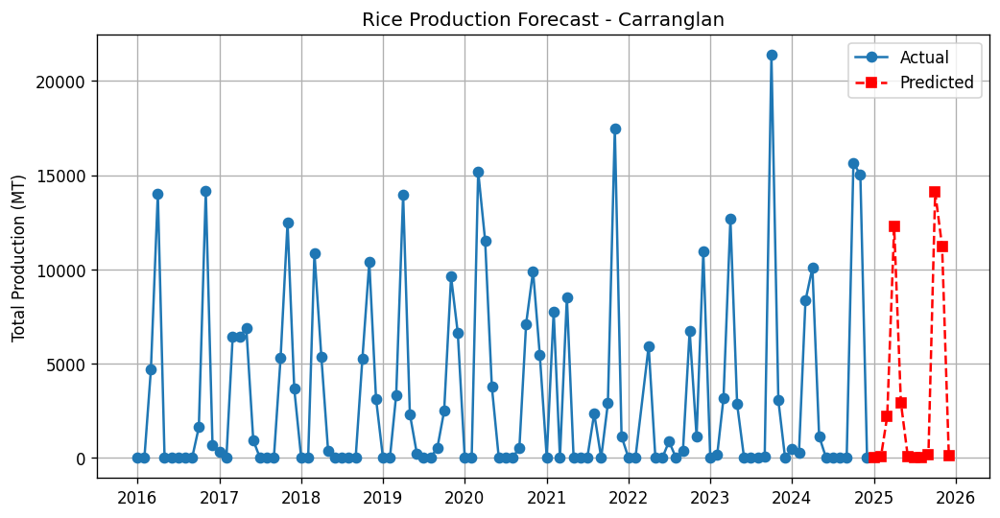

...

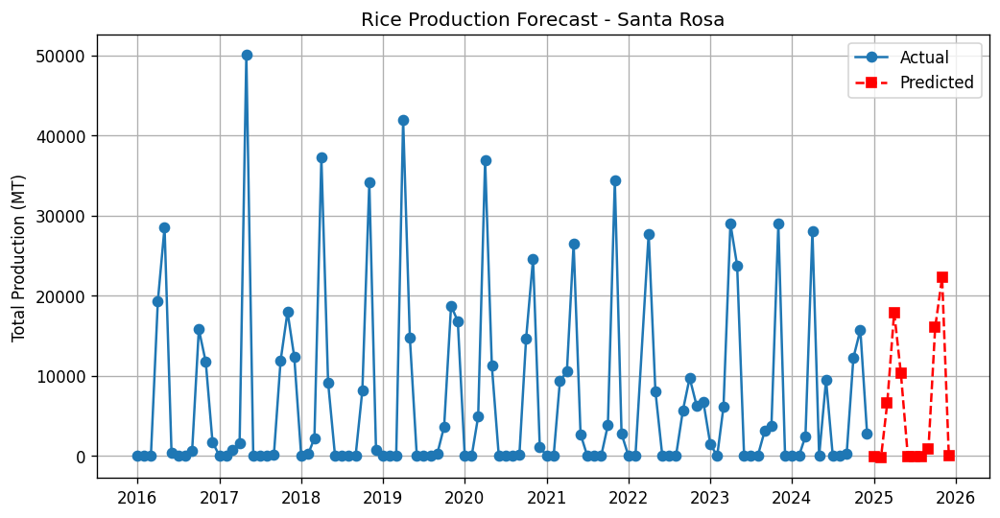

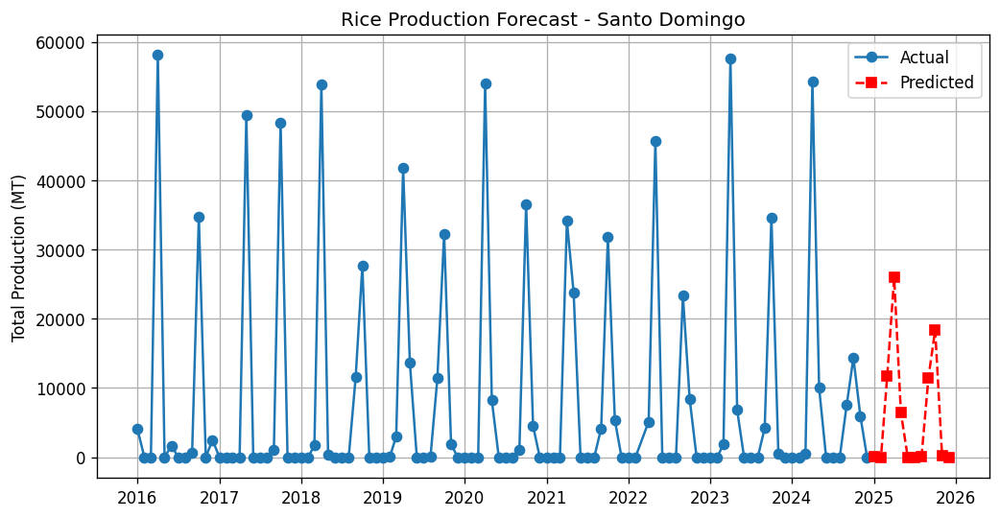

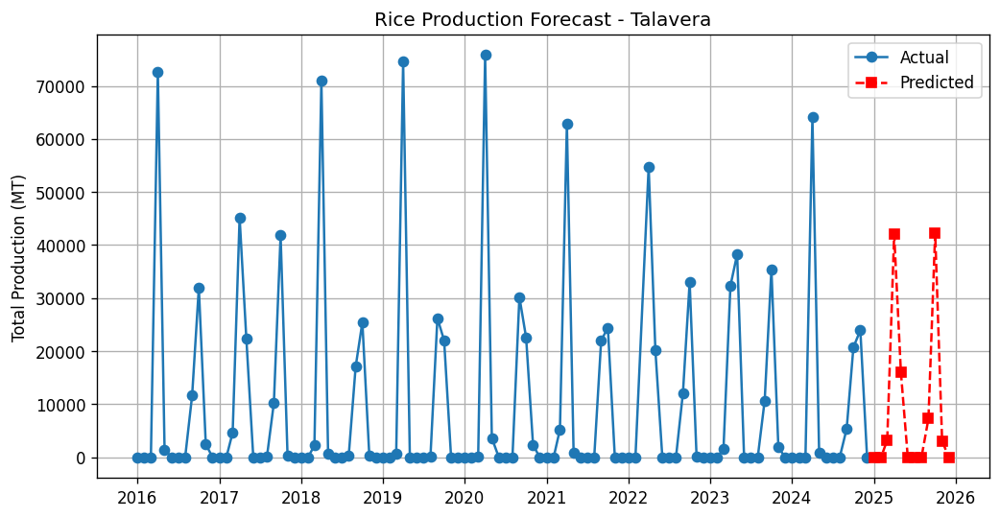

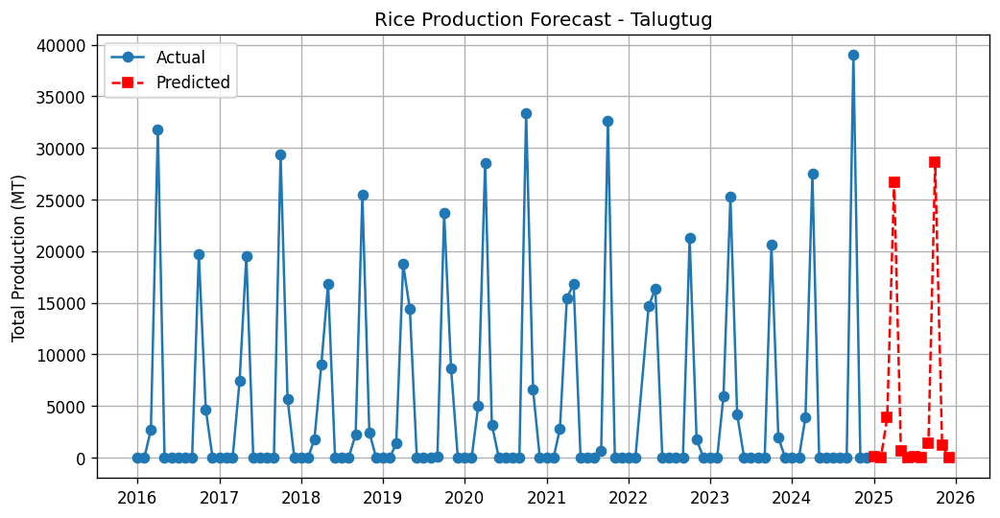

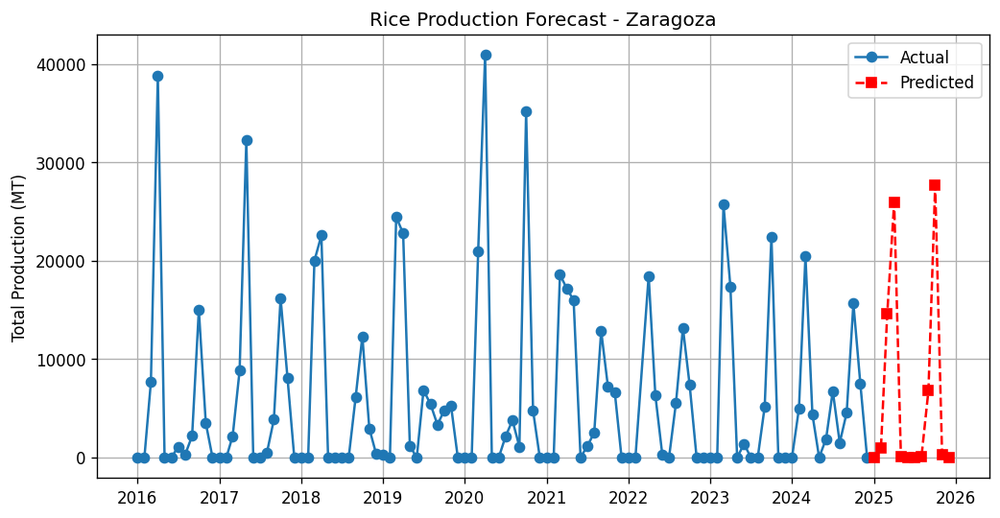

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

### **model7_lstm_gridsearch**

In [ ]:
import os
import shutil

# Remove the previous tuning directory to force a fresh search
if os.path.exists("lstm_tuning"):
    shutil.rmtree("lstm_tuning")

In [ ]:
# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 24
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape X_train and X_test to ensure compatibility with LSTM
X_train = np.reshape(X_train, (X_train.shape[0], sequence_length, 1))
X_test = np.reshape(X_test, (X_test.shape[0], sequence_length, 1))

print("X_train shape:", X_train.shape)  # Should be (samples, 24, 1)
print("X_test shape:", X_test.shape)    # Should be (samples, 24, 1)

X_train shape: (2124, 24, 1)
X_test shape: (532, 24, 1)


In [ ]:
# model7_lstm_gridsearch

import numpy as np
import tensorflow as tf
import keras_tuner as kt
import json
import os

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.models import Model
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input, Multiply
from tensorflow.keras.optimizers import Adam, AdamW

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Define lookback window size
sequence_length = 24

# Attention Mechanism Layer
class Attention(tf.keras.layers.Layer):
    def __init__(self):
        super(Attention, self).__init__()

    def build(self, input_shape):
        self.W = self.add_weight(shape=(input_shape[-1], input_shape[-1]), initializer="random_normal", trainable=True)
        self.b = self.add_weight(shape=(input_shape[-1],), initializer="zeros", trainable=True)

    def call(self, inputs):
        score = tf.nn.tanh(tf.linalg.matmul(inputs, self.W) + self.b)
        attention_weights = tf.nn.softmax(score, axis=1)
        return inputs * attention_weights  # Ensure proper shape handling

# Define Function to Create the LSTM Model with Attention Mechanism and Hyperparameter Tuning
def build_model(hp):
    inputs = Input(shape=(sequence_length, 1))

    # First LSTM Layer
    lstm_out1 = LSTM(units=hp.Int('units', min_value=64, max_value=512, step=64), return_sequences=True)(inputs)
    dropout1 = Dropout(hp.Float('dropout', 0.2, 0.6, step=0.1))(lstm_out1)

    # Attention Mechanism
    attention_output = Attention()(dropout1)

    # Second LSTM Layer
    lstm_out2 = LSTM(units=hp.Int('units_2', min_value=64, max_value=256, step=64), return_sequences=False)(attention_output)
    dropout2 = Dropout(hp.Float('dropout_2', 0.2, 0.6, step=0.1))(lstm_out2)

    # Fully Connected Output Layer
    output = Dense(1)(dropout2)

    model = Model(inputs, output)

    # Choose optimizer dynamically
    optimizer_choice = hp.Choice('optimizer', values=['adam', 'adamw'])
    learning_rate = hp.Choice('learning_rate', values=[0.0001, 0.0005, 0.001, 0.005])

    if optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    else:
        optimizer = AdamW(learning_rate=learning_rate, weight_decay=1e-4)

    model.compile(optimizer=optimizer, loss='mae')

    return model

# Apply Grid Search Hyperparameter Tuning
tuner = kt.GridSearch(
    build_model,
    objective='val_loss',
    max_trials=15,  # Increased for better search space coverage
    executions_per_trial=3,  # More executions per trial for stability
    directory='lstm_tuning',
    project_name='grid_search_lstm_attention'
)

# Run Grid Search Hyperparameter Tuning
tuner.search(X_train, y_train, epochs=200, validation_data=(X_test, y_test), batch_size=64)

# Get the Best Hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print Best Hyperparameter Values
print("\n Best Hyperparameters Found:")
for key in best_hyperparameters.values.keys():
    print(f" {key}: {best_hyperparameters.get(key)}")

# Get the Best Model from Tuning
best_model = tuner.get_best_models(num_models=1)[0]

# Save the Best Model
# best_model.save("models/best_lstm_attention_model.h5")

# Evaluate the Best Model
y_pred = best_model.predict(X_test)

# Compute Evaluation Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print Results
print("\n Model Evaluation Metrics:")
print(f" MAE: {mae:.4f}")
print(f" MSE: {mse:.4f}")
print(f" RMSE: {rmse:.4f}")
print(f" R2 Score: {r2:.4f}")

Trial 15 Complete [00h 21m 32s]
val_loss: 0.07913729051748912

Best val_loss So Far: 0.06906231492757797
Total elapsed time: 05h 18m 51s

 Best Hyperparameters Found:
 units: 64
 dropout: 0.2
 units_2: 64
 dropout_2: 0.30000000000000004
 optimizer: adam
 learning_rate: 0.005


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 22 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step

 Model Evaluation Metrics:
 MAE: 0.0680
 MSE: 0.0203
 RMSE: 0.1426
 R2 Score: 0.6270


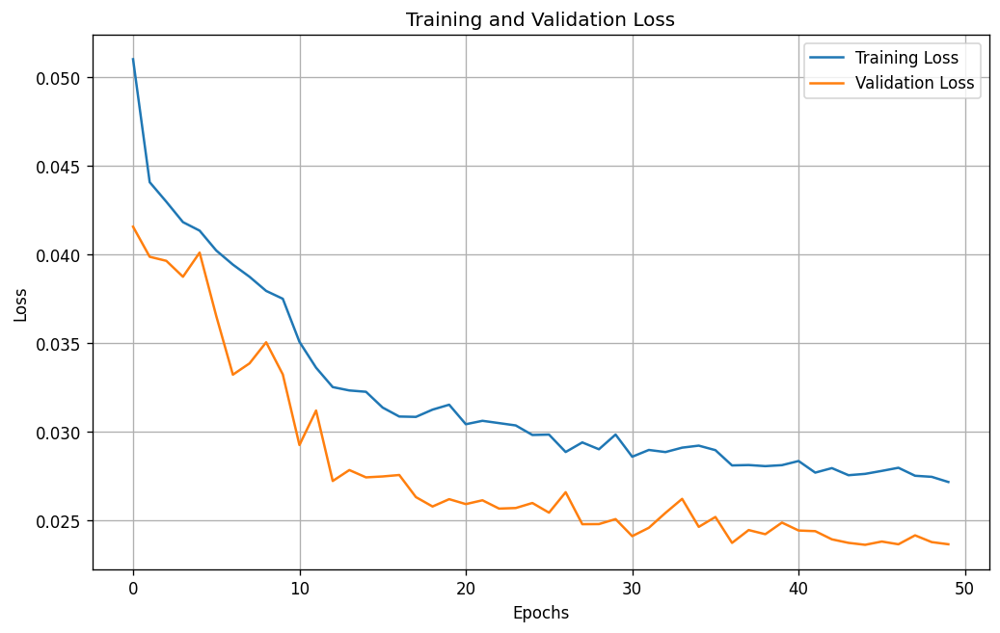

In [ ]:
# Plot the training and validation loss

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

In [27]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

data5 = {'Model Name': ['model5_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.69],
        'Remarks': ["Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01"]}

data6 = {'Model Name': ['model6_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.70],
        'Remarks': ["Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005"]}

data7 = {'Model Name': ['model7_lstm_gridsearch'],
        'MAE': [0.0680],
        'MSE': [0.0203],
        'RMSE': [0.1426],
        'R2 Score': [0.6270],
        'Remarks': ["With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005"]}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)
df5 = pd.DataFrame(data5)
df6 = pd.DataFrame(data6)
df7 = pd.DataFrame(data7)

df = pd.concat([df1, df2, df3, df4, df5, df6, df7], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.930,5.465632e+07,7392.9900,0.650,"12 sequential length, predict next 6 months"
model2_lstm,4315.610,5.443632e+07,7378.1000,0.650,"12 sequential length, predict next 12 months"
model3_lstm,4044.470,4.410496e+07,6641.1600,0.710,"24 sequential length, predict next 12 months"
model4_lstm,3934.890,4.196895e+07,6478.3500,0.730,"36 sequential length, predict next 12 months"
model5_lstm_gridsearch,0.070,2.000000e-02,0.1300,0.690,Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01
model6_lstm_gridsearch,0.070,2.000000e-02,0.1300,0.700,Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005
model7_lstm_gridsearch,0.068,2.030000e-02,0.1426,0.627,With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005


In [ ]:
# Forecast Next 12 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = best_model.predict(input_sequence)  # Use best_model instead of model7_lstm_gridsearch
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")


Predicted Rice Production for Aliaga:
Month 1: -14.74 MT
Month 2: 656.41 MT
Month 3: 25506.95 MT
Month 4: 7528.05 MT
Month 5: -3.57 MT
Month 6: -42.27 MT
Month 7: -40.69 MT
Month 8: 80.29 MT
Month 9: 8295.00 MT
Month 10: 28334.74 MT
Month 11: 368.82 MT
Month 12: -24.02 MT

Predicted Rice Production for Bongabon:
Month 1: 24.89 MT
Month 2: 21.17 MT
Month 3: 2958.87 MT
Month 4: 5390.62 MT
Month 5: 69.21 MT
Month 6: 75.88 MT
Month 7: -40.66 MT
Month 8: -26.65 MT
Month 9: 26.11 MT
Month 10: 3605.90 MT
Month 11: 10382.58 MT
Month 12: 2164.04 MT

Predicted Rice Production for Cabanatuan:
Month 1: -25.43 MT
Month 2: -36.73 MT
Month 3: 2132.18 MT
Month 4: 27118.71 MT
Month 5: 6983.83 MT
Month 6: 116.20 MT
Month 7: -47.89 MT
Month 8: 34.69 MT
Month 9: 490.36 MT
Month 10: 11244.44 MT
Month 11: 21836.15 MT
Month 12: 466.53 MT

Predicted Rice Production for Cabiao:
Month 1: 10.59 MT
Month 2: 3142.70 MT
Month 3: 30272.32 MT
Month 4: 21635.80 MT
Month 5: 178.16 MT
Month 6: 125.64 MT
Month 7: 42.82 

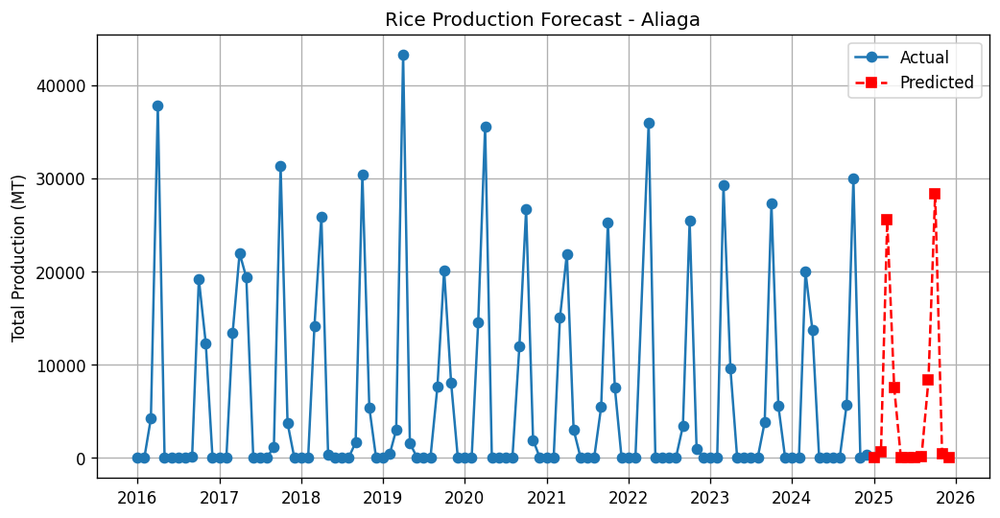

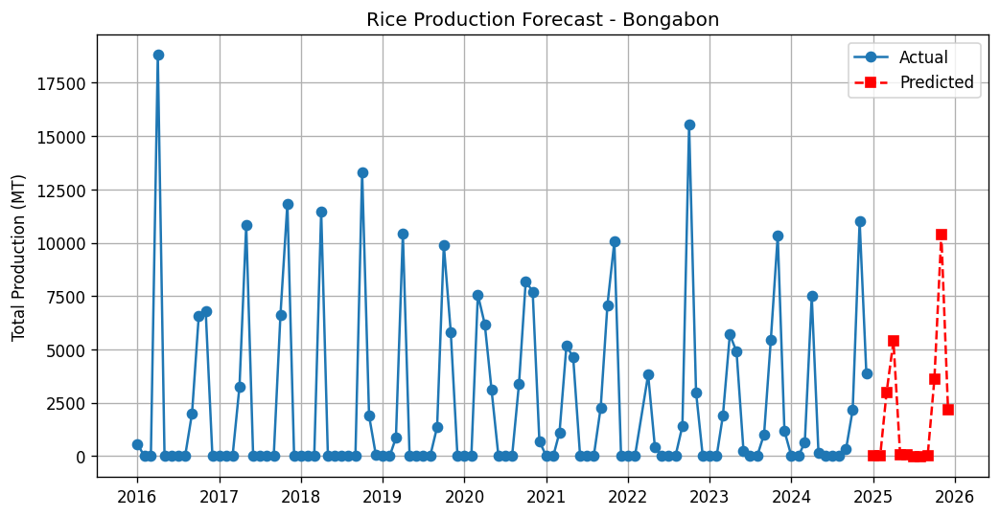

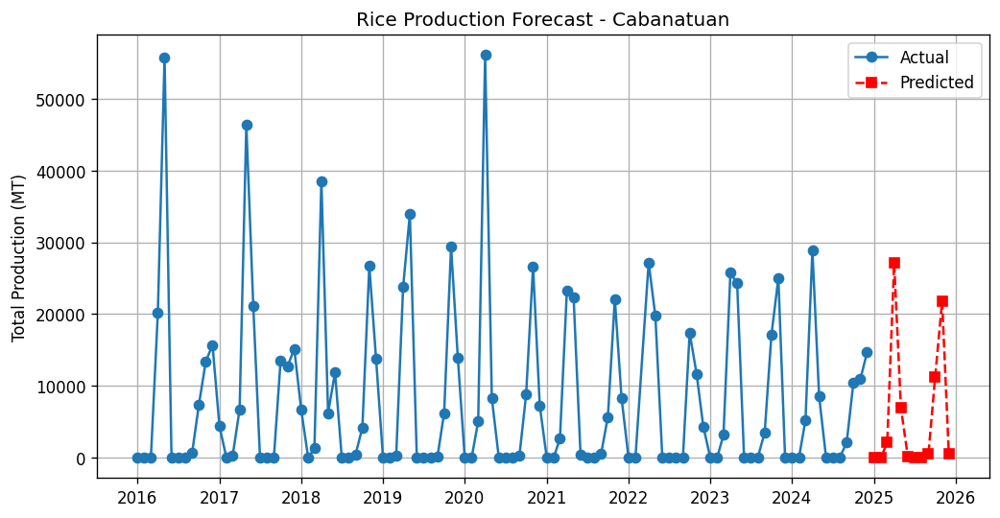

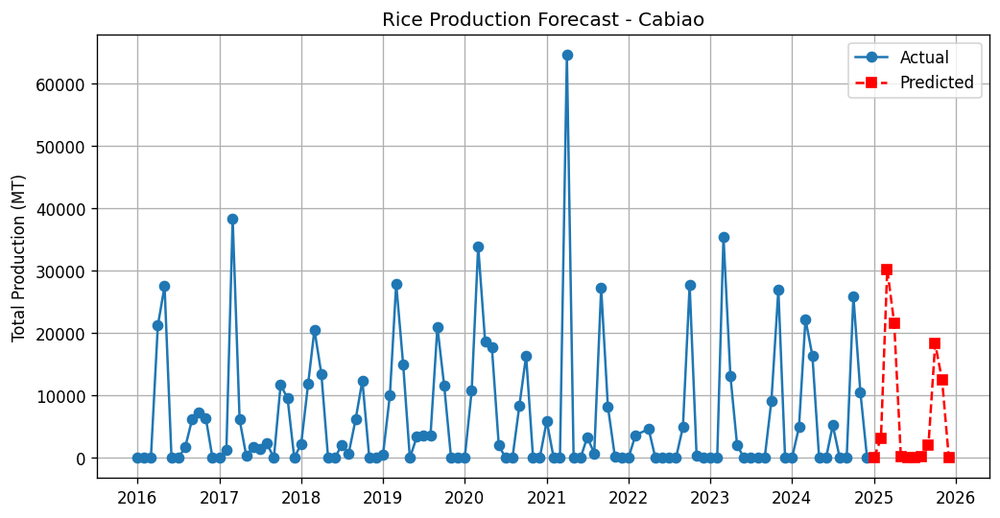

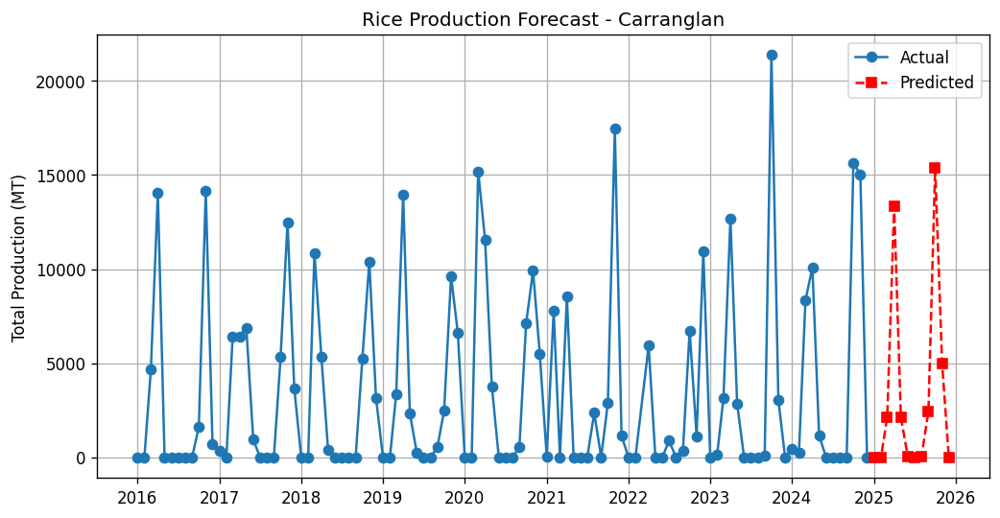

...

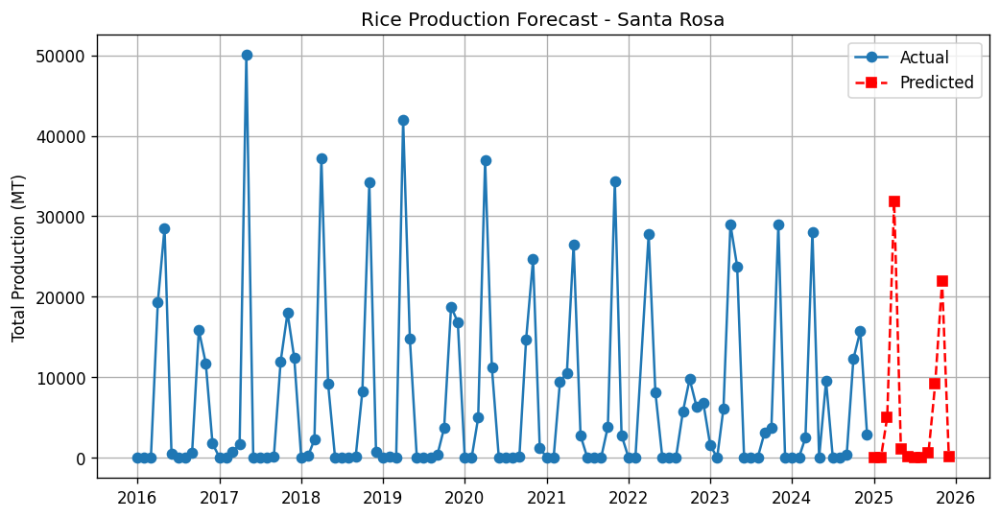

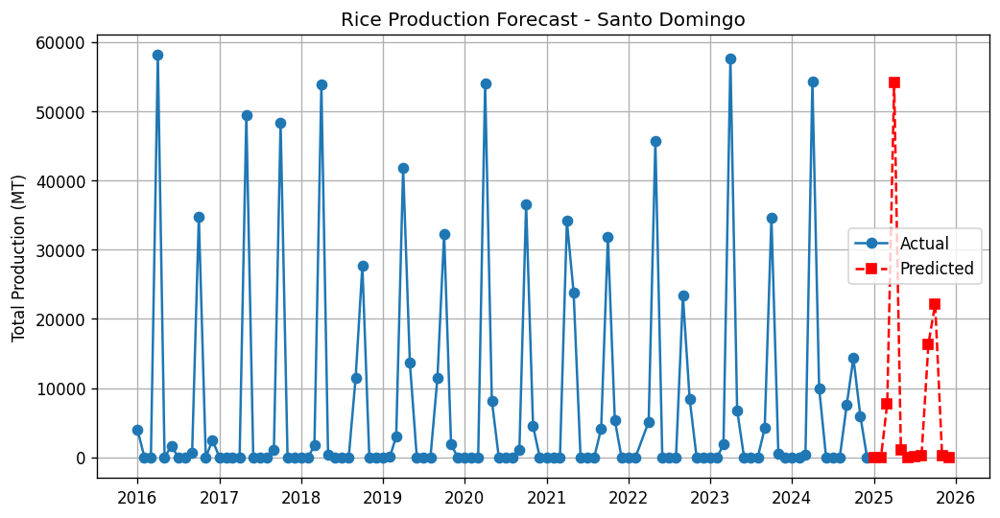

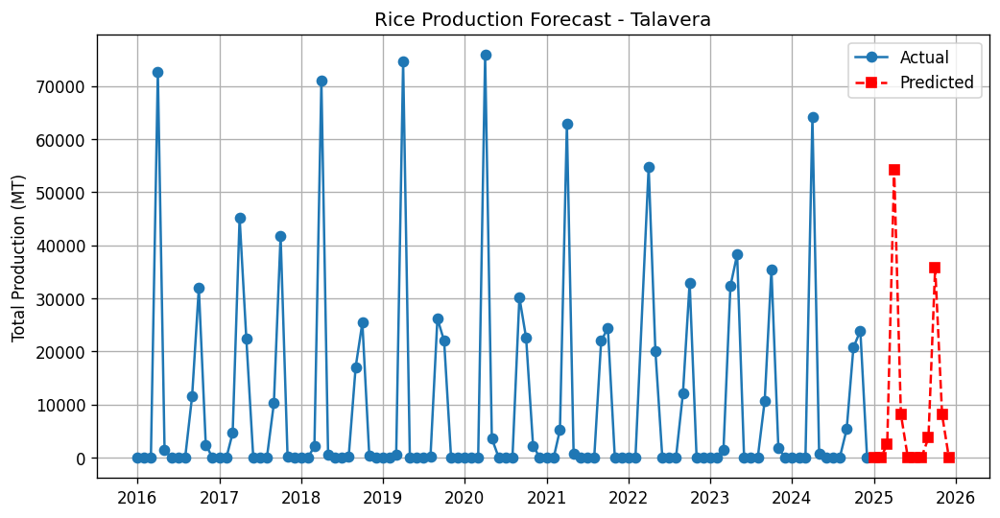

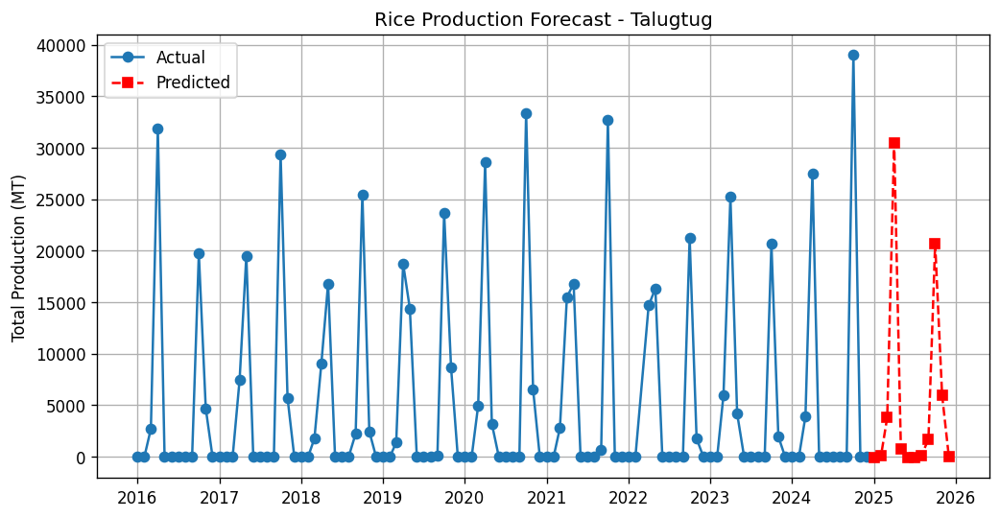

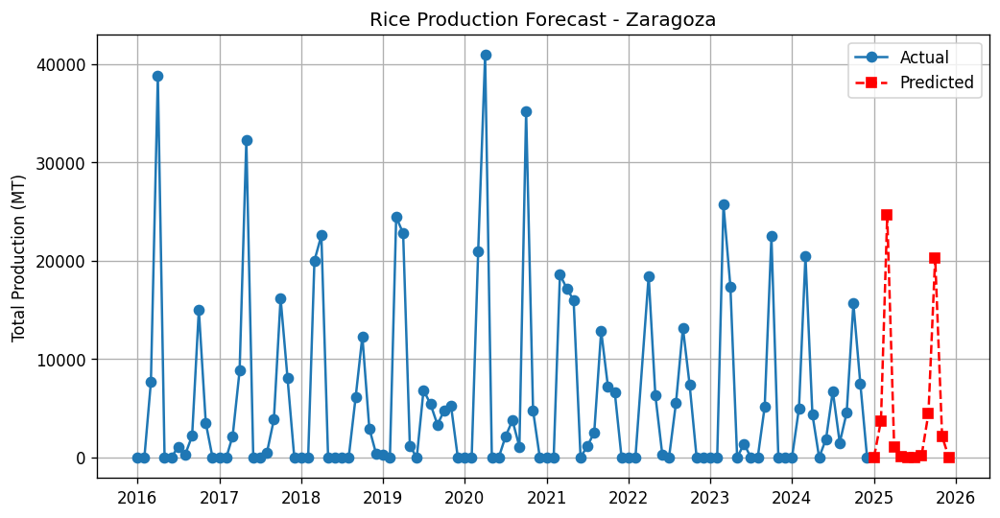

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()

## **model8_lstm_bayesian**

In [15]:
import os
import shutil

# Remove the previous tuning directory to force a fresh search
if os.path.exists("lstm_tuning"):
    shutil.rmtree("lstm_tuning")

In [18]:
# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 24
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape X_train and X_test to ensure compatibility with LSTM
X_train = np.reshape(X_train, (X_train.shape[0], sequence_length, 1))
X_test = np.reshape(X_test, (X_test.shape[0], sequence_length, 1))

print("X_train shape:", X_train.shape)  # Should be (samples, 24, 1)
print("X_test shape:", X_test.shape)    # Should be (samples, 24, 1)

X_train shape: (2124, 24, 1)
X_test shape: (532, 24, 1)


Trial 15 Complete [00h 16m 10s]
val_loss: 0.11260729779799779

Best val_loss So Far: 0.07216298828522365
Total elapsed time: 06h 55m 20s
Epoch 1/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.1581 - mse: 0.0732
Epoch 1: val_loss improved from inf to 0.13766, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 8s 165ms/step - loss: 0.1579 - mse: 0.0731 - val_loss: 0.1377 - val_mse: 0.0659 - learning_rate: 3.7360e-04
Epoch 2/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1502 - mse: 0.0718
Epoch 2: val_loss did not improve from 0.13766
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1500 - mse: 0.0717 - val_loss: 0.1378 - val_mse: 0.0592 - learning_rate: 3.7360e-04
Epoch 3/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.1516 - mse: 0.0696
Epoch 3: val_loss improved from 0.13766 to 0.13342, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1514 - mse: 0.0695 - val_loss: 0.1334 - val_mse: 0.0603 - learning_rate: 3.7360e-04
Epoch 4/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1432 - mse: 0.0617
Epoch 4: val_loss improved from 0.13342 to 0.13324, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1432 - mse: 0.0616 - val_loss: 0.1332 - val_mse: 0.0471 - learning_rate: 3.7360e-04
Epoch 5/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1442 - mse: 0.0558
Epoch 5: val_loss improved from 0.13324 to 0.13314, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1441 - mse: 0.0558 - val_loss: 0.1331 - val_mse: 0.0603 - learning_rate: 3.7360e-04
Epoch 6/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1393 - mse: 0.0584
Epoch 6: val_loss improved from 0.13314 to 0.12697, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1394 - mse: 0.0583 - val_loss: 0.1270 - val_mse: 0.0527 - learning_rate: 3.7360e-04
Epoch 7/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1399 - mse: 0.0591
Epoch 7: val_loss did not improve from 0.12697
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 149ms/step - loss: 0.1399 - mse: 0.0591 - val_loss: 0.1324 - val_mse: 0.0614 - learning_rate: 3.7360e-04
Epoch 8/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1507 - mse: 0.0670
Epoch 8: val_loss did not improve from 0.12697
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1505 - mse: 0.0668 - val_loss: 0.1311 - val_mse: 0.0518 - learning_rate: 3.7360e-04
Epoch 9/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1317 - mse: 0.0506
Epoch 9: val_loss did not improve from 0.12697
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1319 - mse: 0.0507 - val_loss: 0.1297 - val_mse: 0.0513 - learning_rate: 3.7360e-04
Epoch 10/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1322 - ms

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1323 - mse: 0.0530 - val_loss: 0.1248 - val_mse: 0.0505 - learning_rate: 3.7360e-04
Epoch 11/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1355 - mse: 0.0508
Epoch 11: val_loss did not improve from 0.12482
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1355 - mse: 0.0508 - val_loss: 0.1265 - val_mse: 0.0512 - learning_rate: 3.7360e-04
Epoch 12/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1400 - mse: 0.0575
Epoch 12: val_loss did not improve from 0.12482
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1399 - mse: 0.0574 - val_loss: 0.1257 - val_mse: 0.0538 - learning_rate: 3.7360e-04
Epoch 13/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1304 - mse: 0.0534
Epoch 13: val_loss improved from 0.12482 to 0.12036, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - loss: 0.1306 - mse: 0.0534 - val_loss: 0.1204 - val_mse: 0.0449 - learning_rate: 3.7360e-04
Epoch 14/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1318 - mse: 0.0522
Epoch 14: val_loss did not improve from 0.12036
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1319 - mse: 0.0523 - val_loss: 0.1255 - val_mse: 0.0519 - learning_rate: 3.7360e-04
Epoch 15/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1369 - mse: 0.0542
Epoch 15: val_loss improved from 0.12036 to 0.11473, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1368 - mse: 0.0541 - val_loss: 0.1147 - val_mse: 0.0401 - learning_rate: 3.7360e-04
Epoch 16/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1208 - mse: 0.0381
Epoch 16: val_loss did not improve from 0.11473
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1209 - mse: 0.0382 - val_loss: 0.1165 - val_mse: 0.0428 - learning_rate: 3.7360e-04
Epoch 17/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1274 - mse: 0.0427
Epoch 17: val_loss did not improve from 0.11473
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1273 - mse: 0.0426 - val_loss: 0.1154 - val_mse: 0.0405 - learning_rate: 3.7360e-04
Epoch 18/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1189 - mse: 0.0379
Epoch 18: val_loss did not improve from 0.11473
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1191 - mse: 0.0380 - val_loss: 0.1194 - val_mse: 0.0353 - learning_rate: 3.7360e-04
Epoch 19/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.129

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1291 - mse: 0.0429 - val_loss: 0.1115 - val_mse: 0.0441 - learning_rate: 3.7360e-04
Epoch 20/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1230 - mse: 0.0479
Epoch 20: val_loss improved from 0.11149 to 0.10272, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1229 - mse: 0.0478 - val_loss: 0.1027 - val_mse: 0.0289 - learning_rate: 3.7360e-04
Epoch 21/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1177 - mse: 0.0399
Epoch 21: val_loss improved from 0.10272 to 0.09871, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1176 - mse: 0.0398 - val_loss: 0.0987 - val_mse: 0.0301 - learning_rate: 3.7360e-04
Epoch 22/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1141 - mse: 0.0387
Epoch 22: val_loss did not improve from 0.09871
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 149ms/step - loss: 0.1140 - mse: 0.0386 - val_loss: 0.0987 - val_mse: 0.0307 - learning_rate: 3.7360e-04
Epoch 23/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1049 - mse: 0.0327
Epoch 23: val_loss did not improve from 0.09871
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1050 - mse: 0.0328 - val_loss: 0.0999 - val_mse: 0.0313 - learning_rate: 3.7360e-04
Epoch 24/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1100 - mse: 0.0372
Epoch 24: val_loss improved from 0.09871 to 0.09739, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1099 - mse: 0.0371 - val_loss: 0.0974 - val_mse: 0.0285 - learning_rate: 3.7360e-04
Epoch 25/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1088 - mse: 0.0352
Epoch 25: val_loss did not improve from 0.09739
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 149ms/step - loss: 0.1087 - mse: 0.0352 - val_loss: 0.0982 - val_mse: 0.0291 - learning_rate: 3.7360e-04
Epoch 26/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1091 - mse: 0.0348
Epoch 26: val_loss improved from 0.09739 to 0.09525, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1090 - mse: 0.0348 - val_loss: 0.0953 - val_mse: 0.0270 - learning_rate: 3.7360e-04
Epoch 27/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1042 - mse: 0.0339
Epoch 27: val_loss did not improve from 0.09525
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1043 - mse: 0.0339 - val_loss: 0.0978 - val_mse: 0.0269 - learning_rate: 3.7360e-04
Epoch 28/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1042 - mse: 0.0325
Epoch 28: val_loss did not improve from 0.09525
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1043 - mse: 0.0326 - val_loss: 0.0981 - val_mse: 0.0255 - learning_rate: 3.7360e-04
Epoch 29/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1076 - mse: 0.0329
Epoch 29: val_loss improved from 0.09525 to 0.09437, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1076 - mse: 0.0328 - val_loss: 0.0944 - val_mse: 0.0289 - learning_rate: 3.7360e-04
Epoch 30/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1013 - mse: 0.0331
Epoch 30: val_loss did not improve from 0.09437
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1014 - mse: 0.0331 - val_loss: 0.0944 - val_mse: 0.0250 - learning_rate: 3.7360e-04
Epoch 31/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.1036 - mse: 0.0317
Epoch 31: val_loss improved from 0.09437 to 0.09268, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1036 - mse: 0.0317 - val_loss: 0.0927 - val_mse: 0.0255 - learning_rate: 3.7360e-04
Epoch 32/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1004 - mse: 0.0303
Epoch 32: val_loss improved from 0.09268 to 0.09233, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1004 - mse: 0.0304 - val_loss: 0.0923 - val_mse: 0.0255 - learning_rate: 3.7360e-04
Epoch 33/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0975 - mse: 0.0282
Epoch 33: val_loss did not improve from 0.09233
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.0976 - mse: 0.0283 - val_loss: 0.0928 - val_mse: 0.0262 - learning_rate: 3.7360e-04
Epoch 34/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0980 - mse: 0.0297
Epoch 34: val_loss improved from 0.09233 to 0.08848, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0980 - mse: 0.0298 - val_loss: 0.0885 - val_mse: 0.0234 - learning_rate: 3.7360e-04
Epoch 35/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0978 - mse: 0.0309
Epoch 35: val_loss improved from 0.08848 to 0.08770, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - loss: 0.0979 - mse: 0.0309 - val_loss: 0.0877 - val_mse: 0.0232 - learning_rate: 3.7360e-04
Epoch 36/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1039 - mse: 0.0324
Epoch 36: val_loss did not improve from 0.08770
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1038 - mse: 0.0323 - val_loss: 0.0911 - val_mse: 0.0245 - learning_rate: 3.7360e-04
Epoch 37/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1002 - mse: 0.0308
Epoch 37: val_loss did not improve from 0.08770
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1003 - mse: 0.0308 - val_loss: 0.0902 - val_mse: 0.0268 - learning_rate: 3.7360e-04
Epoch 38/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0961 - mse: 0.0285
Epoch 38: val_loss improved from 0.08770 to 0.08581, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0961 - mse: 0.0285 - val_loss: 0.0858 - val_mse: 0.0216 - learning_rate: 3.7360e-04
Epoch 39/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.1014 - mse: 0.0303
Epoch 39: val_loss did not improve from 0.08581
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.1014 - mse: 0.0303 - val_loss: 0.0901 - val_mse: 0.0239 - learning_rate: 3.7360e-04
Epoch 40/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1016 - mse: 0.0317
Epoch 40: val_loss improved from 0.08581 to 0.08551, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.1016 - mse: 0.0317 - val_loss: 0.0855 - val_mse: 0.0215 - learning_rate: 3.7360e-04
Epoch 41/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0956 - mse: 0.0273
Epoch 41: val_loss did not improve from 0.08551
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0957 - mse: 0.0273 - val_loss: 0.0866 - val_mse: 0.0210 - learning_rate: 3.7360e-04
Epoch 42/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0962 - mse: 0.0285
Epoch 42: val_loss did not improve from 0.08551
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 149ms/step - loss: 0.0962 - mse: 0.0285 - val_loss: 0.0874 - val_mse: 0.0245 - learning_rate: 3.7360e-04
Epoch 43/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0994 - mse: 0.0325
Epoch 43: val_loss did not improve from 0.08551
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0993 - mse: 0.0325 - val_loss: 0.0901 - val_mse: 0.0236 - learning_rate: 3.7360e-04
Epoch 44/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.100

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - loss: 0.0910 - mse: 0.0268 - val_loss: 0.0851 - val_mse: 0.0215 - learning_rate: 3.7360e-04
Epoch 47/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - loss: 0.0919 - mse: 0.0278
Epoch 47: val_loss did not improve from 0.08513
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 153ms/step - loss: 0.0920 - mse: 0.0279 - val_loss: 0.0895 - val_mse: 0.0244 - learning_rate: 3.7360e-04
Epoch 48/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - loss: 0.0944 - mse: 0.0278
Epoch 48: val_loss improved from 0.08513 to 0.08184, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - loss: 0.0944 - mse: 0.0278 - val_loss: 0.0818 - val_mse: 0.0199 - learning_rate: 3.7360e-04
Epoch 49/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0906 - mse: 0.0268
Epoch 49: val_loss did not improve from 0.08184
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0907 - mse: 0.0268 - val_loss: 0.0821 - val_mse: 0.0205 - learning_rate: 3.7360e-04
Epoch 50/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0961 - mse: 0.0286
Epoch 50: val_loss did not improve from 0.08184
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0960 - mse: 0.0285 - val_loss: 0.0849 - val_mse: 0.0214 - learning_rate: 3.7360e-04
Epoch 51/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0976 - mse: 0.0290
Epoch 51: val_loss did not improve from 0.08184
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0977 - mse: 0.0290 - val_loss: 0.0822 - val_mse: 0.0212 - learning_rate: 3.7360e-04
Epoch 52/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.093

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0915 - mse: 0.0278 - val_loss: 0.0787 - val_mse: 0.0200 - learning_rate: 3.7360e-04
Epoch 55/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0915 - mse: 0.0270
Epoch 55: val_loss did not improve from 0.07874
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0915 - mse: 0.0271 - val_loss: 0.0842 - val_mse: 0.0217 - learning_rate: 3.7360e-04
Epoch 56/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0931 - mse: 0.0278
Epoch 56: val_loss did not improve from 0.07874
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.0932 - mse: 0.0279 - val_loss: 0.0832 - val_mse: 0.0206 - learning_rate: 3.7360e-04
Epoch 57/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.0930 - mse: 0.0284
Epoch 57: val_loss did not improve from 0.07874
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 151ms/step - loss: 0.0929 - mse: 0.0284 - val_loss: 0.0794 - val_mse: 0.0200 - learning_rate: 3.7360e-04
Epoch 58/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step - loss: 0.093

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0933 - mse: 0.0296 - val_loss: 0.0776 - val_mse: 0.0197 - learning_rate: 3.7360e-04
Epoch 62/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0933 - mse: 0.0289
Epoch 62: val_loss did not improve from 0.07755
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 148ms/step - loss: 0.0932 - mse: 0.0288 - val_loss: 0.0824 - val_mse: 0.0224 - learning_rate: 3.7360e-04
Epoch 63/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - loss: 0.0947 - mse: 0.0303
Epoch 63: val_loss did not improve from 0.07755
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 148ms/step - loss: 0.0947 - mse: 0.0302 - val_loss: 0.0781 - val_mse: 0.0213 - learning_rate: 3.7360e-04
Epoch 64/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0976 - mse: 0.0322
Epoch 64: val_loss did not improve from 0.07755
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0974 - mse: 0.0320 - val_loss: 0.0792 - val_mse: 0.0207 - learning_rate: 3.7360e-04
Epoch 65/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.094

34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0947 - mse: 0.0299 - val_loss: 0.0770 - val_mse: 0.0190 - learning_rate: 3.7360e-04
Epoch 66/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0925 - mse: 0.0276
Epoch 66: val_loss improved from 0.07704 to 0.07456, saving model to models/20250321_092807/best_model.h5


34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 152ms/step - loss: 0.0924 - mse: 0.0276 - val_loss: 0.0746 - val_mse: 0.0190 - learning_rate: 3.7360e-04
Epoch 67/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0897 - mse: 0.0268
Epoch 67: val_loss did not improve from 0.07456
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0897 - mse: 0.0268 - val_loss: 0.0779 - val_mse: 0.0197 - learning_rate: 3.7360e-04
Epoch 68/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.0883 - mse: 0.0284
Epoch 68: val_loss did not improve from 0.07456
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.0883 - mse: 0.0284 - val_loss: 0.0807 - val_mse: 0.0214 - learning_rate: 3.7360e-04
Epoch 69/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.1026 - mse: 0.0346
Epoch 69: val_loss did not improve from 0.07456
34/34 ━━━━━━━━━━━━━━━━━━━━ 5s 150ms/step - loss: 0.1024 - mse: 0.0345 - val_loss: 0.0788 - val_mse: 0.0205 - learning_rate: 3.7360e-04
Epoch 70/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - loss: 0.089


Best Hyperparameters Found:
units_1: 512
l2_reg: 1.005497368466447e-06
dropout_1: 0.30000000000000004
units_2: 128
l2_reg_2: 2.1606777573118924e-06
dropout_2: 0.2
optimizer: adam
learning_rate: 0.00037359938308603773
weight_decay: 1.8626237350270364e-06

Model Evaluation Metrics:
MAE: 0.0735
MSE: 0.0190
RMSE: 0.1378
R2: 0.6516


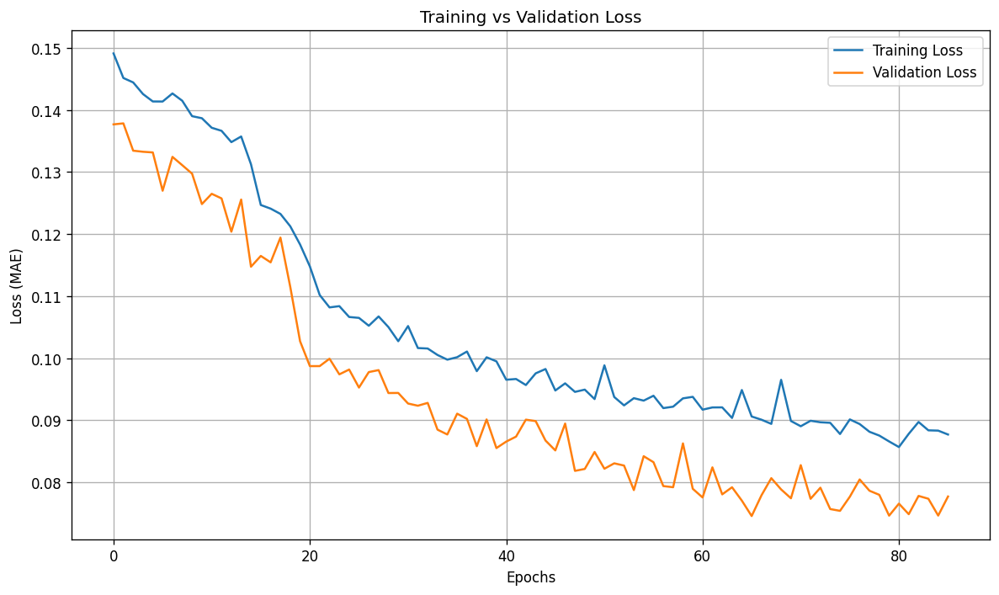

In [38]:
import numpy as np
import tensorflow as tf
import keras_tuner as kt
import os
import logging
from datetime import datetime
from typing import Tuple, Dict, Any

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.models import Model
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam, AdamW
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

# Setup logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)

class LSTMBayesianOptimization:
    def __init__(
        self,
        sequence_length: int = 24,
        max_trials: int = 15,
        executions_per_trial: int = 3,
        project_dir: str = "lstm_tuning"
    ):
        self.sequence_length = sequence_length
        self.max_trials = max_trials
        self.executions_per_trial = executions_per_trial
        self.project_dir = project_dir
        self.timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")

        # Create necessary directories
        self.model_dir = os.path.join("models", self.timestamp)
        os.makedirs(self.model_dir, exist_ok=True)

    def build_model(self, hp: kt.HyperParameters) -> Model:
        """Build LSTM model with hyperparameters."""
        try:
            inputs = Input(shape=(self.sequence_length, 1))

            # First LSTM Layer
            lstm_out1 = LSTM(
                units=hp.Int('units_1', min_value=64, max_value=512, step=64),
                return_sequences=True,
                kernel_regularizer=tf.keras.regularizers.l2(hp.Float('l2_reg', 1e-6, 1e-2, sampling='log'))
            )(inputs)
            dropout1 = Dropout(hp.Float('dropout_1', 0.2, 0.6, step=0.1))(lstm_out1)

            # Second LSTM Layer
            lstm_out2 = LSTM(
                units=hp.Int('units_2', min_value=64, max_value=256, step=64),
                return_sequences=False,
                kernel_regularizer=tf.keras.regularizers.l2(hp.Float('l2_reg_2', 1e-6, 1e-2, sampling='log'))
            )(dropout1)
            dropout2 = Dropout(hp.Float('dropout_2', 0.2, 0.6, step=0.1))(lstm_out2)

            # Output Layer
            output = Dense(1)(dropout2)

            model = Model(inputs, output)

            # Optimizer selection
            optimizer_choice = hp.Choice('optimizer', values=['adam', 'adamw'])
            learning_rate = hp.Float('learning_rate', 1e-4, 1e-2, sampling='log')

            optimizer = Adam(learning_rate=learning_rate) if optimizer_choice == 'adam' else \
                       AdamW(learning_rate=learning_rate, weight_decay=hp.Float('weight_decay', 1e-6, 1e-3, sampling='log'))

            model.compile(optimizer=optimizer, loss='mae', metrics=['mse'])

            return model

        except Exception as e:
            logger.error(f"Error in building model: {str(e)}")
            raise

    def create_callbacks(self) -> list:
        """Create training callbacks."""
        return [
            EarlyStopping(
                monitor='val_loss',
                patience=20,
                restore_best_weights=True,
                verbose=1
            ),
            ModelCheckpoint(
                filepath=os.path.join(self.model_dir, 'best_model.h5'),
                monitor='val_loss',
                save_best_only=True,
                verbose=1
            ),
            ReduceLROnPlateau(
                monitor='val_loss',
                factor=0.5,
                patience=10,
                min_lr=1e-6,
                verbose=1
            )
        ]

    def train(self, X_train: np.ndarray, y_train: np.ndarray,
              X_test: np.ndarray, y_test: np.ndarray) -> Tuple[Model, Dict[str, Any]]:
        """Train the model using Bayesian optimization."""
        try:
            # Initialize tuner
            tuner = kt.BayesianOptimization(
                self.build_model,
                objective='val_loss',
                max_trials=self.max_trials,
                executions_per_trial=self.executions_per_trial,
                directory=self.project_dir,
                project_name=f'bayesian_lstm_{self.timestamp}'
            )

            # Search for best hyperparameters
            tuner.search(
                X_train, y_train,
                epochs=200,
                validation_data=(X_test, y_test),
                batch_size=64,
                callbacks=self.create_callbacks()
            )

            # Get best model and retrain to get training history
            best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]
            best_model = self.build_model(best_hp)

            history = best_model.fit(
                X_train, y_train,
                epochs=200,
                validation_data=(X_test, y_test),
                batch_size=64,
                callbacks=self.create_callbacks(),
                verbose=1
            )

            # Evaluate model
            y_pred = best_model.predict(X_test)
            metrics = self.calculate_metrics(y_test, y_pred)

            self.log_results(best_hp, metrics)

            return best_model, metrics, best_hp, history

        except Exception as e:
            logger.error(f"Error in training: {str(e)}")
            raise

    @staticmethod
    def calculate_metrics(y_true: np.ndarray, y_pred: np.ndarray) -> Dict[str, float]:
        """Calculate evaluation metrics."""
        return {
            'mae': mean_absolute_error(y_true, y_pred),
            'mse': mean_squared_error(y_true, y_pred),
            'rmse': np.sqrt(mean_squared_error(y_true, y_pred)),
            'r2': r2_score(y_true, y_pred)
        }

    def log_results(self, best_hp: kt.HyperParameters, metrics: Dict[str, float]) -> None:
        """Log the results."""
        logger.info("\nBest Hyperparameters Found:")
        for key, value in best_hp.values.items():
            logger.info(f" {key}: {value}")

        logger.info("\nModel Evaluation Metrics:")
        for metric_name, value in metrics.items():
            logger.info(f" {metric_name.upper()}: {value:.4f}")

# Usage Example
if __name__ == "__main__":
    try:
        optimizer = LSTMBayesianOptimization()
        best_model, metrics, best_hp, history = optimizer.train(X_train, y_train, X_test, y_test)

        best_model.save(os.path.join(optimizer.model_dir, 'final_model.h5'))
        logger.info(f"Model saved successfully in {optimizer.model_dir}")

        # Print best hyperparameters
        print("\nBest Hyperparameters Found:")
        for key, value in best_hp.values.items():
            print(f"{key}: {value}")

        # Print evaluation metrics
        print("\nModel Evaluation Metrics:")
        for metric_name, value in metrics.items():
            print(f"{metric_name.upper()}: {value:.4f}")

        # Plot training and validation loss
        plt.figure(figsize=(10, 6))
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        plt.title('Training vs Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss (MAE)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        logger.error(f"Training failed: {str(e)}")

In [1]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

data5 = {'Model Name': ['model5_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.69],
        'Remarks': ["Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01"]}

data6 = {'Model Name': ['model6_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.70],
        'Remarks': ["Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005"]}

data7 = {'Model Name': ['model7_lstm_gridsearch'],
        'MAE': [0.0680],
        'MSE': [0.0203],
        'RMSE': [0.1426],
        'R2 Score': [0.6270],
        'Remarks': ["With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005"]}

data8 = {'Model Name': ['model8_lstm_bayesian'],
        'MAE': [0.0735],
        'MSE': [0.0190],
        'RMSE': [0.1378],
        'R2 Score': [0.6516],
        'Remarks': ["With L2 Regularization. Units_1:512; L2_Regularization1:1.005497368466447e-0; Dropout_1:0.3; Units_2:128; L2_Regularization2:2.1606777573118924e-06; Dropout_2:0.2; Optimizer:adam'; Learning_Rate:0.00037359938308603773"]}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)
df5 = pd.DataFrame(data5)
df6 = pd.DataFrame(data6)
df7 = pd.DataFrame(data7)
df8 = pd.DataFrame(data8)

df = pd.concat([df1, df2, df3, df4, df5, df6, df7, df8], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.9300,5.465632e+07,7392.9900,0.6500,"12 sequential length, predict next 6 months"
model2_lstm,4315.6100,5.443632e+07,7378.1000,0.6500,"12 sequential length, predict next 12 months"
model3_lstm,4044.4700,4.410496e+07,6641.1600,0.7100,"24 sequential length, predict next 12 months"
model4_lstm,3934.8900,4.196895e+07,6478.3500,0.7300,"36 sequential length, predict next 12 months"
model5_lstm_gridsearch,0.0700,2.000000e-02,0.1300,0.6900,Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01
model6_lstm_gridsearch,0.0700,2.000000e-02,0.1300,0.7000,Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005
model7_lstm_gridsearch,0.0680,2.030000e-02,0.1426,0.6270,With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005
model8_lstm_bayesian,0.0735,1.900000e-02,0.1378,0.6516,With L2 Regularization. Units_1:512; L2_Regularization1:1.005497368466447e-0; Dropout_1:0.3; Units_2:128; L2_Regularization2:2.1606777573118924e-06; Dropout_2:0.2; Optimizer:adam'; Learning_Rate:0.00037359938308603773


## **model9_lstm_bayesian**

In [32]:
import os
import shutil

# Remove the previous tuning directory to force a fresh search
if os.path.exists("lstm_tuning"):
    shutil.rmtree("lstm_tuning")

In [33]:
# Load dataset (Ensure df_sample is pre-loaded and formatted correctly)
df_sample = df_production.dropna()  # Drop missing values for better model training

# Scaling function for multiple locations
scalers = {}
df_scaled = df_sample.copy()
for location in df_sample['Location'].unique():
    scaler = MinMaxScaler()
    df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'] = scaler.fit_transform(
        df_scaled.loc[df_scaled['Location'] == location, 'total_production_mt'].values.reshape(-1, 1)
    )
    scalers[location] = scaler  # Store the scaler for inverse transformation

# Prepare sequences for LSTM
sequence_length = 24
X, y = [], []
location_labels = []

for location in df_sample['Location'].unique():
    data = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values
    for i in range(len(data) - sequence_length):
        X.append(data[i:i + sequence_length])
        y.append(data[i + sequence_length])
        location_labels.append(location)

X, y = np.array(X), np.array(y)

# Split data into training and testing sets
split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]
location_test = location_labels[split:]  # Locations for test set

# Reshape X_train and X_test to ensure compatibility with LSTM
X_train = np.reshape(X_train, (X_train.shape[0], sequence_length, 1))
X_test = np.reshape(X_test, (X_test.shape[0], sequence_length, 1))

print("X_train shape:", X_train.shape)  # Should be (samples, 24, 1)
print("X_test shape:", X_test.shape)    # Should be (samples, 24, 1)

X_train shape: (2124, 24, 1)
X_test shape: (532, 24, 1)


In [34]:
# model9_lstm_bayesian
import numpy as np
import tensorflow as tf
import keras_tuner as kt
import os

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.models import Model
from tensorflow.keras.layers import LSTM, Dense, Dropout, Input, Multiply
from tensorflow.keras.optimizers import Adam, AdamW

# Ensure models directory exists
os.makedirs("models", exist_ok=True)

# Define lookback window size
sequence_length = 24

# Attention Mechanism Layer
class Attention(tf.keras.layers.Layer):
    def __init__(self):
        super(Attention, self).__init__()

    def build(self, input_shape):
        self.W = self.add_weight(shape=(input_shape[-1], input_shape[-1]), initializer="random_normal", trainable=True)
        self.b = self.add_weight(shape=(input_shape[-1],), initializer="zeros", trainable=True)

    def call(self, inputs):
        score = tf.nn.tanh(tf.linalg.matmul(inputs, self.W) + self.b)
        attention_weights = tf.nn.softmax(score, axis=1)
        return inputs * attention_weights

# Define Function to Create the LSTM Model with Bayesian Optimization
def build_model(hp):
    inputs = Input(shape=(sequence_length, 1))

    # First LSTM Layer
    lstm_out1 = LSTM(units=hp.Int('units', min_value=64, max_value=512, step=64), return_sequences=True)(inputs)
    dropout1 = Dropout(hp.Float('dropout', 0.2, 0.6, step=0.1))(lstm_out1)

    # Attention Mechanism
    attention_output = Attention()(dropout1)

    # Second LSTM Layer
    lstm_out2 = LSTM(units=hp.Int('units_2', min_value=64, max_value=256, step=64), return_sequences=False)(attention_output)
    dropout2 = Dropout(hp.Float('dropout_2', 0.2, 0.6, step=0.1))(lstm_out2)

    # Fully Connected Output Layer
    output = Dense(1)(dropout2)

    model = Model(inputs, output)

    # Choose optimizer dynamically
    optimizer_choice = hp.Choice('optimizer', values=['adam', 'adamw'])
    learning_rate = hp.Choice('learning_rate', values=[0.0001, 0.0005, 0.001, 0.005])

    if optimizer_choice == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    else:
        optimizer = AdamW(learning_rate=learning_rate, weight_decay=1e-4)

    model.compile(optimizer=optimizer, loss='mae')

    return model

# Apply Bayesian Optimization Hyperparameter Tuning
tuner = kt.BayesianOptimization(
    build_model,
    objective='val_loss',
    max_trials=15,  # Defines search space efficiency
    executions_per_trial=3,  # Stability across multiple runs
    directory='lstm_tuning',
    project_name='bayesian_lstm_attention'
)

# Run Bayesian Hyperparameter Tuning
tuner.search(X_train, y_train, epochs=100, validation_data=(X_test, y_test), batch_size=64)

# Get the Best Hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print Best Hyperparameter Values
print("\n Best Hyperparameters Found:")
for key in best_hyperparameters.values.keys():
    print(f" {key}: {best_hyperparameters.get(key)}")

# Get the Best Model from Tuning
best_model = tuner.get_best_models(num_models=1)[0]

# Evaluate the Best Model
y_pred = best_model.predict(X_test)

# Compute Evaluation Metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print Results
print("\n Model Evaluation Metrics:")
print(f" MAE: {mae:.4f}")
print(f" MSE: {mse:.4f}")
print(f" RMSE: {rmse:.4f}")
print(f" R2 Score: {r2:.4f}")

Trial 15 Complete [00h 12m 25s]
val_loss: 0.10988783588012059

Best val_loss So Far: 0.07088597118854523
Total elapsed time: 05h 00m 52s

 Best Hyperparameters Found:
 units: 64
 dropout: 0.30000000000000004
 units_2: 192
 dropout_2: 0.4
 optimizer: adam
 learning_rate: 0.005


/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 22 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step

 Model Evaluation Metrics:
 MAE: 0.0690
 MSE: 0.0184
 RMSE: 0.1357
 R2 Score: 0.6619


In [37]:
# Print this in a table name

import pandas as pd
from IPython.display import HTML

data1 = {'Model Name': ['model1_lstm'],
        'MAE': [4293.93],
        'MSE': [54656318.97],
        'RMSE': [7392.99],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 6 months']}

data2 = {'Model Name': ['model2_lstm'],
        'MAE': [4315.61],
        'MSE': [54436321.48],
        'RMSE': [7378.10],
        'R2 Score': [0.65],
        'Remarks': ['12 sequential length, predict next 12 months']}

data3 = {'Model Name': ['model3_lstm'],
        'MAE': [4044.47],
        'MSE': [44104961.27],
        'RMSE': [6641.16],
        'R2 Score': [0.71],
        'Remarks': ['24 sequential length, predict next 12 months']}

data4 = {'Model Name': ['model4_lstm'],
        'MAE': [3934.89],
        'MSE': [41968954.69],
        'RMSE': [6478.35],
        'R2 Score': [0.73],
        'Remarks': ['36 sequential length, predict next 12 months']}

data5 = {'Model Name': ['model5_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.69],
        'Remarks': ["Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01"]}

data6 = {'Model Name': ['model6_lstm_gridsearch'],
        'MAE': [0.07],
        'MSE': [0.02],
        'RMSE': [0.13],
        'R2 Score': [0.70],
        'Remarks': ["Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005"]}

data7 = {'Model Name': ['model7_lstm_gridsearch'],
        'MAE': [0.0680],
        'MSE': [0.0203],
        'RMSE': [0.1426],
        'R2 Score': [0.6270],
        'Remarks': ["With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005"]}

data8 = {'Model Name': ['model8_lstm_bayesian'],
        'MAE': [0.0735],
        'MSE': [0.0190],
        'RMSE': [0.1378],
        'R2 Score': [0.6516],
        'Remarks': ["With L2 Regularization. Units_1:512; L2_Regularization1:1.005497368466447e-0; Dropout_1:0.3; Units_2:128; L2_Regularization2:2.1606777573118924e-06; Dropout_2:0.2; Optimizer:adam'; Learning_Rate:0.00037359938308603773"]}

data9 = {'Model Name': ['model9_lstm_bayesian'],
        'MAE': [0.0690],
        'MSE': [0.0148],
        'RMSE': [0.1357],
        'R2 Score': [0.6619],
        'Remarks': ["Units_1:64; Dropout_1:0.3; Units_2:192; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005"]}

df1 = pd.DataFrame(data1)
df2 = pd.DataFrame(data2)
df3 = pd.DataFrame(data3)
df4 = pd.DataFrame(data4)
df5 = pd.DataFrame(data5)
df6 = pd.DataFrame(data6)
df7 = pd.DataFrame(data7)
df8 = pd.DataFrame(data8)
df9 = pd.DataFrame(data9)

df = pd.concat([df1, df2, df3, df4, df5, df6, df7, df8, df9], ignore_index=True)

display(HTML(df.to_html(index=False)))

Model Name,MAE,MSE,RMSE,R2 Score,Remarks
model1_lstm,4293.9300,5.465632e+07,7392.9900,0.6500,"12 sequential length, predict next 6 months"
model2_lstm,4315.6100,5.443632e+07,7378.1000,0.6500,"12 sequential length, predict next 12 months"
model3_lstm,4044.4700,4.410496e+07,6641.1600,0.7100,"24 sequential length, predict next 12 months"
model4_lstm,3934.8900,4.196895e+07,6478.3500,0.7300,"36 sequential length, predict next 12 months"
model5_lstm_gridsearch,0.0700,2.000000e-02,0.1300,0.6900,Units_1:32; Dropout_1:0.1; Units_2:32; Dropout_2; Optimizer:adamw'; Learning_Rate:0.01
model6_lstm_gridsearch,0.0700,2.000000e-02,0.1300,0.7000,Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005
model7_lstm_gridsearch,0.0680,2.030000e-02,0.1426,0.6270,With Attention Mechanism. Units_1:64; Dropout_1:0.2; Units_2:64; Dropout_2:0.3; Optimizer:adam'; Learning_Rate:0.005
model8_lstm_bayesian,0.0735,1.900000e-02,0.1378,0.6516,With L2 Regularization. Units_1:512; L2_Regularization1:1.005497368466447e-0; Dropout_1:0.3; Units_2:128; L2_Regularization2:2.1606777573118924e-06; Dropout_2:0.2; Optimizer:adam'; Learning_Rate:0.00037359938308603773
model9_lstm_bayesian,0.0690,1.480000e-02,0.1357,0.6619,Units_1:64; Dropout_1:0.3; Units_2:192; Dropout_2:0.4; Optimizer:adam'; Learning_Rate:0.005


In [ ]:
# Forecast Next 12 Months for Each Location
future_predictions = {}

for location in df_sample['Location'].unique():
    input_sequence = df_scaled[df_scaled['Location'] == location]['total_production_mt'].values[-sequence_length:].reshape(1, sequence_length, 1)
    predictions = []

    for _ in range(12):
        predicted_value = best_model.predict(input_sequence)  # Use best_model instead of model7_lstm_gridsearch
        predictions.append(predicted_value[0][0])
        input_sequence = np.roll(input_sequence, -1, axis=1)
        input_sequence[0, -1, 0] = predicted_value[0][0]

    future_predictions[location] = scalers[location].inverse_transform(np.array(predictions).reshape(-1, 1))

In [ ]:
# Print Predictions
for location, preds in future_predictions.items():
    print(f"\nPredicted Rice Production for {location}:")
    for i, pred in enumerate(preds):
        print(f"Month {i+1}: {pred[0]:.2f} MT")

In [ ]:
# Generate separate plots per location
for location in df_sample['Location'].unique():
    plt.figure(figsize=(10, 5))

    # Historical data plot
    historical_data = df_sample[df_sample['Location'] == location]
    plt.plot(historical_data['Date'], historical_data['total_production_mt'], label="Actual", marker='o')

    # Future predictions plot with corrected frequency 'MS' (Month Start) or 'M' (Month End)
    future_dates = pd.date_range(start=historical_data['Date'].max(), periods=13, freq='MS')[1:]
    plt.plot(future_dates, future_predictions[location], '--', label="Predicted", marker='s', color='red')

    # Graph settings
    # plt.xlabel("Date")
    plt.ylabel("Total Production (MT)")
    plt.title(f"Rice Production Forecast - {location}")
    plt.legend()
    plt.grid(True)

    # Show each plot separately
    plt.show()